# ***Neural network for Time Series*** 

Oltre ai modelli lineari analizzati in precedenza, anche delle tecniche di machine learning vengono utilizzate per prevedere dati futuri di serie storiche. In particolare, esistono diversi metodi ma in questo notebook verranno sperimentate le reti neurali. 
Diversi blocchi LSTM e GRU verranno utilizzati per progettare tali reti attraverso la tecnologia cuDNN che permette di velocizzare l'apprendimento. 

In fase di preprocessing, sia la normalizzazione sia la standardizzazione sono state implementate e la prima strategia funzione decisamente meglio perché diminuisce l'errore in training e validation della maggior parte dei modelli. 

L'obiettivo è quello di definire una funzione che preveda, a partire da una finestra di dati, i due mesi successivi.  
Prima di procedere con tale obiettivo, diverse prove sono state fatte per capire il comportamento di queste reti quando si vuole definire funzioni più semplici: prevedere un'ora, un giorno o una settimana in avanti. Questa prima fase ha evidenziato il fatto di non utilizzare la relu come funzione di attivazione delle LSTM perché porta a dei valori di loss esageratamente grandi che risultano essere discontinui rispetto a tutta la storia di apprendimento. Per risolvere questo problema, la funzione di attivazione tangente iperbolica di default è stata scelta. 
Si osserva che prevedendo un'ora in avanti, le reti funzionano molto bene in fase di validation riuscendo a catturare sia il pattern giornaliero, sia quello settimanale ed annuale. Questa struttura è più semplice da visualizzare perché non ho delle finestre in output. 

Successivamente, la funzione target è stata definita attraverso diverse architetture e diverse finestre di input. L'unico iperparametro fisso è la dimensione della finestra di output. L'approccio è stato lo stesso sia con le reti LSTM sia con quelle GRU: fisso la dimensione della finestra di input, definisco una rete con un solo blocco LSTM o GRU con un numero definito di neuroni di output ed il livello di output ed infine, aumento in modo crescente la complessità della rete. 
Si osserva che il learning rate è un iperparametro molto influente nelle previsioni: è necessario ricercare il valore ottimale. 

Per quanto riguarda i modelli LSTM, poiché si vuole prevedere due mesi in avanti, la finestra di input scelta per iniziare è stata proprio di due mesi. Si osserva che, in generale, solo il pattern giornaliero viene catturato e, in particolare nei modelli più semplici, non si osserva i due massimi locali tipici di questa stagonalità. Modelli con un blocco LSTM e 512 neuroni di output da tale blocco non sono possibili a causa della limitazione della RAM. Dato che la funzione da apprendere è abbastanza complessa, modelli con più neuroni sarebbero più opportuni per avere previsioni migliori. Tuttavia, a causa di limitazioni di tipo computazionali, cercheremo altre configurazioni. 
Inoltre, aumentare troppo la batch_size dà lo stesso problema. 

## ***SETTING THE ENVIRONMENT***

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# serve per vedere la funzione di loss e validation in real-time. 
!pip install livelossplot

In [ ]:
import pandas as pd
from numpy import array

import matplotlib.pyplot as plt
plt.style.use('ggplot')

from keras.models import Sequential
from keras.layers import LSTM, GRU
from keras.layers import Dense
from keras.layers import Dropout
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import TensorBoard 
from keras.callbacks import LearningRateScheduler
from keras.backend import clear_session
from livelossplot import PlotLossesKeras
import tensorflow as tf
from datetime import datetime
from sklearn.metrics import mean_absolute_error as mae
from tqdm import tqdm

In [ ]:
# definisco il seed dei generatori. 
seed_value= 18082021

import os
os.environ['PYTHONHASHSEED']=str(seed_value)

import random
random.seed(seed_value)

# 3. Set the `numpy` pseudo-random generator at a fixed value
import numpy as np
np.random.seed(seed_value)

# 4. Set the `tensorflow` pseudo-random generator at a fixed value
import tensorflow as tf
tf.random.set_seed(seed_value)

In [ ]:
# import la tecnologia cuDNN per velocizzare l'apprendimento. 
from tensorflow.compat.v1.keras.layers import CuDNNLSTM
from tensorflow.compat.v1.keras.layers import CuDNNGRU
tf.config.list_physical_devices('GPU')

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [ ]:
%load_ext tensorboard

## ***IMPORT DATA***

In [ ]:
# Dataset di train: 80% del totale.
train = pd.read_csv('drive/MyDrive/TimeSeries/Train.csv')
train.head()

,Value,Timestamp
0,3646742,2018-09-01 01:00:00
1,3273110,2018-09-01 02:00:00
2,3069245,2018-09-01 03:00:00
3,2969621,2018-09-01 04:00:00
4,2944116,2018-09-01 05:00:00


In [ ]:
train.tail()

,Value,Timestamp
13890,4314040,2020-04-01 19:00:00
13891,4798962,2020-04-01 20:00:00
13892,4912895,2020-04-01 21:00:00
13893,4495300,2020-04-01 22:00:00
13894,3885602,2020-04-01 23:00:00


In [ ]:
# Dataset di val: 20% del totale.
val = pd.read_csv('drive/MyDrive/TimeSeries/Val.csv')
val.head()

,Value,Timestamp
0,3316399,2020-04-02 00:00:00
1,2816056,2020-04-02 01:00:00
2,2479631,2020-04-02 02:00:00
3,2302937,2020-04-02 03:00:00
4,2234052,2020-04-02 04:00:00


In [ ]:
val.tail()

,Value,Timestamp
3620,4284919,2020-08-31 20:00:00
3621,4400006,2020-08-31 21:00:00
3622,3965396,2020-08-31 22:00:00
3623,3442262,2020-08-31 23:00:00
3624,2932544,2020-09-01 00:00:00


In [ ]:
train.shape

(13895, 2)

In [ ]:
val.shape

(3625, 2)

In [ ]:
train.shape[0] + val.shape[0]

17520

## ***DATA PREPARATION: SCALING***

In [ ]:
# aggrego tutti i dati per normalizzare e poi divido: in questo modo
# sono sicura che i dati si troveranno nel range [0,1]. 
data = pd.concat([train, val], axis = 0, ignore_index=True)

# funziona molto meglio così perché la stabdardizzazione
# fa si che alcuni valori siano tra circa 4 e probabilmente questo aspetto
# influenza la rete. 
scaler = MinMaxScaler()
data['StandardValue'] = scaler.fit_transform(data.Value.values.reshape(-1,1))

train = data.iloc[0:train.shape[0],:]
val = data.iloc[train.shape[0]:data.shape[0],:]

In [ ]:
train.StandardValue.describe()

count    13895.000000
mean         0.361907
std          0.171025
min          0.032088
25%          0.214169
50%          0.365628
75%          0.484987
max          1.000000
Name: StandardValue, dtype: float64

In [ ]:
val.StandardValue.describe()

count    3625.000000
mean        0.226872
std         0.130101
min         0.000000
25%         0.126889
50%         0.211038
75%         0.320752
max         0.705430
Name: StandardValue, dtype: float64

In [ ]:
def split_sequence(sequence, n_steps_in, n_steps_out):
  """
  Data una sequenza, a partire dall'indice iniziale, si definiscono delle finestre di una certa dimensione di input e 
  e la successiva con una dimensione fissa. Questa coppia di finestre di dimensioni (n_in, n_out) esiste fino a quando
  n_in + n_out è maggiore della lunghezza della sequenza. Tutto questo serve per creare un contesto supervised
  per l'addestramento delle reti dove il dato da prevedere è il valore nel futuro. La dimensione della finestra di output
  dipende dalla funzione che si vuole costruire, mentre la dimensione della finestra di input può essere scelta in modo
  da minimizzare l'errore.  

  Input
  ------
  sequence: numpy.array
    Sono i dati che vorrei definire come coppie di finestre di input e output, ovvero quelle di input ma con un lag. 
  n_steps_in: intero.
    Dimensione della finestra di input.
  n_steps_out: intero.
    Dimensione della finestra di output.

  Output
  ------
  array(X): numpy.array
    Lista delle finestre di input.
  array(Y): numpy.array
    Lista delle finestre di output.
  """
  # queste liste memorizzeranno le finestre di input e output per tutta la lunghezza della sequenza. 
  X, y = list(), list()
  for i in range(len(sequence)):
    # fine della finestra di input.
    end_ix = i + n_steps_in
    # fine della finestra di output.
    out_end_ix = end_ix + n_steps_out
    # controllo di non sforare l'ultimo indice della sequenza.
    if out_end_ix > len(sequence):
      break
    # definisco le finestre. 
    seq_x, seq_y = sequence[i:end_ix], sequence[end_ix:out_end_ix]
    X.append(seq_x)
    y.append(seq_y)
  return array(X), array(y)

In [ ]:
def prepare_data(train, val, n_in, n_out, n_features = 1):
  """
  Una volta che la sequenza è stata splittata nelle diverse finestre di input e output, è necessario
  ridimensionare le finestre di input creando dei tensori [samples, steps, feature]:
    - samples: numero di finestre a disposizione.
    - steps: dimensione della finestra di input o lag tra il primo dato della finestra di input e il primo di quella di output.
    - feature = 1 se la serie è univariata, feature = k se la serie è multivariata con k features. 

    
  Input
  ------
  train: numpy.array
    Sequenza di dati utilizzati per l'addestramento.
  val: numpy.array 
    Sequenza di dati utilizzati per validare il risultato.
  n_in: intero.
    Dimensione della finestra di input.
  n_out: intero.
    Dimensione della finestra di output.
  n_features: intero.
    Valore di default = 1 per le serie univariate.
  
  Output
  ------
  trainX: numpy.array
    Dataset in input per l'addestramento della rete.
  trainY: numpy.array
    Dataset di output per l'addestramento della rete.
  valX: numpy.array
    Dataset in input per la validazione della rete.
  valY:numpy.array
    Dataset di output per l'addestramento della rete.
  """
  # a partire dagli array, definisco un set di coppie di finestre.
  trainX, trainY = split_sequence(train, n_in, n_out)
  valX, valY = split_sequence(val, n_in, n_out)
  print(f"trainX shape: {trainX.shape}")
  print(f"trainY shape: {trainY.shape}")
  print(f"valX shape: {valX.shape}")
  print(f"valY shape: {valY.shape}")
  # il set di coppri di finestre vengono trasformate in un tensore. 
  n_features = 1
  trainX = trainX.reshape((trainX.shape[0], trainX.shape[1], n_features))
  valX = valX.reshape((valX.shape[0], valX.shape[1], n_features))
  return trainX, trainY, valX, valY

In [ ]:
n_features = 1

## **MODELS**

In [ ]:
def fit_and_plot_model(model, 
                       trainX, trainY, 
                       valX, valY, 
                       MODEL_CODE, 
                       PATIENCE = 3, EPOCHS = 30, BATCH_SIZE = 256, 
                       PATH_TO_SAVE = 'drive/MyDrive/TimeSeries/', scaler = scaler):
  """
  Queste funzione addestra e valida una rete neurale con il fine di prevedere valori futuri di una serie storica. 

  Input
  ------
  model: keras.Model()
    Archietettura delle rete neurale.  
  trainX: numpy.array
    Dataset di training di input per l'addestramento della rete.
  trainY: numpy.array
    Dataset di training di output per l'addestramento della rete.
  valX: numpy.array
    Dataset di validazione di input.
  valY: numpy.array 
    Dataset di validazione di output.
  MODEL_CODE: intero.
    Codice per salvare i dati in un file csv. 
  PATIENCE: intero.
    Numero di passi prima che EarlyStopping termini la fase di addestramento. Valore di default: 3.
  EPOCHS: intero.
    Numero di epoche per l'addestramento della rete. Valore di default: 30.
  BATCH_SIZE: intero.
    Numero di samples da utilizzare per valutare il gradiente per BPTT. Valore di deault: 256.
  PATH_TO_SAVE: stringa. 
    Path del file dove salvare il modello. Default: 'drive/MyDrive/TimeSeries/' 
  scaler: sklearn.preprocessing.MinMaxScaler
    Funzione per ottenre i dati originali a partire da quelli scalati. 
  
  Output
  -------
  result: float.
    MAE ottenuto in validation.
  result_scaled: float.
    Dopo aver riscalato i dati e le previsioni, si calcola il MAE e si restituisce questo risultato. 
  """
  # evita che i modelli si parlino: resetta gli stati definiti da keras.
  clear_session()
  # definisco le callbacks.
  callback = [EarlyStopping(monitor = 'val_loss', 
                            patience = PATIENCE, 
                            restore_best_weights = True
                            ),
              PlotLossesKeras()
            # TensorBoard(log_dir=LOGDIR)
             ]
  # addestro e valido il modelli. 
  history = model.fit(trainX, trainY, 
                      epochs = EPOCHS,
                      batch_size = BATCH_SIZE, 
                      validation_data = (valX, valY), 
                      verbose = 1,
                      shuffle = False, # è una serie storica! L'ordine è fondamentale. 
                      callbacks=[callback]
                      )

  # save model.
  # model.save(PATH_TO_SAVE + 'model_' + str(MODEL_CODE))
  # compute MAE for the validation set. 
  print("\n\n ***** EVALUATION WITHOUT SCALING ***** \n\n")
  # training.
  result_train = model.evaluate(trainX, trainY)
  # validation.
  result_val = model.evaluate(valX, valY)
  
  print("\n\n ***** EVALUATION WITH SCALING ***** \n\n")
  appo_1 = scaler.inverse_transform(np.squeeze(trainX))
  appo_1 = appo_1.reshape(trainX.shape[0], trainX.shape[1], 1)
  appo_2 = scaler.inverse_transform(trainY)
  result_scaled_train = model.evaluate(appo_1, appo_2)

  appo_1 = scaler.inverse_transform(np.squeeze(valX))
  appo_1 = appo_1.reshape(valX.shape[0], valX.shape[1], 1)
  appo_2 = scaler.inverse_transform(valY)
  result_scaled_val = model.evaluate(appo_1, appo_2)
  
  return result_train, result_val, result_scaled_train, result_scaled_val


def plot_one_window(model, valX, n_in, n_out, k = 0, return_f = False):
  """
  Data una finestra di input e la successiva, questa funzione grafica quest'ultime
  più la previsione. 

  Input
  -----
  model: keras.Model() 
    Modello di keras già addestrato.
  valX: numpy.array.
    Dataset con le finestre in input per la validazione.
  n_in: intero.
    Dimensione della finestra di input.
  n_out: intero.
      Dimensione della finestra di input.
  k: intero. 
    Indice che identifica la finestra di input, e di conseguenza anche quella di output, da graficare.
  return_f: boolean.
    Se True, vengono restituite le previsioni con i dati non scalati. 
  """
  # prevedo tutti i dati in fase di validation.
  forecasted = model.predict(valX)

  plt.figure(figsize=(10,5))
  # questo array conterrà i dati di validazione che vorrei graficare. 
  basic_1 = np.repeat(np.nan, n_in+n_out)
  basic_1[0:n_in] = valX[k].reshape(-1)
  # se la finestra successiva a quella di input è disponibile, grafico anche questa. 
  if k+n_in < (valX.shape[0]-1):
    basic_1[n_in:(n_in+n_out)] = valX[k+n_in][0:n_out].reshape(-1)
  # questo array conterrà le previsioni che, se possibile, potrano sovrapporsi con la finestra di output. 
  basic_2 = np.repeat(np.nan, n_in+n_out)
  basic_2[n_in:(n_in+n_out)] = forecasted[k]
  # grafico i risultati. 
  plt.plot(basic_1, label = 'Data')
  plt.plot(basic_2, label = 'Previsione')
  plt.legend()
  plt.show();
  if return_f:
    return forecasted

def plot_test_predictions(model, val, n_in, n_out):
  """
  Grafico le previsioni per i dati che non ho a disposizione (per il rpogetto, saranno i due mesi successivi).

  Input
  -----
  model: keras.Model()
    Modello addestrato di keras.
  val: pandas.Dataframe
    Dataset con i valori per la validazione.
  n_n: intero.
    Dimensione finestra di input.
  n_out: intero.
    Dimensione finestra di output.
  """
  X_test = np.expand_dims(val.StandardValue.values[-n_in:].reshape(-1,1), axis = 0)
  yhat = model.predict(X_test)
  yhat = np.squeeze(yhat)

  days = 24*4

  fig, (ax1, ax2) = plt.subplots(nrows = 2, ncols = 1, figsize = (20, 5), sharey = True)
  ax1.plot(yhat[0:days], color = 'black')
  ax1.set_title('Previsione di ' + str(days) + ' ore')
  ax1.set_xlabel('Index (Time)')
  ax1.set_xlabel('Value')
  ax2.plot(yhat)
  ax2.set_title('Previsione di ' + str(n_out/24) + ' giorni')
  ax2.set_xlabel('Index (Time)')
  fig.subplots_adjust(hspace=0.5)
  ax2.set_xlabel('Value');

### ***PROVE***

#### ***1gg prima -> 1h dopo***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = 1

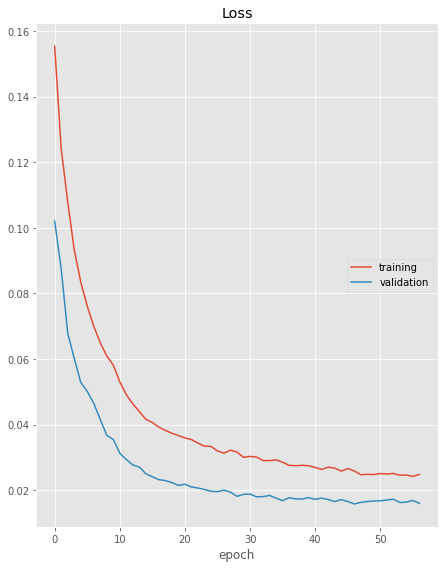

Loss
	training         	 (min:    0.024, max:    0.155, cur:    0.025)
	validation       	 (min:    0.016, max:    0.102, cur:    0.016)


 ***** EVALUATION WITHOUT SCALING ***** 


113/113 [==============================] - 0s 4ms/step - loss: 0.0158


 ***** EVALUATION WITH SCALING ***** 


113/113 [==============================] - 0s 4ms/step - loss: 3454678.0000


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
n_in, n_out = 24, 1
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(32, input_shape=(n_in, n_features)))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 10)

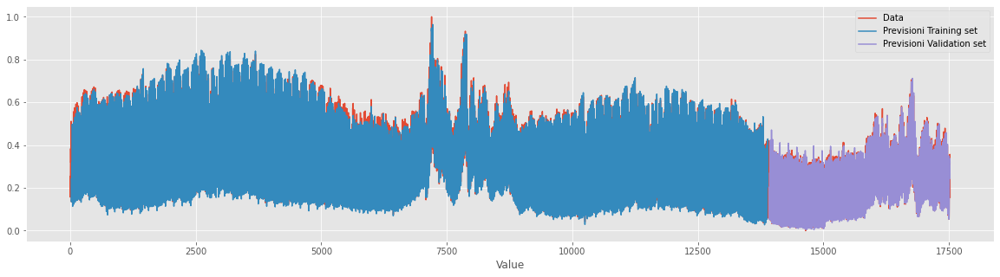

In [ ]:
trainPredict = model.predict(trainX)
valPredict = model.predict(valX)

trainPredictPlot = np.empty_like(data[['StandardValue']])
trainPredictPlot[:, :] = np.nan
trainPredictPlot[n_in:(len(trainPredict)+n_in), :] = trainPredict
trainPredictPlot

# shift test predictions for plotting
testPredictPlot = np.empty_like(data[['StandardValue']])
testPredictPlot[:, :] = np.nan
start = len(trainPredict)+(n_in*2)+1
end = len(data[['StandardValue']])-1
testPredictPlot[start:end, :] = valPredict[:(end-start)]

# funziona molto bene!
plt.style.use('ggplot')
plt.figure(figsize=(20,5))
plt.plot(data.StandardValue, label = 'Data')
plt.plot(trainPredictPlot, label = 'Previsioni Training set')
plt.plot(testPredictPlot, label = 'Previsioni Validation set')
plt.xlabel('Index (Time)')
plt.xlabel('Value')
plt.legend()
plt.show();

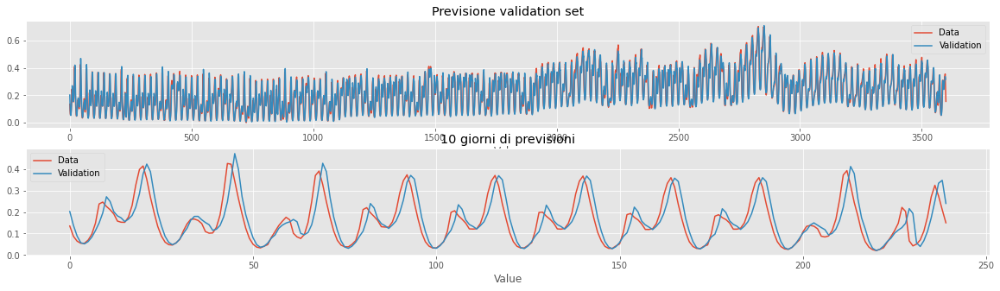

In [ ]:
# è interessante il fatto che prevedendo l'ora successiva a partire dalle 24 ore precedenti, 
# riesca comunque a captare l'andamento annuale!

end = start + 24*10
fig, (ax1, ax2) = plt.subplots(ncols = 1, nrows = 2, figsize=(20,5))
# in questo modo parto dalle previsioni del validation che hanno il rispettivo valore reale. 
ax1.plot(data.StandardValue[start:].reset_index()['StandardValue'], label = 'Data')
ax1.plot(testPredictPlot[start:data.shape[0]], label = 'Validation')
ax1.set_xlabel('Index (Time)')
ax1.set_xlabel('Value')
ax1.set_title('Previsione validation set')
ax1.legend()
ax2.plot(data.StandardValue[start:end].reset_index()['StandardValue'], label = 'Data')
ax2.plot(testPredictPlot[start:end], label = 'Validation')
ax2.set_title('10 giorni di previsioni')
ax2.set_xlabel('Index (Time)')
ax2.set_xlabel('Value')
ax2.legend()
plt.show();

#### ***1gg prima -> 1gg dopo***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = MODEL_CODE + 1

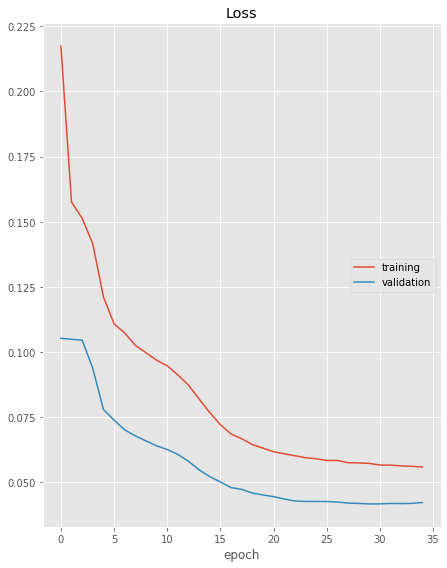

Loss
	training         	 (min:    0.056, max:    0.217, cur:    0.056)
	validation       	 (min:    0.042, max:    0.105, cur:    0.042)


 ***** EVALUATION WITHOUT SCALING ***** 


112/112 [==============================] - 0s 4ms/step - loss: 0.0417


 ***** EVALUATION WITH SCALING ***** 


112/112 [==============================] - 0s 4ms/step - loss: 3455610.2500


In [ ]:
clear_session()

print("\n\n ***** DATA PREPARATION ***** \n\n")
n_in, n_out = 24, 24
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(32, input_shape=(n_in, n_features)))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5)

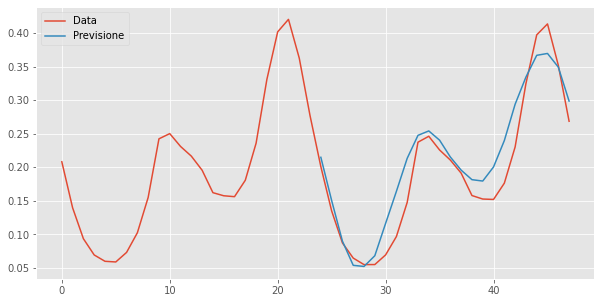

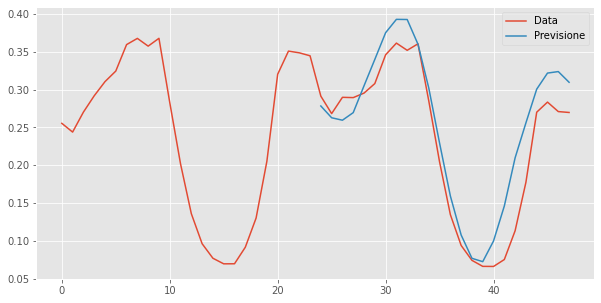

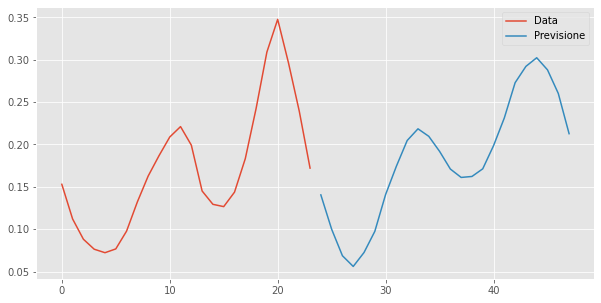

(None, None, None)

In [ ]:
plot_one_window(model, valX, n_in, n_out), plot_one_window(model, valX, n_in, n_out, k = int(valX.shape[0]/2)), plot_one_window(model, valX, n_in, n_out, k = valX.shape[0]-1)

#### ***3gg prima -> 1gg dopo***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = MODEL_CODE + 1

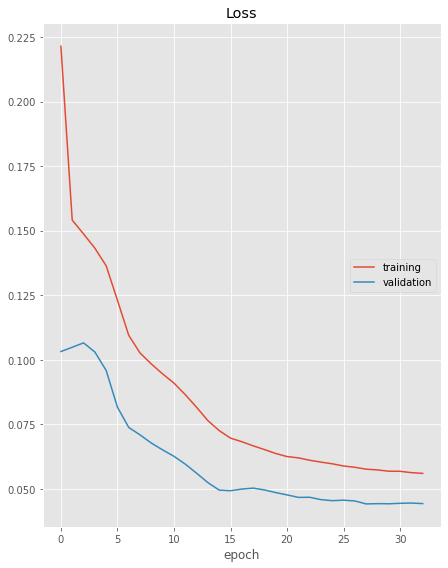

Loss
	training         	 (min:    0.056, max:    0.221, cur:    0.056)
	validation       	 (min:    0.044, max:    0.107, cur:    0.044)


 ***** EVALUATION WITHOUT SCALING ***** 


111/111 [==============================] - 1s 6ms/step - loss: 0.0441


 ***** EVALUATION WITH SCALING ***** 


111/111 [==============================] - 1s 6ms/step - loss: 3461317.5000


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
n_in, n_out = 24*3, 24
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(32, input_shape=(n_in, n_features)))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5)

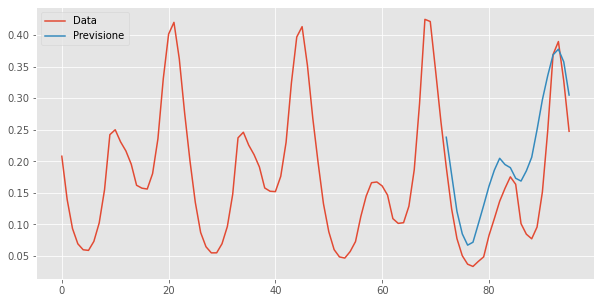

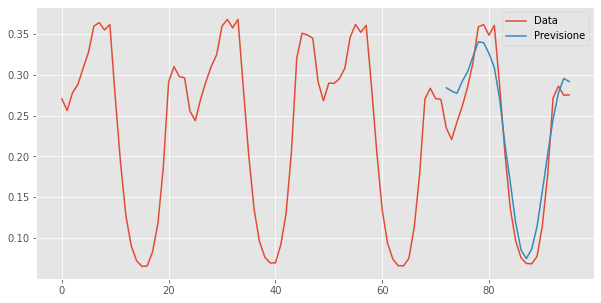

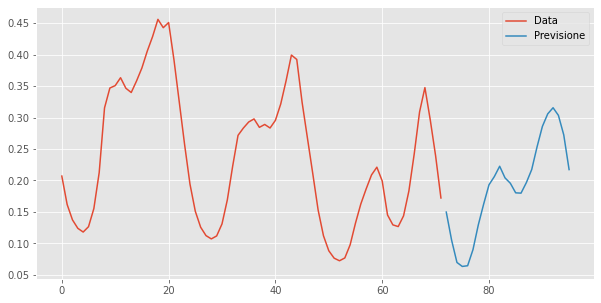

(None, None, None)

In [ ]:
plot_one_window(model, valX, n_in, n_out), plot_one_window(model, valX, n_in, n_out, k = int(valX.shape[0]/2)), plot_one_window(model, valX, n_in, n_out, k = valX.shape[0]-1)

#### ***1 settimana prima -> 1gg dopo***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = MODEL_CODE + 1

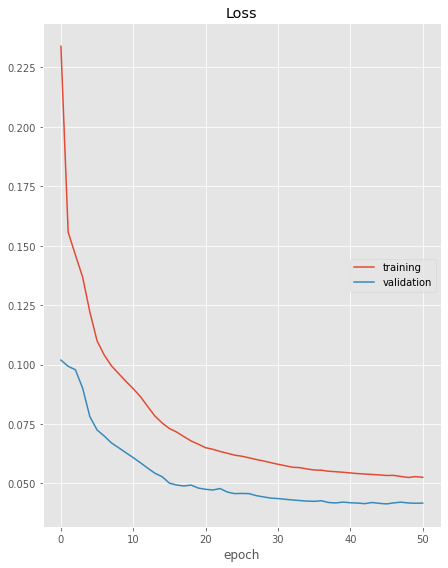

Loss
	training         	 (min:    0.053, max:    0.234, cur:    0.053)
	validation       	 (min:    0.041, max:    0.102, cur:    0.042)


 ***** EVALUATION WITHOUT SCALING ***** 


108/108 [==============================] - 1s 11ms/step - loss: 0.0414


 ***** EVALUATION WITH SCALING ***** 


108/108 [==============================] - 1s 11ms/step - loss: 3475429.2500


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
n_in, n_out = 24*7, 24

trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n") 
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(32, input_shape=(n_in, n_features)))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5)

# gradient clipping
# relu
# normalization

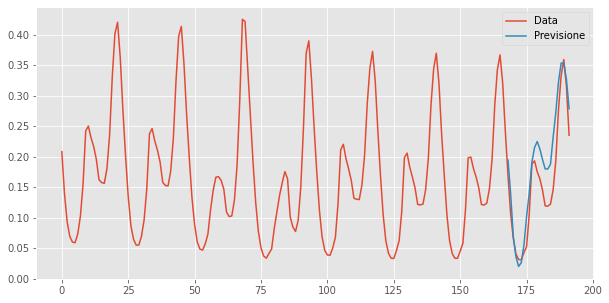

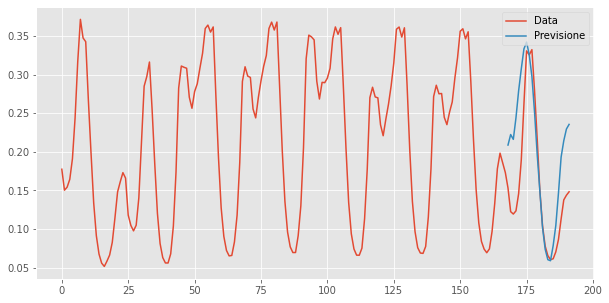

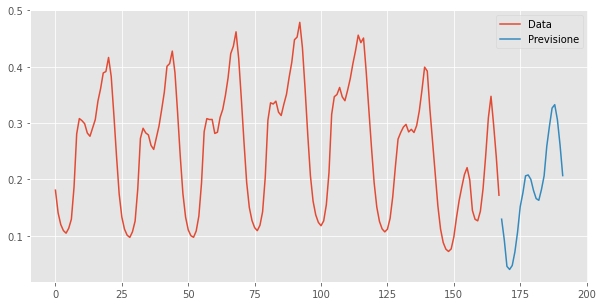

(None, None, None)

In [ ]:
plot_one_window(model, valX, n_in, n_out), plot_one_window(model, valX, n_in, n_out, k = int(valX.shape[0]/2)), plot_one_window(model, valX, n_in, n_out, k = valX.shape[0]-1)

In [ ]:
# in effetti, includendo sempre più dati, il risultato peggiora. 

#### ***pt.I: 1 settimana prima -> 1 settimana dopo (32 unità, no dropout)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = MODEL_CODE + 1

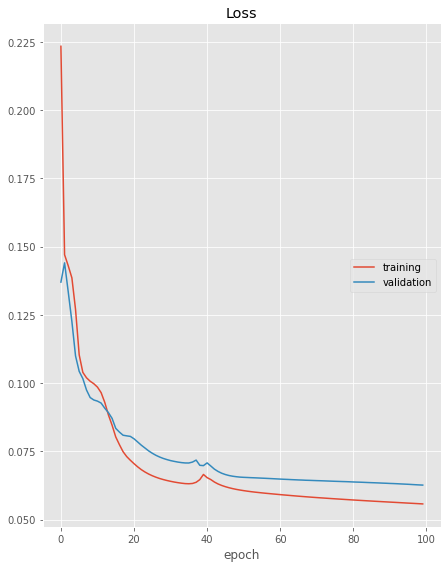

Loss
	training         	 (min:    0.056, max:    0.223, cur:    0.056)
	validation       	 (min:    0.063, max:    0.144, cur:    0.063)


 ***** EVALUATION WITHOUT SCALING ***** 


103/103 [==============================] - 1s 11ms/step - loss: 0.0626


 ***** EVALUATION WITH SCALING ***** 


103/103 [==============================] - 1s 11ms/step - loss: 3487786.2500


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
n_in, n_out = 24*7, 24*7

trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(32, input_shape=(n_in, n_features)))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 10)

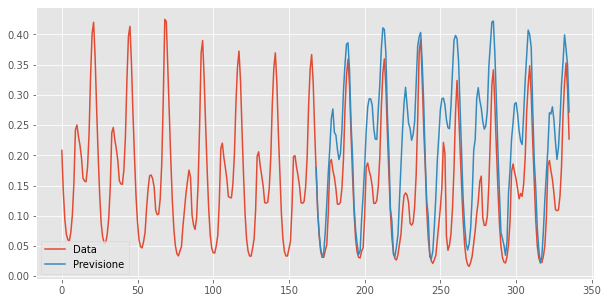

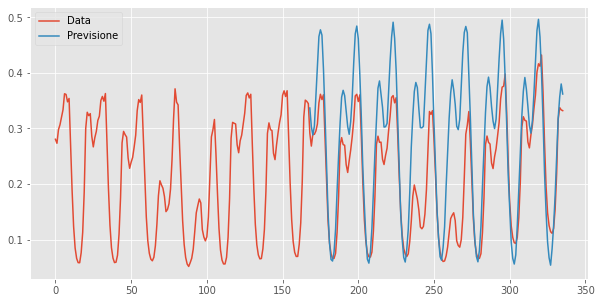

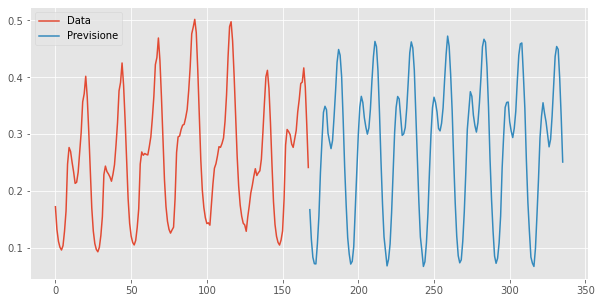

(None, None, None)

In [ ]:
plot_one_window(model, valX, n_in, n_out), plot_one_window(model, valX, n_in, n_out, k = int(valX.shape[0]/2)), plot_one_window(model, valX, n_in, n_out, k = valX.shape[0]-1)

#### ***pt.II: 1 settimana prima -> 1 settimana dopo (32 unità + dropout 0.2)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = MODEL_CODE + 1

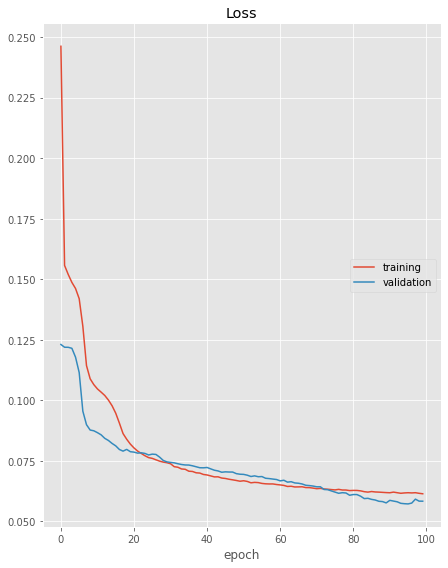

Loss
	training         	 (min:    0.061, max:    0.246, cur:    0.061)
	validation       	 (min:    0.057, max:    0.123, cur:    0.058)


 ***** EVALUATION WITHOUT SCALING ***** 


103/103 [==============================] - 1s 11ms/step - loss: 0.0584


 ***** EVALUATION WITH SCALING ***** 


103/103 [==============================] - 1s 11ms/step - loss: 3487786.2500


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
n_in, n_out = 24*7, 24*7

trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(32, input_shape=(n_in, n_features)))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5)

# gradient clipping
# relu
# normalization

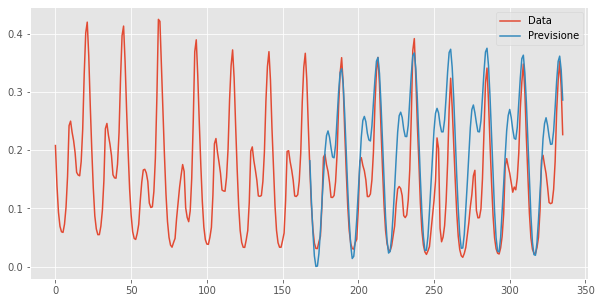

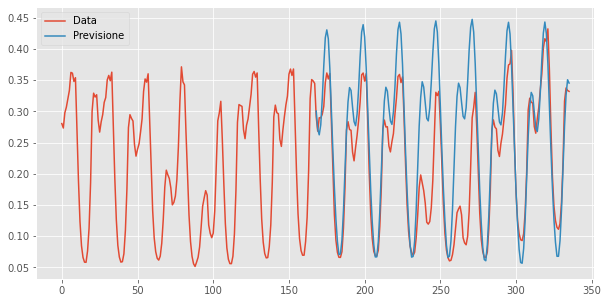

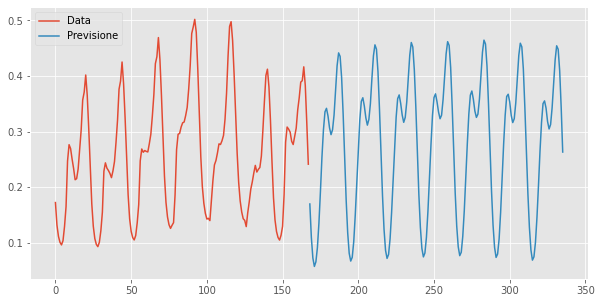

(None, None, None)

In [ ]:
plot_one_window(model, valX, n_in, n_out), plot_one_window(model, valX, n_in, n_out, k = int(valX.shape[0]/2)), plot_one_window(model, valX, n_in, n_out, k = valX.shape[0]-1)

#### ***pt.III: 1 settimana prima -> 1 settimana dopo (32 unità + dropout 0.6)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = MODEL_CODE + 1

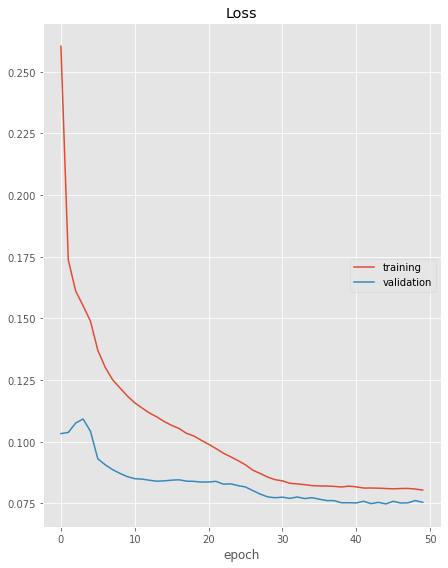

Loss
	training         	 (min:    0.080, max:    0.260, cur:    0.080)
	validation       	 (min:    0.075, max:    0.109, cur:    0.075)


 ***** EVALUATION WITHOUT SCALING ***** 


103/103 [==============================] - 1s 11ms/step - loss: 0.0748


 ***** EVALUATION WITH SCALING ***** 


103/103 [==============================] - 1s 11ms/step - loss: 3487786.7500


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
n_in, n_out = 24*7, 24*7

trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
del model 
# define the LSTM architecture.
model = Sequential()
model.add(LSTM(32, input_shape=(n_in, n_features)))
model.add(Dropout(0.6))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5)

# gradient clipping
# relu
# normalization

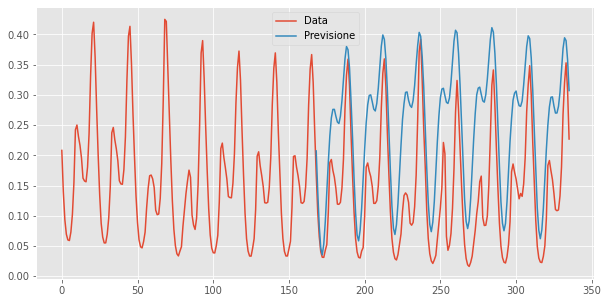

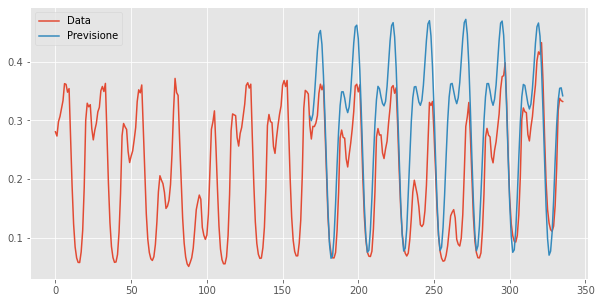

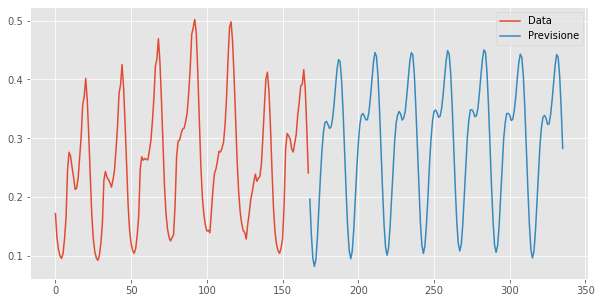

(None, None, None)

In [ ]:
plot_one_window(model, valX, n_in, n_out), plot_one_window(model, valX, n_in, n_out, k = int(valX.shape[0]/2)), plot_one_window(model, valX, n_in, n_out, k = valX.shape[0]-1)

#### ***pt.IV: 1 settimana prima -> 1 settimana dopo (128 unità, no dropout)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = MODEL_CODE + 1

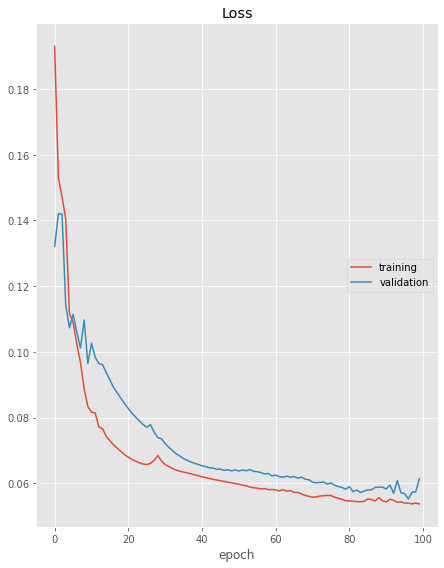

Loss
	training         	 (min:    0.054, max:    0.193, cur:    0.054)
	validation       	 (min:    0.055, max:    0.142, cur:    0.061)


 ***** EVALUATION WITHOUT SCALING ***** 


103/103 [==============================] - 1s 11ms/step - loss: 0.0614


 ***** EVALUATION WITH SCALING ***** 


103/103 [==============================] - 1s 11ms/step - loss: 3487785.5000


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
n_in, n_out = 24*7, 24*7

trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(128, input_shape=(n_in, n_features)))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 10)

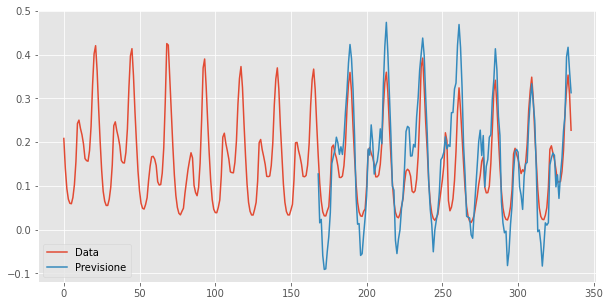

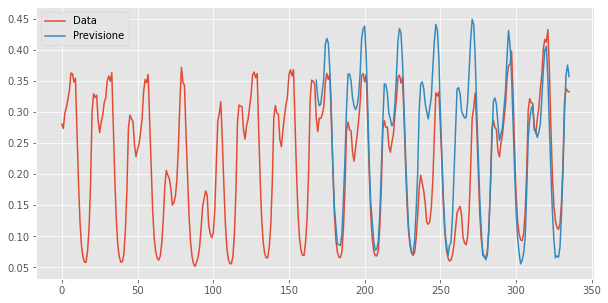

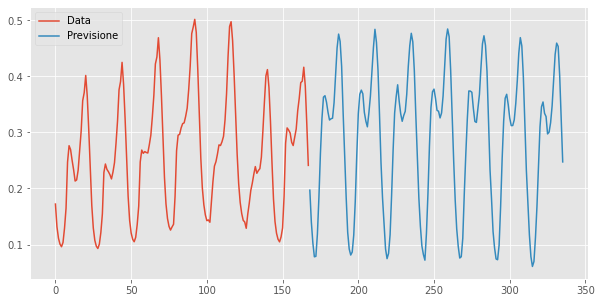

(None, None, None)

In [ ]:
plot_one_window(model, valX, n_in, n_out), plot_one_window(model, valX, n_in, n_out, k = int(valX.shape[0]/2)), plot_one_window(model, valX, n_in, n_out, k = valX.shape[0]-1)

#### ***pt.V: 1 settimana prima -> 1 settimana dopo (128 unità + dropout 0.2)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = MODEL_CODE + 1

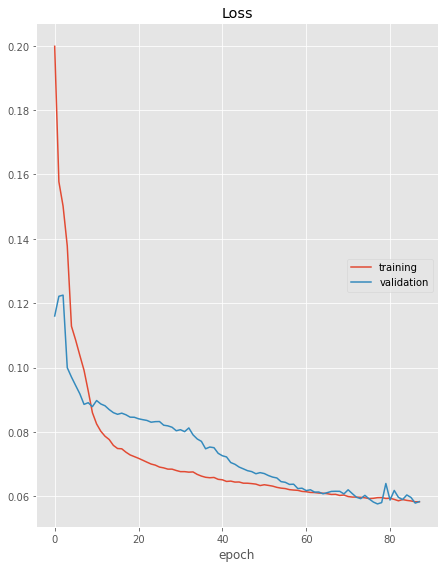

Loss
	training         	 (min:    0.058, max:    0.200, cur:    0.058)
	validation       	 (min:    0.058, max:    0.122, cur:    0.058)


 ***** EVALUATION WITHOUT SCALING ***** 


103/103 [==============================] - 1s 14ms/step - loss: 0.0576


 ***** EVALUATION WITH SCALING ***** 


103/103 [==============================] - 1s 14ms/step - loss: 3487785.7500


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
n_in, n_out = 24*7, 24*7

trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(128, input_shape=(n_in, n_features)))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 10)

# gradient clipping
# relu
# normalization

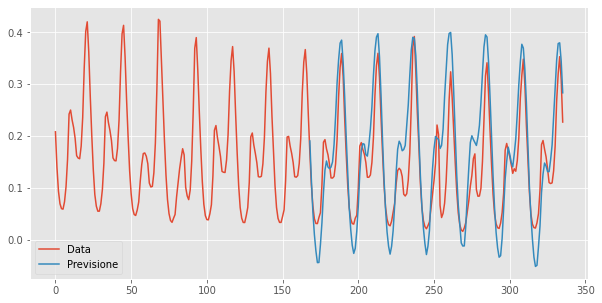

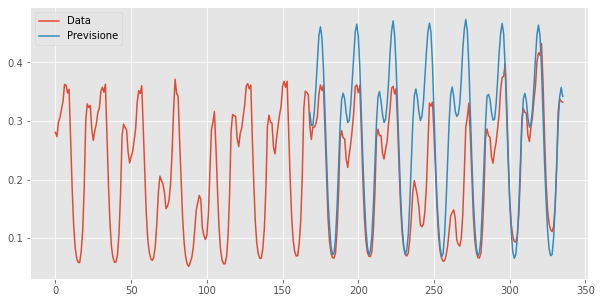

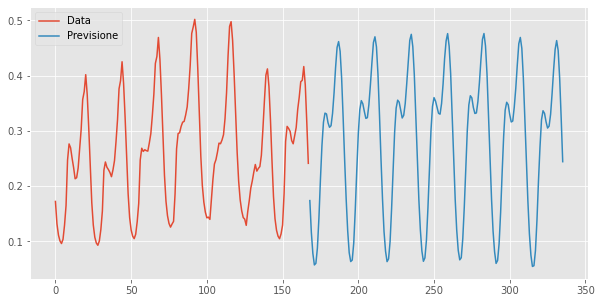

(None, None, None)

In [ ]:
plot_one_window(model, valX, n_in, n_out), plot_one_window(model, valX, n_in, n_out, k = int(valX.shape[0]/2)), plot_one_window(model, valX, n_in, n_out, k = valX.shape[0]-1)

#### ***pt.VI: 1 settimana prima -> 1 settimana dopo (1000 unità, senza dropout)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = MODEL_CODE + 1

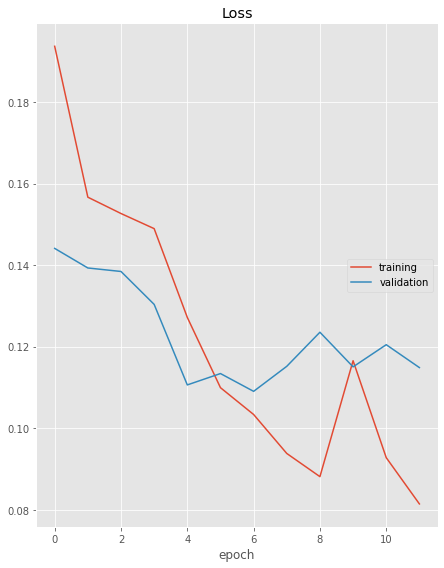

Loss
	training         	 (min:    0.081, max:    0.194, cur:    0.081)
	validation       	 (min:    0.109, max:    0.144, cur:    0.115)


 ***** EVALUATION WITHOUT SCALING ***** 


103/103 [==============================] - 8s 72ms/step - loss: 0.1090


 ***** EVALUATION WITH SCALING ***** 


103/103 [==============================] - 7s 67ms/step - loss: 3487785.7500


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
n_in, n_out = 24*7, 24*7

trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(1000, input_shape=(n_in, n_features)))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5)

# gradient clipping
# relu
# normalization

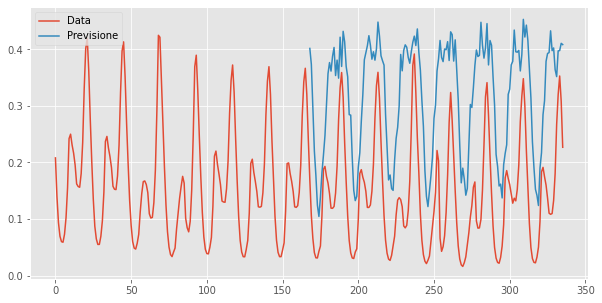

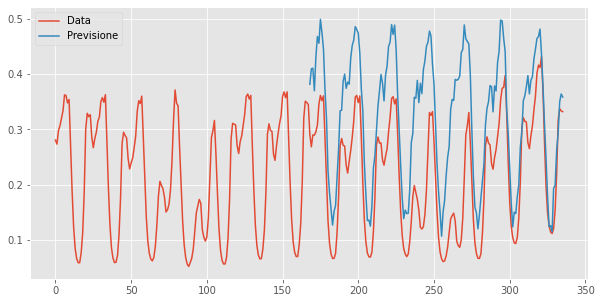

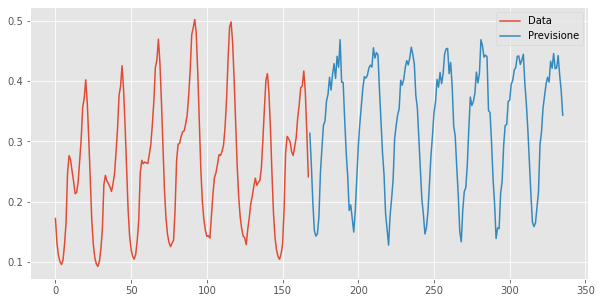

(None, None, None)

In [ ]:
plot_one_window(model, valX, n_in, n_out), plot_one_window(model, valX, n_in, n_out, k = int(valX.shape[0]/2)), plot_one_window(model, valX, n_in, n_out, k = valX.shape[0]-1)

#### ***pt.VII: 1 settimana prima -> 1 settimana dopo (1000 unità + dropout 0.2)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = MODEL_CODE + 1

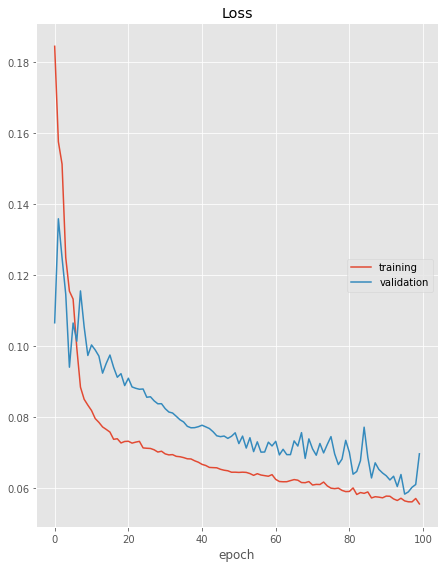

Loss
	training         	 (min:    0.055, max:    0.184, cur:    0.055)
	validation       	 (min:    0.058, max:    0.136, cur:    0.070)


 ***** EVALUATION WITHOUT SCALING ***** 


103/103 [==============================] - 7s 70ms/step - loss: 0.0696


 ***** EVALUATION WITH SCALING ***** 


103/103 [==============================] - 7s 67ms/step - loss: 3487786.7500


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
n_in, n_out = 24*7, 24*7

trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
del model 
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(1000, input_shape=(n_in, n_features)))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 10)

# gradient clipping
# relu
# normalization

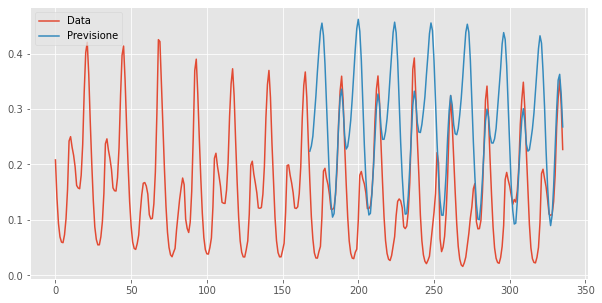

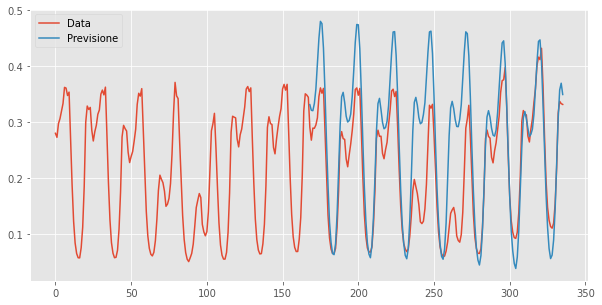

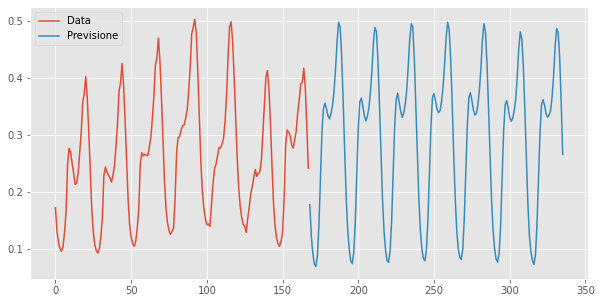

(None, None, None)

In [ ]:
plot_one_window(model, valX, n_in, n_out), plot_one_window(model, valX, n_in, n_out, k = int(valX.shape[0]/2)), plot_one_window(model, valX, n_in, n_out, k = valX.shape[0]-1)

#### ***pt.VIII: 1 settimana prima -> 1 settimana dopo (32-16 unità + dropout 0.2)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = MODEL_CODE + 1

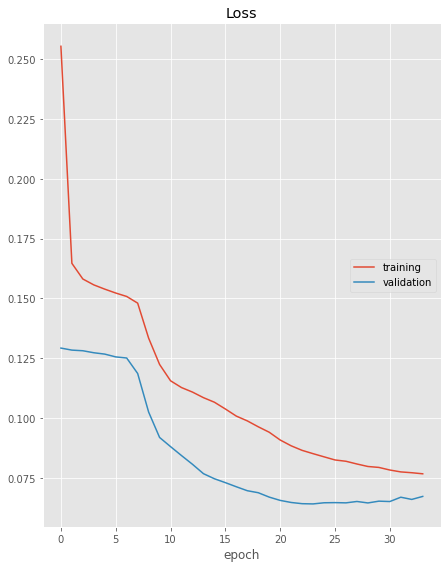

Loss
	training         	 (min:    0.077, max:    0.255, cur:    0.077)
	validation       	 (min:    0.064, max:    0.129, cur:    0.067)


 ***** EVALUATION WITHOUT SCALING ***** 


103/103 [==============================] - 2s 23ms/step - loss: 0.0640


 ***** EVALUATION WITH SCALING ***** 


103/103 [==============================] - 2s 22ms/step - loss: 3487786.7500


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
n_in, n_out = 24*7, 24*7

trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
del model 
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(32, input_shape=(n_in, n_features), return_sequences=True))
model.add(Dropout(0.2))
model.add(CuDNNLSTM(16))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 10)

# gradient clipping
# relu
# normalization

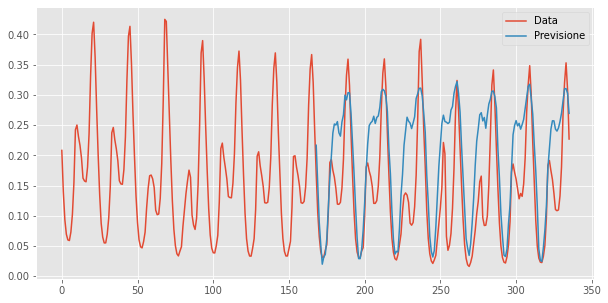

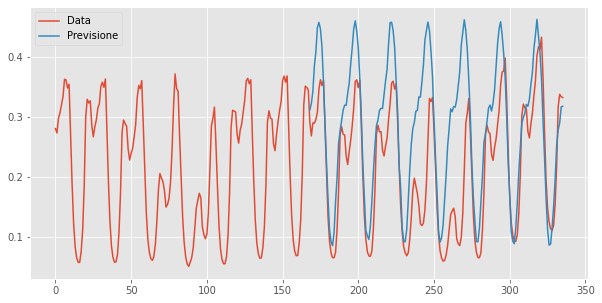

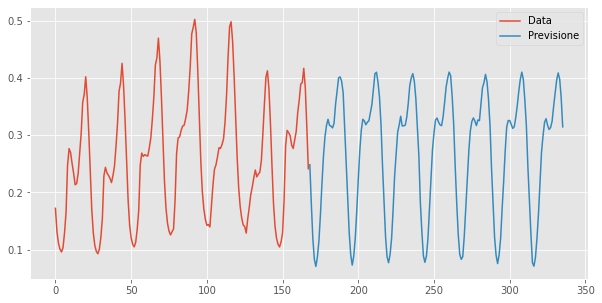

(None, None, None)

In [ ]:
plot_one_window(model, valX, n_in, n_out), plot_one_window(model, valX, n_in, n_out, k = int(valX.shape[0]/2)), plot_one_window(model, valX, n_in, n_out, k = valX.shape[0]-1)

#### ***pt.IX: 1 settimana prima -> 1 settimana dopo (64-32 unità + dropout 0.2)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = MODEL_CODE + 1

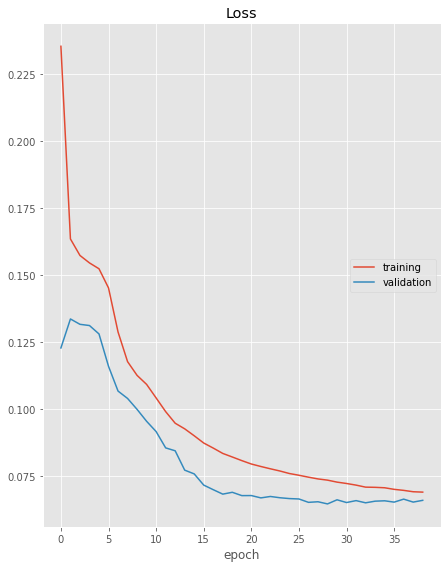

Loss
	training         	 (min:    0.069, max:    0.235, cur:    0.069)
	validation       	 (min:    0.064, max:    0.134, cur:    0.066)


 ***** EVALUATION WITHOUT SCALING ***** 


103/103 [==============================] - 3s 24ms/step - loss: 0.0645


 ***** EVALUATION WITH SCALING ***** 


103/103 [==============================] - 2s 22ms/step - loss: 3487786.7500


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
n_in, n_out = 24*7, 24*7

trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
del model 
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(64, input_shape=(n_in, n_features), return_sequences=True))
model.add(Dropout(0.2))
model.add(CuDNNLSTM(32))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 10)

# gradient clipping
# relu
# normalization

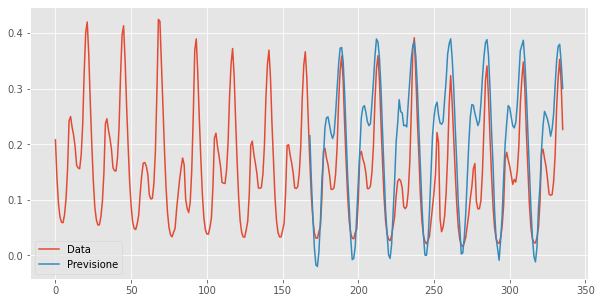

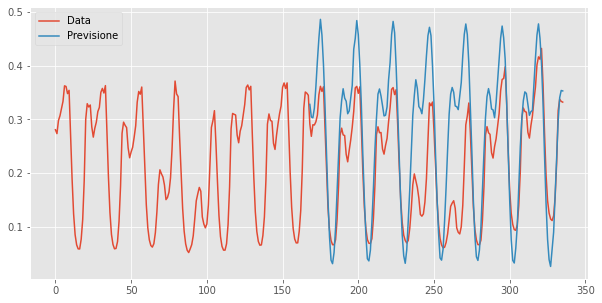

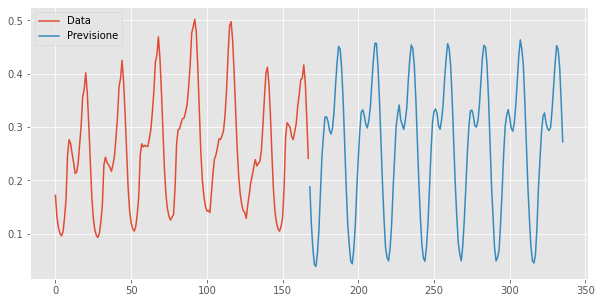

(None, None, None)

In [ ]:
plot_one_window(model, valX, n_in, n_out), plot_one_window(model, valX, n_in, n_out, k = int(valX.shape[0]/2)), plot_one_window(model, valX, n_in, n_out, k = valX.shape[0]-1)

#### ***pt.X: 1 settimana prima -> 1 settimana dopo (128-64-32 unità + dropout 0.2)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = MODEL_CODE + 1

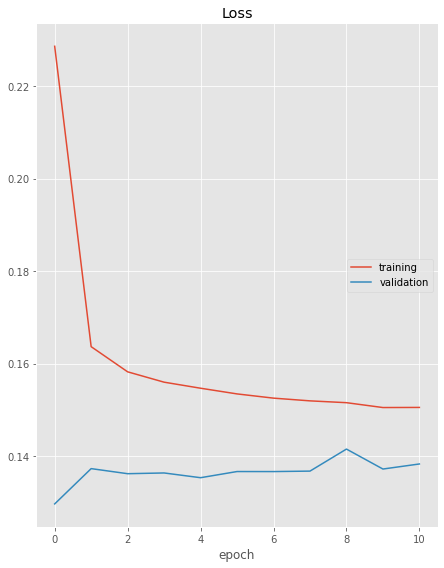

Loss
	training         	 (min:    0.151, max:    0.229, cur:    0.151)
	validation       	 (min:    0.130, max:    0.142, cur:    0.138)


 ***** EVALUATION WITHOUT SCALING ***** 


103/103 [==============================] - 3s 30ms/step - loss: 0.1297


 ***** EVALUATION WITH SCALING ***** 


103/103 [==============================] - 3s 34ms/step - loss: 3487786.7500


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
n_in, n_out = 24*7, 24*7

trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
del model 
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(128, input_shape=(n_in, n_features), return_sequences=True))
model.add(Dropout(0.2))
model.add(CuDNNLSTM(64, input_shape=(n_in, n_features), return_sequences=True))
model.add(Dropout(0.2))
model.add(CuDNNLSTM(32))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 10)

# gradient clipping
# relu
# normalization

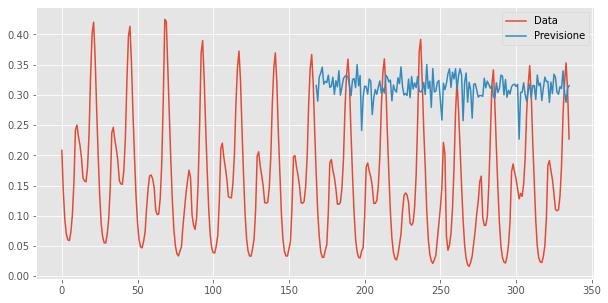

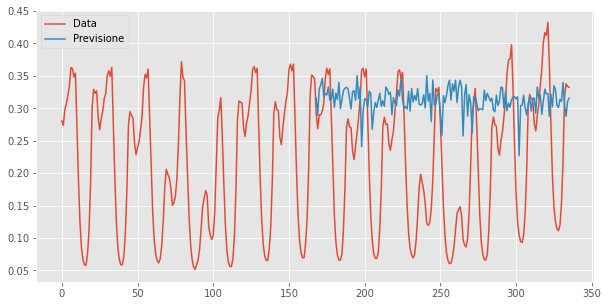

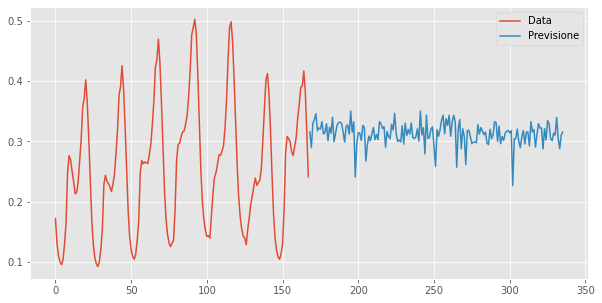

(None, None, None)

In [ ]:
plot_one_window(model, valX, n_in, n_out), plot_one_window(model, valX, n_in, n_out, k = int(valX.shape[0]/2)), plot_one_window(model, valX, n_in, n_out, k = valX.shape[0]-1)

### ***MODELS -- LSTM***

In [ ]:
k = 0
table_result_LSTM = pd.DataFrame(columns=['Model_CODE', 'MAE_TRAIN', 'MAE_TRAIN_ORIGINAL', 'MAE_VAL', 'MAE_VAL_ORIGINAL'])

#### ***--- 2 mesi prima -> 2 mesi dopo (32 units + dropout 0.2)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '32_dropout_02'

In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
# window in and out for the supervised forecast.
n_in, n_out = 24*62, 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )




 ***** DATA PREPARATION ***** 


trainX shape: (10920, 1488)
trainY shape: (10920, 1488)
valX shape: (650, 1488)
valY shape: (650, 1488)


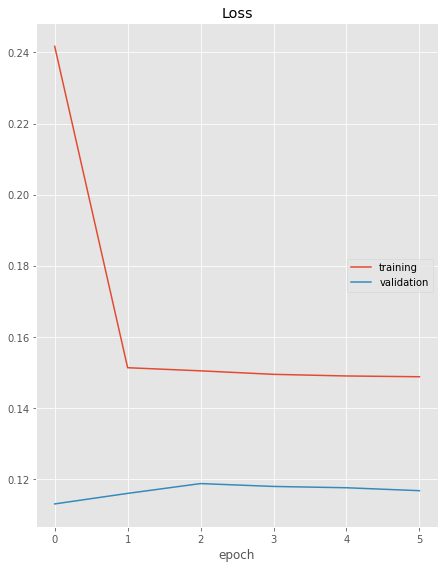

Loss
	training         	 (min:    0.149, max:    0.242, cur:    0.149)
	validation       	 (min:    0.113, max:    0.119, cur:    0.117)


 ***** EVALUATION WITHOUT SCALING ***** 


21/21 [==============================] - 1s 25ms/step - loss: 0.1130


 ***** EVALUATION WITH SCALING ***** 


21/21 [==============================] - 0s 19ms/step - loss: 3918752.2500


In [ ]:
print("\n\n ***** MODELING ***** \n\n")
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(32, input_shape=(n_in, n_features)))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5)

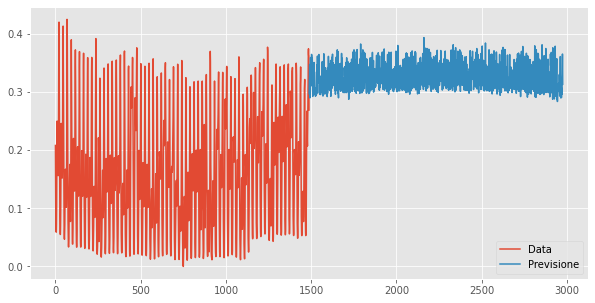

In [ ]:
forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

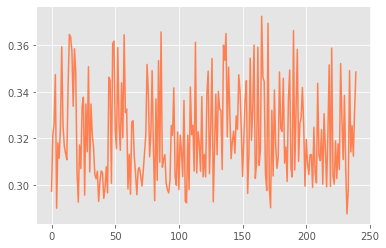

In [ ]:
plt.plot(forecasted[0][0:(24*10)], color = 'coral')

In [ ]:
table_result_LSTM = table_result_LSTM.append({'Model_CODE':MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_LSTM.to_csv('drive/MyDrive/TimeSeries/table_result_LSTM.csv', index=False)
table_result_LSTM

,Model_CODE,MAE_TRAIN,MAE_TRAIN_ORIGINAL,MAE_VAL,MAE_VAL_ORIGINAL
0,32_dropout_02,0.146076,4474130.0,0.112961,3918752.25


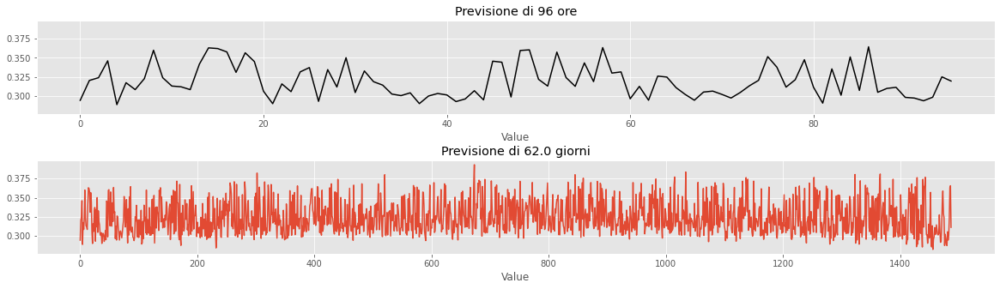

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

In [ ]:
# come viene calcolato l'errore? Come la media dei mae delle finestre. 
my_mae = []

for i in tqdm(range(valX.shape[0])):
  yhat = model.predict(np.expand_dims(valX[i], axis = 0))[0]
  my_mae.append(mae(yhat, valY[i]))

np.mean(my_mae), model.evaluate(valX, valY, verbose=0)

100%|██████████| 650/650 [00:28<00:00, 22.71it/s]


(0.11296106227793001, 0.1129610612988472)

#### ***--- 2 mesi prima -> 2 mesi dopo (32 units, no dropout)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '32'

In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
# window in and out for the supervised forecast.
n_in, n_out = 24*62, 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )




 ***** DATA PREPARATION ***** 


trainX shape: (10920, 1488)
trainY shape: (10920, 1488)
valX shape: (650, 1488)
valY shape: (650, 1488)


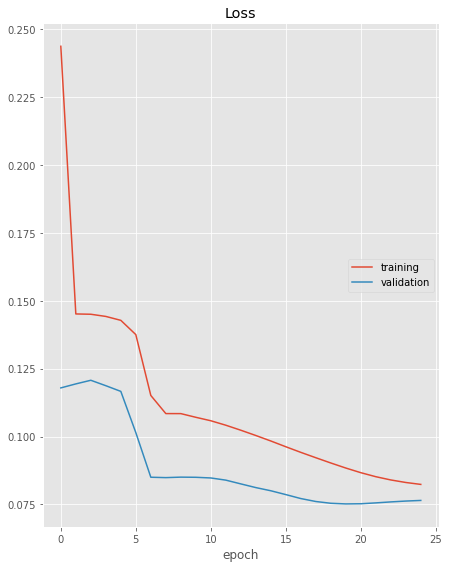

Loss
	training         	 (min:    0.082, max:    0.244, cur:    0.082)
	validation       	 (min:    0.075, max:    0.121, cur:    0.076)


 ***** EVALUATION WITHOUT SCALING ***** 


21/21 [==============================] - 0s 18ms/step - loss: 0.0752


 ***** EVALUATION WITH SCALING ***** 


21/21 [==============================] - 0s 20ms/step - loss: 3918752.0000


In [ ]:
print("\n\n ***** MODELING ***** \n\n")
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(32, input_shape=(n_in, n_features)))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5)

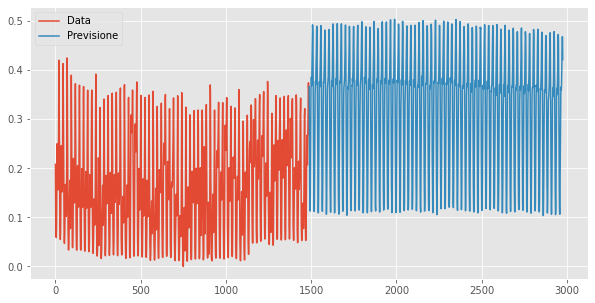

In [ ]:
forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

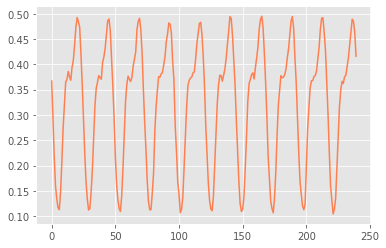

In [ ]:
plt.plot(forecasted[0][0:(24*10)], color = 'coral')

In [ ]:
table_result_LSTM = table_result_LSTM.append({'Model_CODE':MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_LSTM.to_csv('drive/MyDrive/TimeSeries/table_result_LSTM.csv', index=False)
table_result_LSTM

,Model_CODE,MAE_TRAIN,MAE_TRAIN_ORIGINAL,MAE_VAL,MAE_VAL_ORIGINAL
0,32_dropout_02,0.146076,4474130.0,0.112961,3918752.25
1,32,0.082289,4474129.5,0.075181,3918752.00


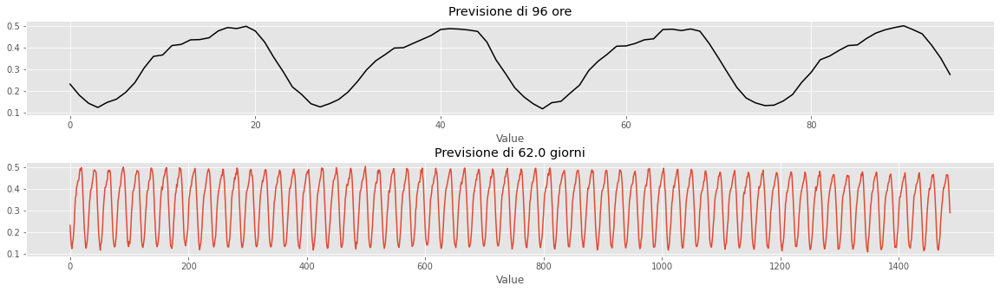

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### ***--- 2 mesi prima -> 2 mesi dopo (64 units + dropout 0.2)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '64_dropout_02'

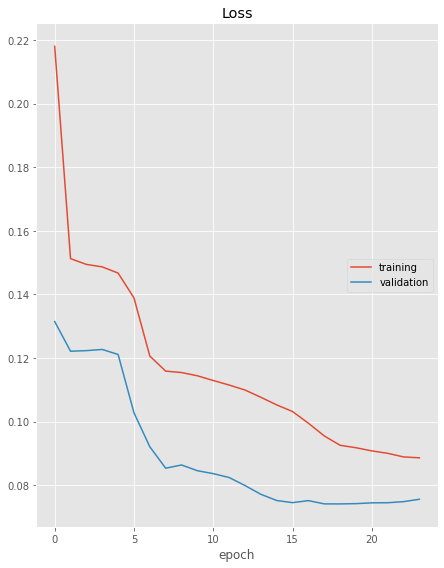

Loss
	training         	 (min:    0.089, max:    0.218, cur:    0.089)
	validation       	 (min:    0.074, max:    0.131, cur:    0.076)


 ***** EVALUATION WITHOUT SCALING ***** 


21/21 [==============================] - 1s 26ms/step - loss: 0.0741


 ***** EVALUATION WITH SCALING ***** 


21/21 [==============================] - 0s 18ms/step - loss: 3918751.5000


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
# window in and out for the supervised forecast.
n_in, n_out = 24*62, 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
del model 
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(64, input_shape=(n_in, n_features)))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5)

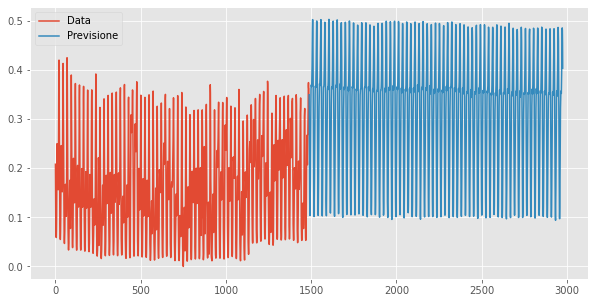

In [ ]:
forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

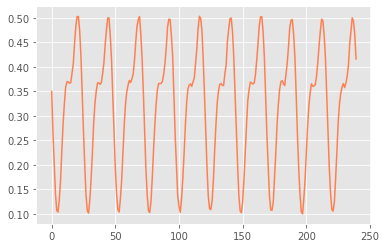

In [ ]:
plt.plot(forecasted[k][0:(24*10)], color = 'coral')

In [ ]:
table_result_LSTM = table_result_LSTM.append({'Model_CODE':MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_LSTM.to_csv('drive/MyDrive/TimeSeries/table_result_LSTM.csv', index=False)
table_result_LSTM

,Model_CODE,MAE_TRAIN,MAE_TRAIN_ORIGINAL,MAE_VAL,MAE_VAL_ORIGINAL
0,32_dropout_02,0.146076,4474130.0,0.112961,3918752.25
1,32,0.082289,4474129.5,0.075181,3918752.00
2,64_dropout_02,0.081683,4474129.5,0.074138,3918751.50


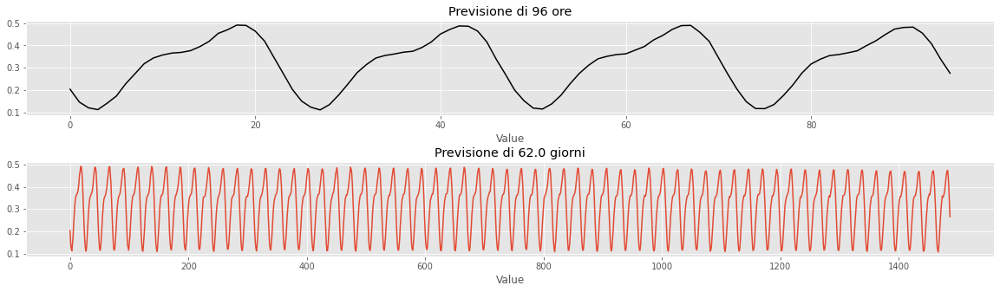

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### ***--- 2 mesi prima -> 2 mesi dopo (100 units + dropout 0.2)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '100_dropout_02'

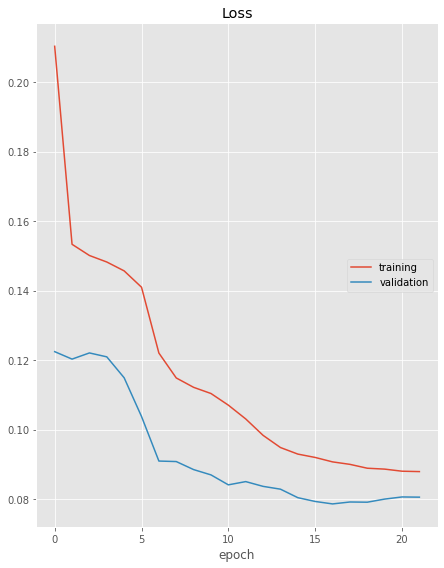

Loss
	training         	 (min:    0.088, max:    0.210, cur:    0.088)
	validation       	 (min:    0.079, max:    0.122, cur:    0.081)


 ***** EVALUATION WITHOUT SCALING ***** 


21/21 [==============================] - 1s 27ms/step - loss: 0.0786


 ***** EVALUATION WITH SCALING ***** 


21/21 [==============================] - 0s 18ms/step - loss: 3918752.0000


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
# window in and out for the supervised forecast.
n_in, n_out = 24*62, 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# del model 
# define the LSTM architecture.
model = Sequential()
if len(tf.config.list_physical_devices('GPU')) == 0:
  model.add(LSTM(100, input_shape=(n_in, n_features)))
else:
  model.add(CuDNNLSTM(100, input_shape=(n_in, n_features)))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5)

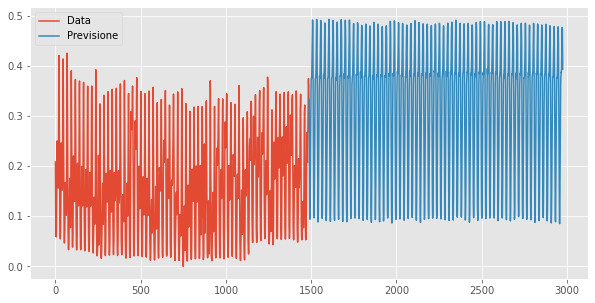

In [ ]:
forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

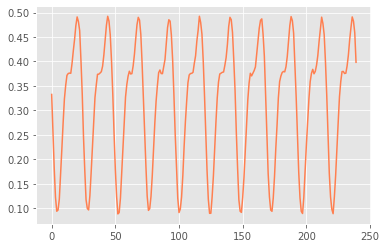

In [ ]:
plt.plot(forecasted[k][0:(24*10)], color = 'coral')

In [ ]:
table_result_LSTM = table_result_LSTM.append({'Model_CODE':MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_LSTM.to_csv('drive/MyDrive/TimeSeries/table_result_LSTM.csv', index=False)
table_result_LSTM

,Model_CODE,MAE_TRAIN,MAE_TRAIN_ORIGINAL,MAE_VAL,MAE_VAL_ORIGINAL
0,32_dropout_02,0.146076,4474130.0,0.112961,3918752.25
1,32,0.082289,4474129.5,0.075181,3918752.00
2,64_dropout_02,0.081683,4474129.5,0.074138,3918751.50
3,100_dropout_02,0.080273,4474129.5,0.078601,3918752.00


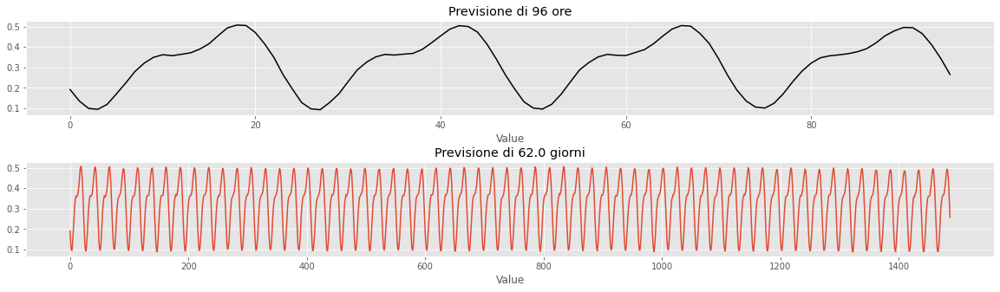

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### ***--- 2 mesi prima -> 2 mesi dopo (128 units + dropout 0.2)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '128_dropout_02'

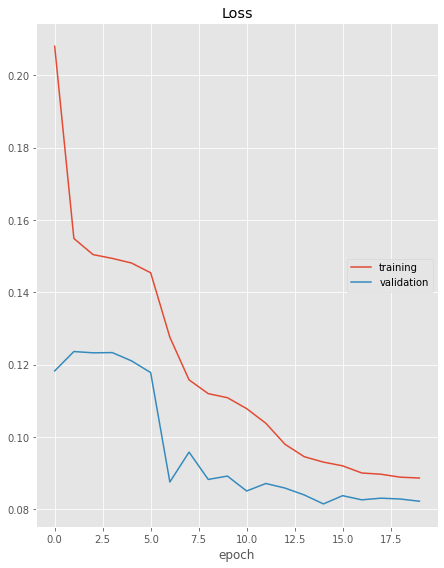

Loss
	training         	 (min:    0.089, max:    0.208, cur:    0.089)
	validation       	 (min:    0.081, max:    0.124, cur:    0.082)


 ***** EVALUATION WITHOUT SCALING ***** 


21/21 [==============================] - 1s 34ms/step - loss: 0.0815


 ***** EVALUATION WITH SCALING ***** 


21/21 [==============================] - 1s 25ms/step - loss: 3918751.5000


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
# window in and out for the supervised forecast.
n_in, n_out = 24*62, 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
del model 
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(128, input_shape=(n_in, n_features)))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5)

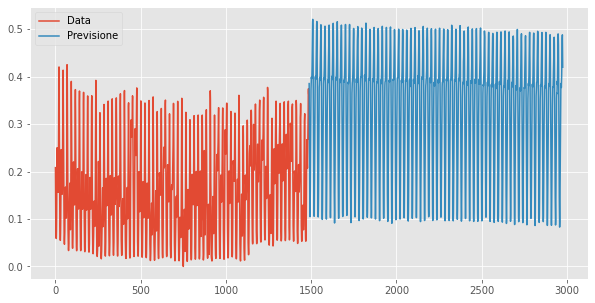

In [ ]:
forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

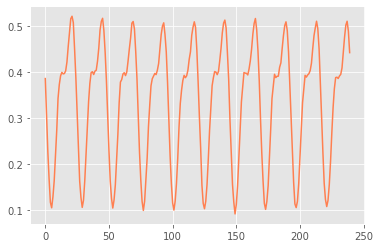

In [ ]:
plt.plot(forecasted[k][0:(24*10)], color = 'coral')

In [ ]:
table_result_LSTM = table_result_LSTM.append({'Model_CODE':MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_LSTM.to_csv('drive/MyDrive/TimeSeries/table_result_LSTM.csv', index=False)
table_result_LSTM

,Model_CODE,MAE_TRAIN,MAE_TRAIN_ORIGINAL,MAE_VAL,MAE_VAL_ORIGINAL
0,32_dropout_02,0.146076,4474130.0,0.112961,3918752.25
1,32,0.082289,4474129.5,0.075181,3918752.00
2,64_dropout_02,0.081683,4474129.5,0.074138,3918751.50
3,100_dropout_02,0.080273,4474129.5,0.078601,3918752.00
4,128_dropout_02,0.078364,4474129.0,0.081457,3918751.50


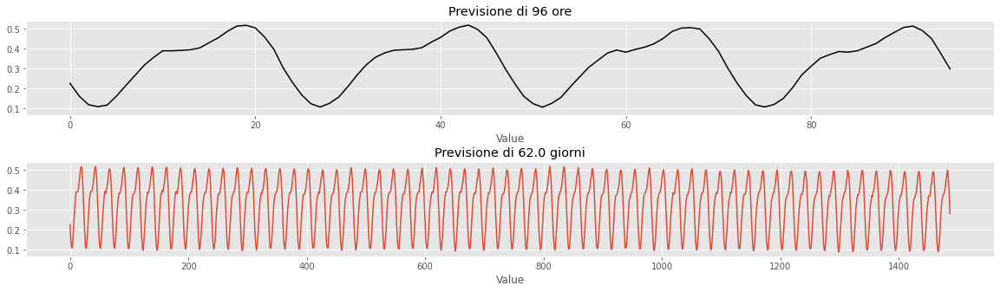

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### ***--- 2 mesi prima -> 2 mesi dopo (128 units, no dropout)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '128'

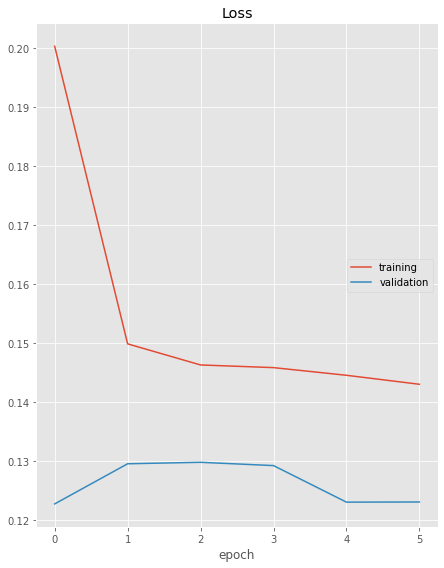

Loss
	training         	 (min:    0.143, max:    0.200, cur:    0.143)
	validation       	 (min:    0.123, max:    0.130, cur:    0.123)


 ***** EVALUATION WITHOUT SCALING ***** 


21/21 [==============================] - 1s 24ms/step - loss: 0.1228


 ***** EVALUATION WITH SCALING ***** 


21/21 [==============================] - 1s 24ms/step - loss: 3918752.0000


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
# window in and out for the supervised forecast.
n_in, n_out = 24*62, 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
del model 
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(128, input_shape=(n_in, n_features)))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5)

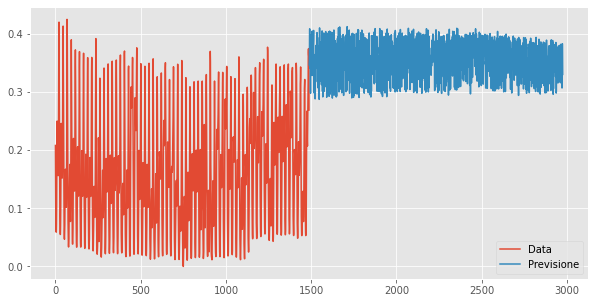

In [ ]:
forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

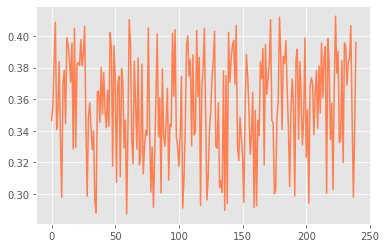

In [ ]:
plt.plot(forecasted[k][0:(24*10)], color = 'coral')

In [ ]:
table_result_LSTM = table_result_LSTM.append({'Model_CODE':MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_LSTM.to_csv('drive/MyDrive/TimeSeries/table_result_LSTM.csv', index=False)
table_result_LSTM

,Model_CODE,MAE_TRAIN,MAE_TRAIN_ORIGINAL,MAE_VAL,MAE_VAL_ORIGINAL
0,32_dropout_02,0.146076,4474130.0,0.112961,3918752.25
1,32,0.082289,4474129.5,0.075181,3918752.00
2,64_dropout_02,0.081683,4474129.5,0.074138,3918751.50
3,100_dropout_02,0.080273,4474129.5,0.078601,3918752.00
4,128_dropout_02,0.078364,4474129.0,0.081457,3918751.50
5,128,0.144036,4474129.5,0.122763,3918752.00


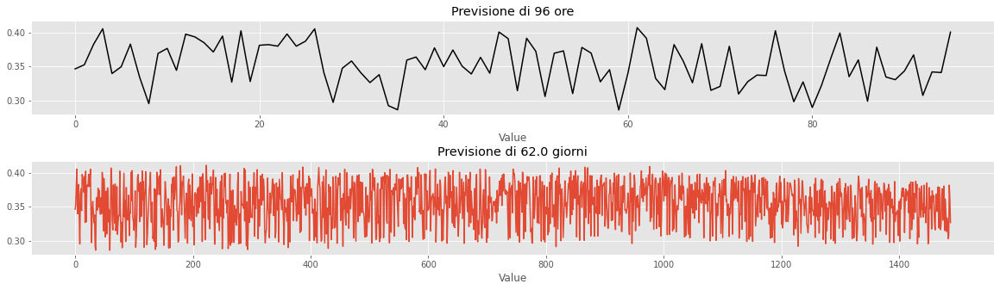

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### ***--- 2 mesi prima -> 2 mesi dopo (128 unità + dropout 0.2, lr basso)***

In [ ]:
# constants.
LR = 1e-6
CLIPVALUE = 0.5
MODEL_CODE = '128_dropout_02_lrbasso'

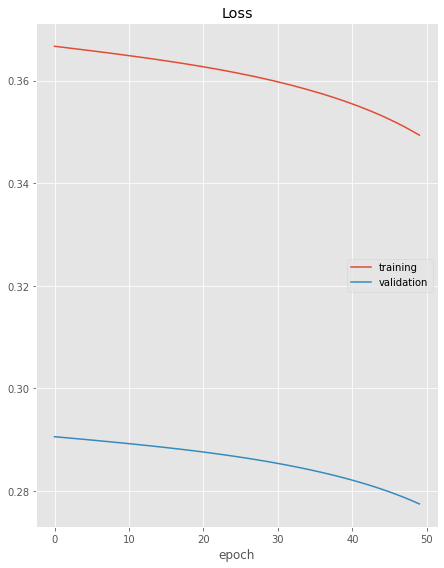

Loss
	training         	 (min:    0.349, max:    0.367, cur:    0.349)
	validation       	 (min:    0.277, max:    0.291, cur:    0.277)


 ***** EVALUATION WITHOUT SCALING ***** 


21/21 [==============================] - 1s 24ms/step - loss: 0.2775


 ***** EVALUATION WITH SCALING ***** 


21/21 [==============================] - 1s 24ms/step - loss: 3918752.2500


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
# window in and out for the supervised forecast.
n_in, n_out = 24*62, 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
del model 
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(128, input_shape=(n_in, n_features)))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 50, PATIENCE = 5)

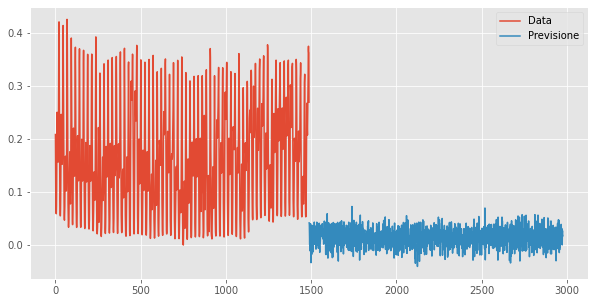

In [ ]:
forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

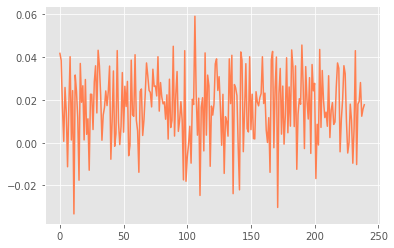

In [ ]:
plt.plot(forecasted[k][0:(24*10)], color = 'coral')

In [ ]:
table_result_LSTM = table_result_LSTM.append({'Model_CODE':MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_LSTM.to_csv('drive/MyDrive/TimeSeries/table_result_LSTM.csv', index=False)
table_result_LSTM

,Model_CODE,MAE_TRAIN,MAE_TRAIN_ORIGINAL,MAE_VAL,MAE_VAL_ORIGINAL
0,32_dropout_02,0.146076,4474130.0,0.112961,3918752.25
1,32,0.082289,4474129.5,0.075181,3918752.00
2,64_dropout_02,0.081683,4474129.5,0.074138,3918751.50
3,100_dropout_02,0.080273,4474129.5,0.078601,3918752.00
4,128_dropout_02,0.078364,4474129.0,0.081457,3918751.50
5,128,0.144036,4474129.5,0.122763,3918752.00
6,128_dropout_02_lrbasso,0.348903,4474130.0,0.277452,3918752.25


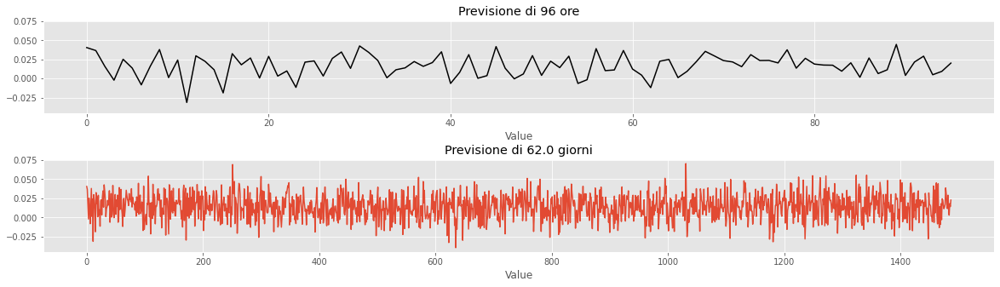

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### ***--- 2 mesi prima -> 2 mesi dopo (128 unità + dropout 0.2, lr alto)***

In [ ]:
# constants.
# LR = 1e-1 produce nan nelle ultime epoche.
LR = 1e-2
CLIPVALUE = 0.5
MODEL_CODE = '128_dropout_02_lralto'

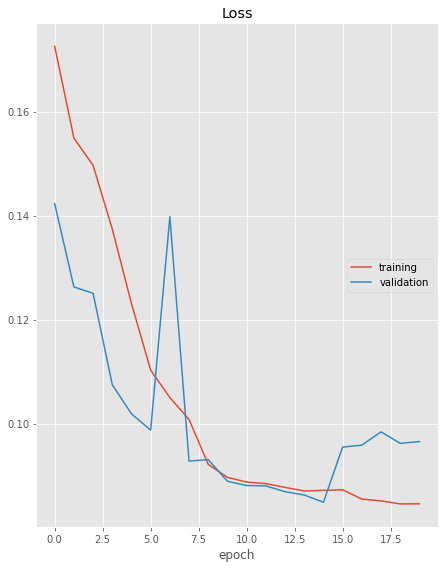

Loss
	training         	 (min:    0.085, max:    0.173, cur:    0.085)
	validation       	 (min:    0.085, max:    0.142, cur:    0.097)


 ***** EVALUATION WITHOUT SCALING ***** 


21/21 [==============================] - 1s 26ms/step - loss: 0.0849


 ***** EVALUATION WITH SCALING ***** 


21/21 [==============================] - 1s 26ms/step - loss: 3918752.0000


In [ ]:
# print("\n\n ***** DATA PREPARATION ***** \n\n")
# window in and out for the supervised forecast.
n_in, n_out = 24*62, 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
del model 
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(128, input_shape=(n_in, n_features)))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5)

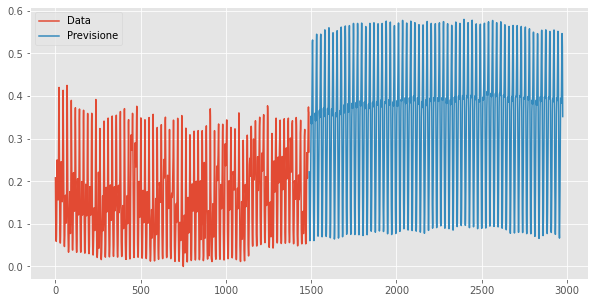

In [ ]:
forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

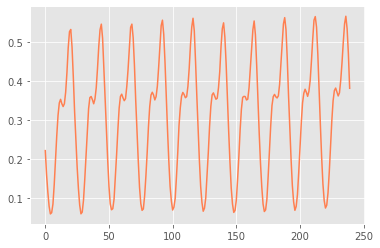

In [ ]:
plt.plot(forecasted[k][0:(24*10)], color = 'coral')

In [ ]:
table_result_LSTM = table_result_LSTM.append({'Model_CODE':MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_LSTM.to_csv('drive/MyDrive/TimeSeries/table_result_LSTM.csv', index=False)
table_result_LSTM

,Model_CODE,MAE_TRAIN,MAE_TRAIN_ORIGINAL,MAE_VAL,MAE_VAL_ORIGINAL
0,32_dropout_02,0.146076,4474130.0,0.112961,3918752.25
1,32,0.082289,4474129.5,0.075181,3918752.00
2,64_dropout_02,0.081683,4474129.5,0.074138,3918751.50
3,100_dropout_02,0.080273,4474129.5,0.078601,3918752.00
4,128_dropout_02,0.078364,4474129.0,0.081457,3918751.50
5,128,0.144036,4474129.5,0.122763,3918752.00
6,128_dropout_02_lrbasso,0.348903,4474130.0,0.277452,3918752.25
7,128_dropout_02_lralto,0.078192,4474129.5,0.084853,3918752.00


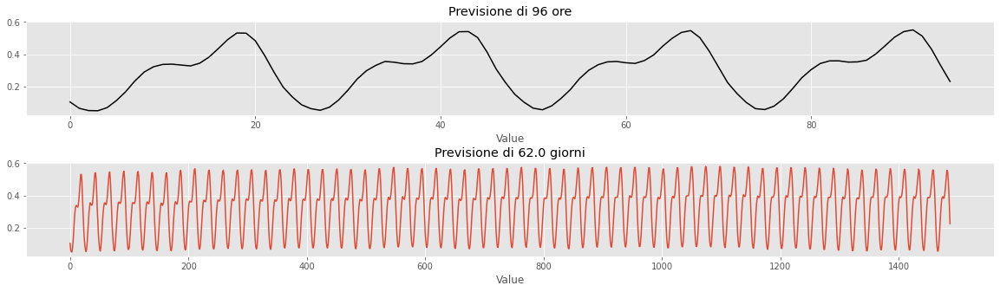

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### ***--- 2 mesi prima -> 2 mesi dopo (512 units + dropout 0.2)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '512_dropout_02'

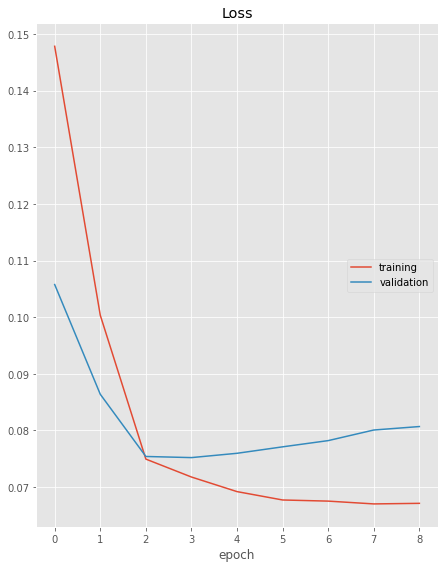

Loss
	training         	 (min:    0.067, max:    0.148, cur:    0.067)
	validation       	 (min:    0.075, max:    0.106, cur:    0.081)


 ***** EVALUATION WITHOUT SCALING ***** 


21/21 [==============================] - 1s 67ms/step - loss: 0.0752


 ***** EVALUATION WITH SCALING ***** 


21/21 [==============================] - 1s 63ms/step - loss: 3918752.0000


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
# window in and out for the supervised forecast.
n_in, n_out = 24*62, 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# del model 
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(512, input_shape=(n_in, n_features)))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5, BATCH_SIZE = 64)

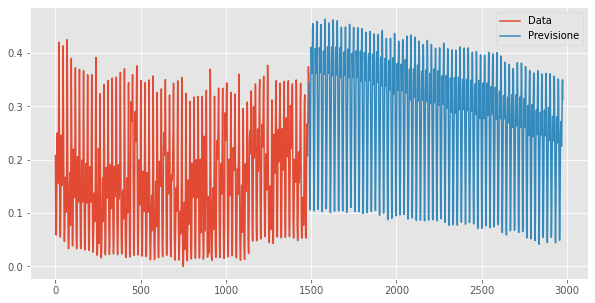

In [ ]:
forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

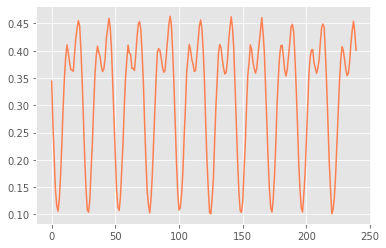

In [ ]:
plt.plot(forecasted[0][0:(24*10)], color = 'coral')

In [ ]:
table_result_LSTM = table_result_LSTM.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_LSTM.to_csv('drive/MyDrive/TimeSeries/table_result_LSTM.csv', index=False)
table_result_LSTM

,Model_CODE,MAE_TRAIN,MAE_TRAIN_ORIGINAL,MAE_VAL,MAE_VAL_ORIGINAL
0,32_dropout_02,0.146076,4474130.0,0.112961,3918752.25
1,32,0.082289,4474129.5,0.075181,3918752.00
2,64_dropout_02,0.081683,4474129.5,0.074138,3918751.50
3,100_dropout_02,0.080273,4474129.5,0.078601,3918752.00
4,128_dropout_02,0.078364,4474129.0,0.081457,3918751.50
5,128,0.144036,4474129.5,0.122763,3918752.00
6,128_dropout_02_lrbasso,0.348903,4474130.0,0.277452,3918752.25
7,128_dropout_02_lralto,0.078192,4474129.5,0.084853,3918752.00
8,512_dropout_02,0.099414,4474129.5,0.075203,3918752.00


In [ ]:
table_result_LSTM.to_csv('drive/MyDrive/TimeSeries/table_result_LSTM.csv', index=False)

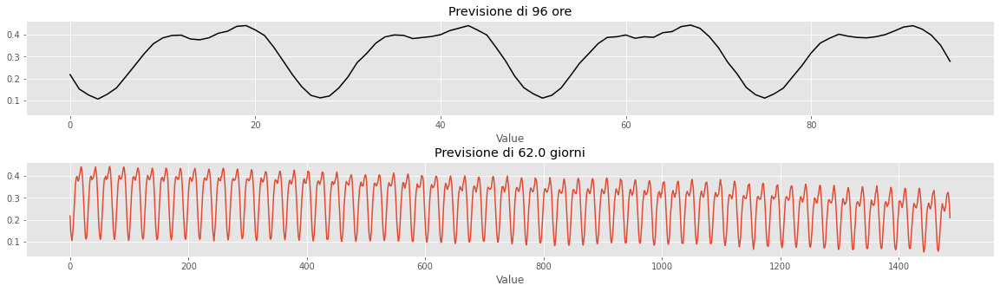

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### ***--- 2 mesi prima -> 2 mesi dopo (512 units, no dropout)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '512'

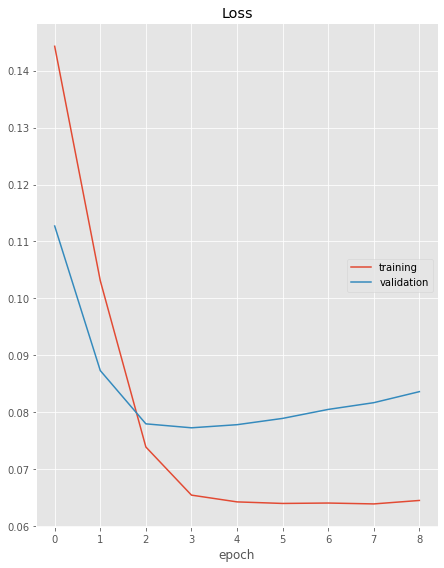

Loss
	training         	 (min:    0.064, max:    0.144, cur:    0.064)
	validation       	 (min:    0.077, max:    0.113, cur:    0.084)


 ***** EVALUATION WITHOUT SCALING ***** 


21/21 [==============================] - 2s 69ms/step - loss: 0.0773


 ***** EVALUATION WITH SCALING ***** 


21/21 [==============================] - 1s 64ms/step - loss: 3918752.0000


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
# window in and out for the supervised forecast.
n_in, n_out = 24*62, 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(512, input_shape=(n_in, n_features)))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5, BATCH_SIZE = 64)

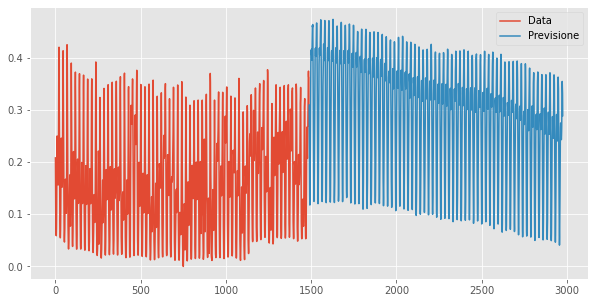

In [ ]:
forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

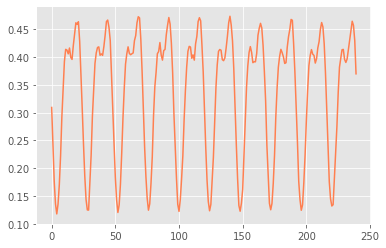

In [ ]:
plt.plot(forecasted[0][0:(24*10)], color = 'coral')

In [ ]:
table_result_LSTM = table_result_LSTM.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_LSTM.to_csv('drive/MyDrive/TimeSeries/table_result_LSTM.csv', index=False)
table_result_LSTM

,Model_CODE,MAE_TRAIN,MAE_TRAIN_ORIGINAL,MAE_VAL,MAE_VAL_ORIGINAL
0,32_dropout_02,0.146076,4474130.0,0.112961,3918752.25
1,32,0.082289,4474129.5,0.075181,3918752.00
2,64_dropout_02,0.081683,4474129.5,0.074138,3918751.50
3,100_dropout_02,0.080273,4474129.5,0.078601,3918752.00
4,128_dropout_02,0.078364,4474129.0,0.081457,3918751.50
5,128,0.144036,4474129.5,0.122763,3918752.00
6,128_dropout_02_lrbasso,0.348903,4474130.0,0.277452,3918752.25
7,128_dropout_02_lralto,0.078192,4474129.5,0.084853,3918752.00
8,512_dropout_02,0.099414,4474129.5,0.075203,3918752.00
9,512,0.096364,4474129.5,0.077260,3918752.00


In [ ]:
table_result_LSTM.to_csv('drive/MyDrive/TimeSeries/table_result_LSTM.csv', index=False)

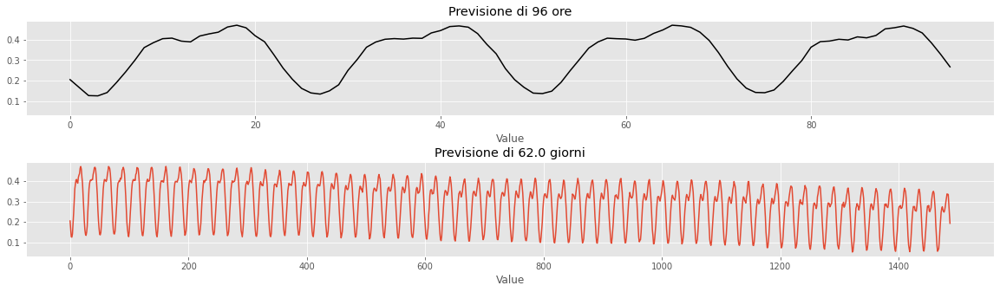

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### ***--- 2 mesi prima -> 2 mesi dopo (1000 units + dropout 0.2)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '1000_dropout_02'

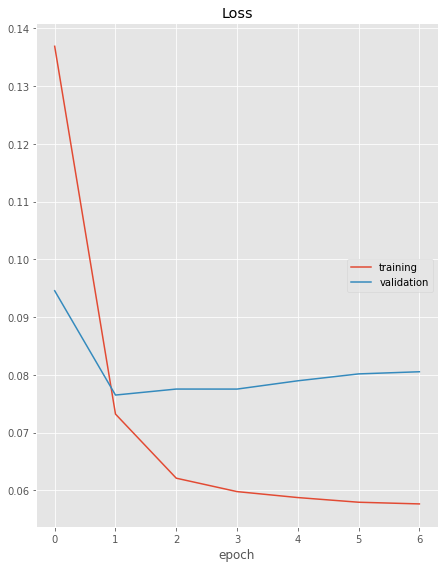

Loss
	training         	 (min:    0.058, max:    0.137, cur:    0.058)
	validation       	 (min:    0.077, max:    0.095, cur:    0.081)


 ***** EVALUATION WITHOUT SCALING ***** 


21/21 [==============================] - 4s 172ms/step - loss: 0.0765


 ***** EVALUATION WITH SCALING ***** 


21/21 [==============================] - 3s 162ms/step - loss: 3918751.5000


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
# window in and out for the supervised forecast.
n_in, n_out = 24*62, 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# del model 
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(1000, input_shape=(n_in, n_features)))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5, BATCH_SIZE = 32)

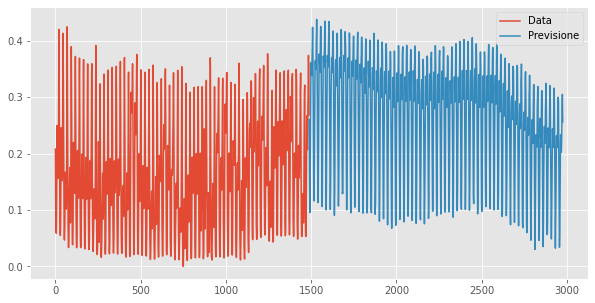

In [ ]:
forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

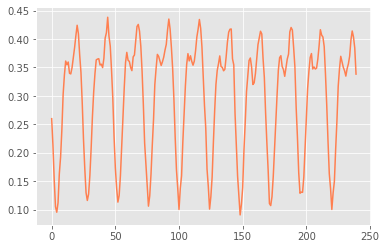

In [ ]:
plt.plot(forecasted[0][0:(24*10)], color = 'coral')

In [ ]:
table_result_LSTM = table_result_LSTM.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_LSTM.to_csv('drive/MyDrive/TimeSeries/table_result_LSTM.csv', index=False)
table_result_LSTM

,Model_CODE,MAE_TRAIN,MAE_TRAIN_ORIGINAL,MAE_VAL,MAE_VAL_ORIGINAL
0,32_dropout_02,0.146076,4474130.0,0.112961,3918752.25
1,32,0.082289,4474129.5,0.075181,3918752.00
2,64_dropout_02,0.081683,4474129.5,0.074138,3918751.50
3,100_dropout_02,0.080273,4474129.5,0.078601,3918752.00
4,128_dropout_02,0.078364,4474129.0,0.081457,3918751.50
5,128,0.144036,4474129.5,0.122763,3918752.00
6,128_dropout_02_lrbasso,0.348903,4474130.0,0.277452,3918752.25
7,128_dropout_02_lralto,0.078192,4474129.5,0.084853,3918752.00
8,512_dropout_02,0.099414,4474129.5,0.075203,3918752.00
9,512,0.096364,4474129.5,0.077260,3918752.00


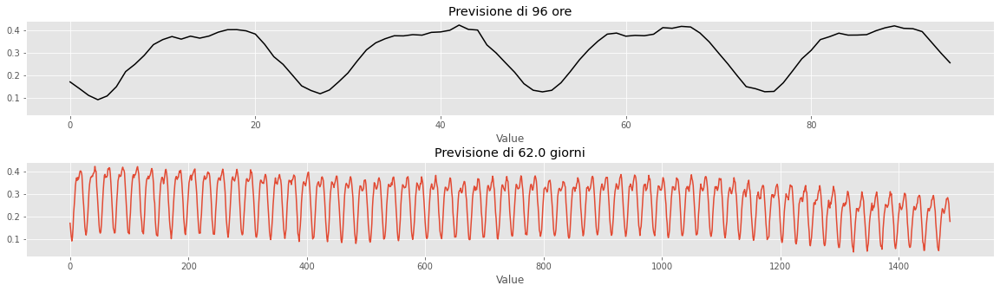

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### ***--- 2 mesi prima -> 2 mesi dopo (1000 units, no dropout)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '1000'

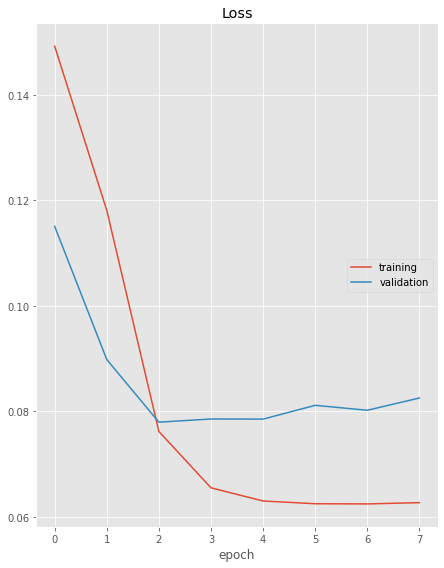

Loss
	training         	 (min:    0.062, max:    0.149, cur:    0.063)
	validation       	 (min:    0.078, max:    0.115, cur:    0.083)


 ***** EVALUATION WITHOUT SCALING ***** 


21/21 [==============================] - 4s 173ms/step - loss: 0.0780


 ***** EVALUATION WITH SCALING ***** 


21/21 [==============================] - 3s 163ms/step - loss: 3918751.5000


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
# window in and out for the supervised forecast.
n_in, n_out = 24*62, 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(1000, input_shape=(n_in, n_features)))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5, BATCH_SIZE = 64)

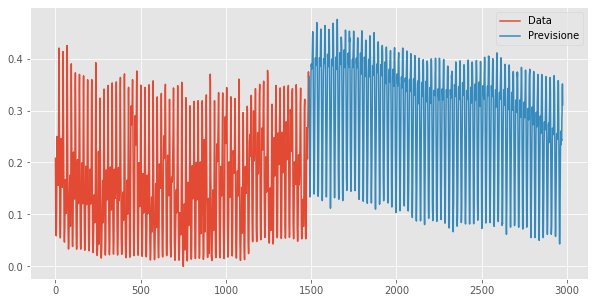

In [ ]:
forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

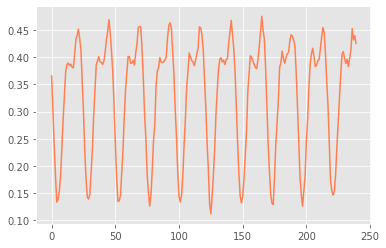

In [ ]:
plt.plot(forecasted[0][0:(24*10)], color = 'coral')

In [ ]:
table_result_LSTM = table_result_LSTM.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_LSTM.to_csv('drive/MyDrive/TimeSeries/table_result_LSTM.csv', index=False)
table_result_LSTM

,Model_CODE,MAE_TRAIN,MAE_TRAIN_ORIGINAL,MAE_VAL,MAE_VAL_ORIGINAL
0,32_dropout_02,0.146076,4474130.0,0.112961,3918752.25
1,32,0.082289,4474129.5,0.075181,3918752.00
2,64_dropout_02,0.081683,4474129.5,0.074138,3918751.50
3,100_dropout_02,0.080273,4474129.5,0.078601,3918752.00
4,128_dropout_02,0.078364,4474129.0,0.081457,3918751.50
5,128,0.144036,4474129.5,0.122763,3918752.00
6,128_dropout_02_lrbasso,0.348903,4474130.0,0.277452,3918752.25
7,128_dropout_02_lralto,0.078192,4474129.5,0.084853,3918752.00
8,512_dropout_02,0.099414,4474129.5,0.075203,3918752.00
9,512,0.096364,4474129.5,0.077260,3918752.00


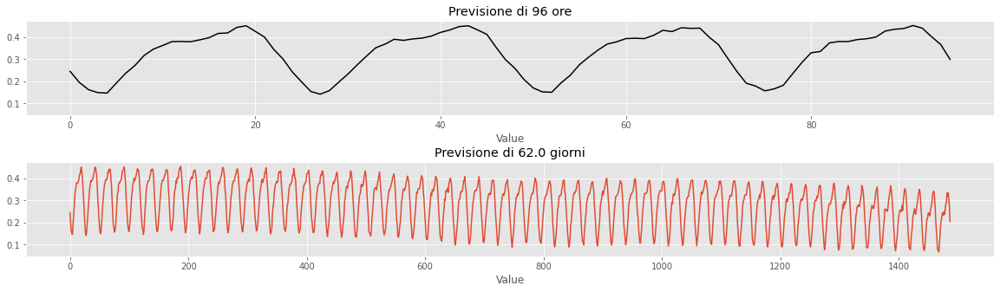

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### ***--- 2 mesi prima -> 2 mesi dopo (32 - 16 units + dropout 0.2)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '32_drop_16_drop'

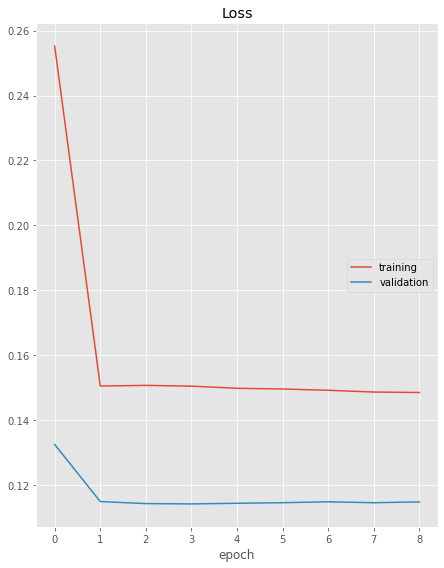

Loss
	training         	 (min:    0.148, max:    0.255, cur:    0.148)
	validation       	 (min:    0.114, max:    0.132, cur:    0.115)


 ***** EVALUATION WITHOUT SCALING ***** 


21/21 [==============================] - 1s 42ms/step - loss: 0.1141


 ***** EVALUATION WITH SCALING ***** 


21/21 [==============================] - 1s 35ms/step - loss: 3918752.0000


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
# window in and out for the supervised forecast.
n_in, n_out = 24*62, 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# del model 
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(32, input_shape=(n_in, n_features), return_sequences=True))
model.add(Dropout(0.2))
model.add(CuDNNLSTM(16, input_shape=(n_in, n_features)))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5)

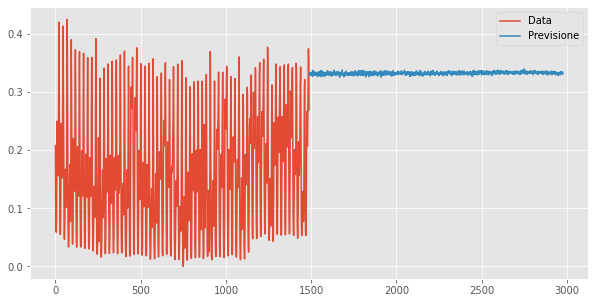

In [ ]:
forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

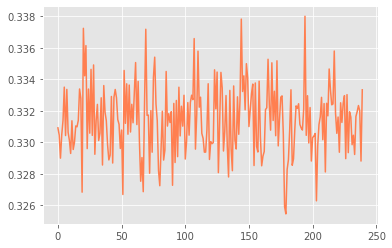

In [ ]:
plt.plot(forecasted[k][0:(24*10)], color = 'coral')

In [ ]:
table_result_LSTM = table_result_LSTM.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_LSTM.to_csv('drive/MyDrive/TimeSeries/table_result_LSTM.csv', index=False)
table_result_LSTM

,Model_CODE,MAE_TRAIN,MAE_TRAIN_ORIGINAL,MAE_VAL,MAE_VAL_ORIGINAL
0,32_dropout_02,0.146076,4474130.0,0.112961,3918752.25
1,32,0.082289,4474129.5,0.075181,3918752.00
2,64_dropout_02,0.081683,4474129.5,0.074138,3918751.50
3,100_dropout_02,0.080273,4474129.5,0.078601,3918752.00
4,128_dropout_02,0.078364,4474129.0,0.081457,3918751.50
5,128,0.144036,4474129.5,0.122763,3918752.00
6,128_dropout_02_lrbasso,0.348903,4474130.0,0.277452,3918752.25
7,128_dropout_02_lralto,0.078192,4474129.5,0.084853,3918752.00
8,512_dropout_02,0.099414,4474129.5,0.075203,3918752.00
9,512,0.096364,4474129.5,0.077260,3918752.00


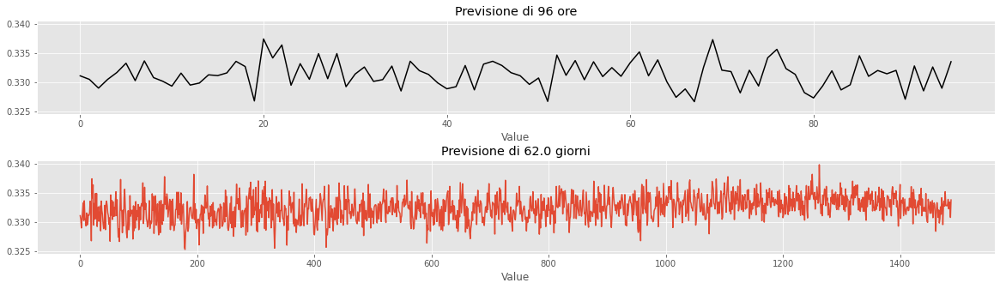

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### ***--- 2 mesi prima -> 2 mesi dopo (32 - 16 units + senza dropout)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '32_16'

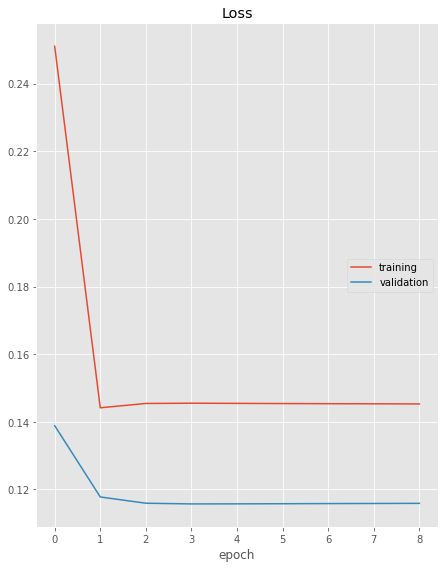

Loss
	training         	 (min:    0.144, max:    0.251, cur:    0.145)
	validation       	 (min:    0.116, max:    0.139, cur:    0.116)


 ***** EVALUATION WITHOUT SCALING ***** 


21/21 [==============================] - 1s 37ms/step - loss: 0.1157


 ***** EVALUATION WITH SCALING ***** 


21/21 [==============================] - 1s 35ms/step - loss: 3918752.0000


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
# window in and out for the supervised forecast.
n_in, n_out = 24*62, 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# del model 
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(32, input_shape=(n_in, n_features), return_sequences=True))
model.add(CuDNNLSTM(16, input_shape=(n_in, n_features)))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5)

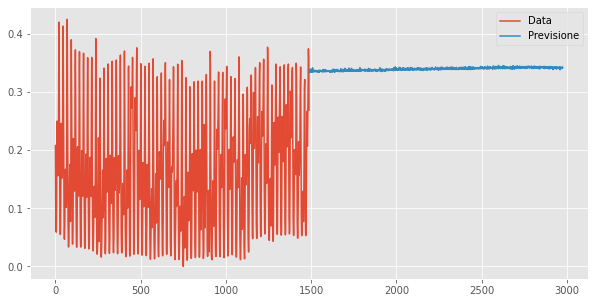

In [ ]:
forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

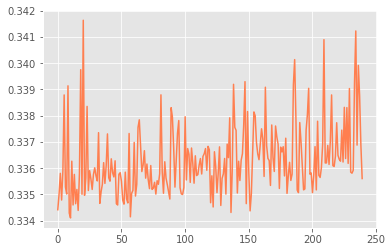

In [ ]:
plt.plot(forecasted[k][0:(24*10)], color = 'coral')

In [ ]:
table_result_LSTM = table_result_LSTM.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_LSTM.to_csv('drive/MyDrive/TimeSeries/table_result_LSTM.csv', index=False)
table_result_LSTM

,Model_CODE,MAE_TRAIN,MAE_TRAIN_ORIGINAL,MAE_VAL,MAE_VAL_ORIGINAL
0,32_dropout_02,0.146076,4474130.0,0.112961,3918752.25
1,32,0.082289,4474129.5,0.075181,3918752.00
2,64_dropout_02,0.081683,4474129.5,0.074138,3918751.50
3,100_dropout_02,0.080273,4474129.5,0.078601,3918752.00
4,128_dropout_02,0.078364,4474129.0,0.081457,3918751.50
5,128,0.144036,4474129.5,0.122763,3918752.00
6,128_dropout_02_lrbasso,0.348903,4474130.0,0.277452,3918752.25
7,128_dropout_02_lralto,0.078192,4474129.5,0.084853,3918752.00
8,512_dropout_02,0.099414,4474129.5,0.075203,3918752.00
9,512,0.096364,4474129.5,0.077260,3918752.00


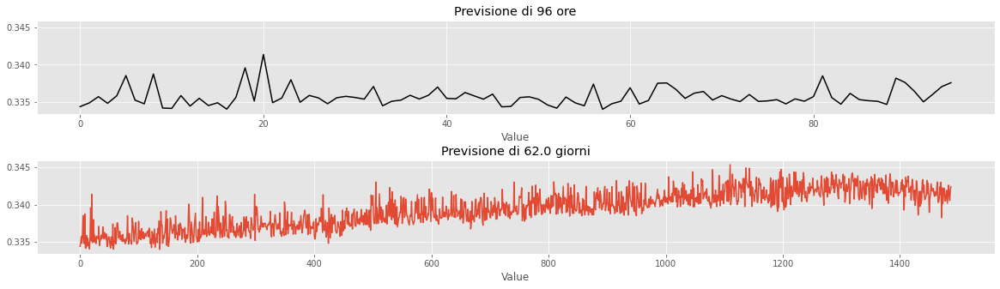

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### ***--- 2 mesi prima -> 2 mesi dopo (100 - 50 units + dropout 0.2)***

In [ ]:
# constants.
# 0.01 è troppo alto: l'errore di validation sale e basta fin dall'inizio. 
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '100_dropout_50_dropout'

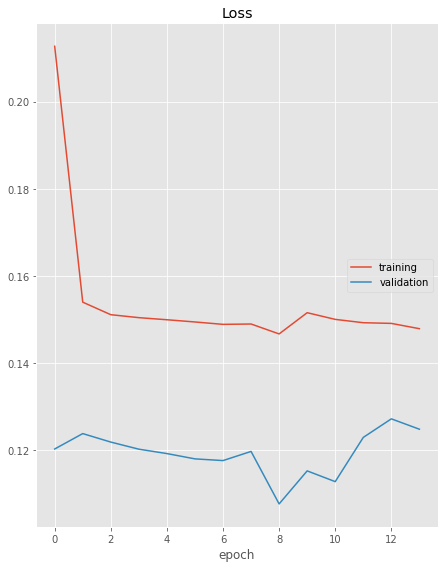

Loss
	training         	 (min:    0.147, max:    0.213, cur:    0.148)
	validation       	 (min:    0.108, max:    0.127, cur:    0.125)


 ***** EVALUATION WITHOUT SCALING ***** 


21/21 [==============================] - 1s 47ms/step - loss: 0.1077


 ***** EVALUATION WITH SCALING ***** 


21/21 [==============================] - 1s 39ms/step - loss: 3918752.0000


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
# window in and out for the supervised forecast.
n_in, n_out = 24*62, 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n") 
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(100, input_shape=(n_in, n_features), return_sequences=True))
model.add(Dropout(0.2))
model.add(CuDNNLSTM(50))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5)

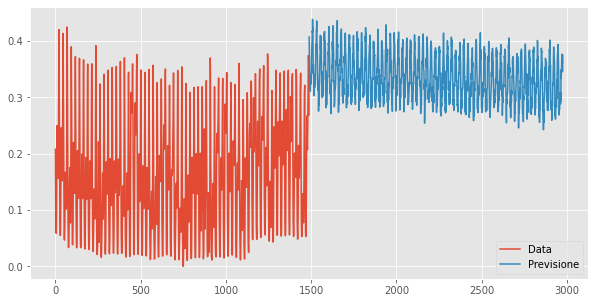

In [ ]:
forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

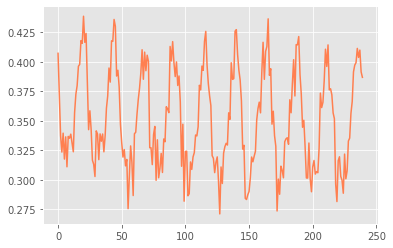

In [ ]:
plt.plot(forecasted[k][0:(24*10)], color = 'coral')

In [ ]:
table_result_LSTM = table_result_LSTM.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_LSTM.to_csv('drive/MyDrive/TimeSeries/table_result_LSTM.csv', index=False)
table_result_LSTM

,Model_CODE,MAE_TRAIN,MAE_TRAIN_ORIGINAL,MAE_VAL,MAE_VAL_ORIGINAL
0,32_dropout_02,0.146076,4474130.0,0.112961,3918752.25
1,32,0.082289,4474129.5,0.075181,3918752.00
2,64_dropout_02,0.081683,4474129.5,0.074138,3918751.50
3,100_dropout_02,0.080273,4474129.5,0.078601,3918752.00
4,128_dropout_02,0.078364,4474129.0,0.081457,3918751.50
5,128,0.144036,4474129.5,0.122763,3918752.00
6,128_dropout_02_lrbasso,0.348903,4474130.0,0.277452,3918752.25
7,128_dropout_02_lralto,0.078192,4474129.5,0.084853,3918752.00
8,512_dropout_02,0.099414,4474129.5,0.075203,3918752.00
9,512,0.096364,4474129.5,0.077260,3918752.00


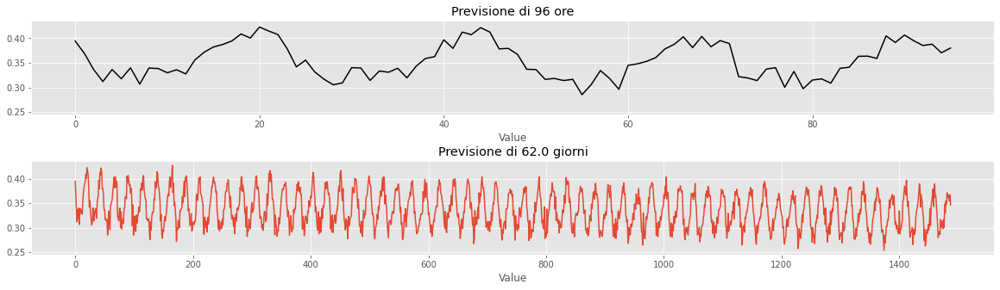

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### ***--- 2 mesi prima -> 2 mesi dopo (200 - 100 units + dropout 0.2)***

In [ ]:
# constants.
# 0.01 è troppo alto: l'errore di validation sale e basta fin dall'inizio. 
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '200_drop_100_drop'

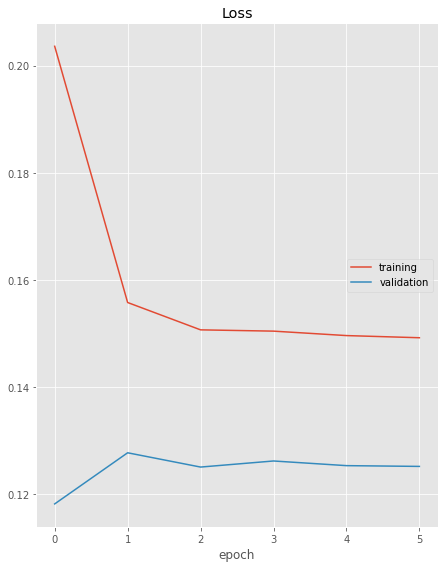

Loss
	training         	 (min:    0.149, max:    0.204, cur:    0.149)
	validation       	 (min:    0.118, max:    0.128, cur:    0.125)


 ***** EVALUATION WITHOUT SCALING ***** 


21/21 [==============================] - 1s 64ms/step - loss: 0.1182


 ***** EVALUATION WITH SCALING ***** 


21/21 [==============================] - 1s 45ms/step - loss: 3918752.0000


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
# window in and out for the supervised forecast.
n_in, n_out = 24*62, 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n") 
del model 
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(200, input_shape=(n_in, n_features), return_sequences=True))
model.add(Dropout(0.2))
model.add(CuDNNLSTM(100))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5)

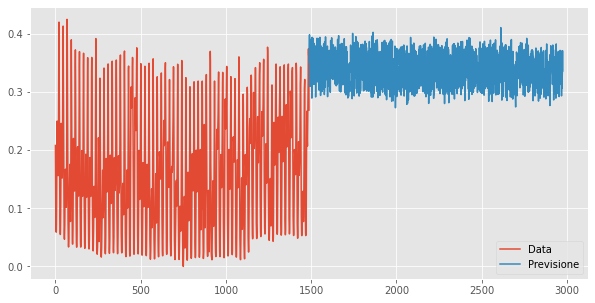

In [ ]:
forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

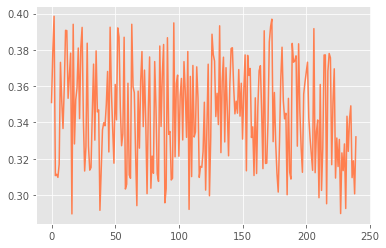

In [ ]:
plt.plot(forecasted[k][0:(24*10)], color = 'coral')

In [ ]:
table_result_LSTM = table_result_LSTM.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_LSTM.to_csv('drive/MyDrive/TimeSeries/table_result_LSTM.csv', index=False)
table_result_LSTM

,Model_CODE,MAE_TRAIN,MAE_TRAIN_ORIGINAL,MAE_VAL,MAE_VAL_ORIGINAL
0,32_dropout_02,0.146076,4474130.0,0.112961,3918752.25
1,32,0.082289,4474129.5,0.075181,3918752.00
2,64_dropout_02,0.081683,4474129.5,0.074138,3918751.50
3,100_dropout_02,0.080273,4474129.5,0.078601,3918752.00
4,128_dropout_02,0.078364,4474129.0,0.081457,3918751.50
5,128,0.144036,4474129.5,0.122763,3918752.00
6,128_dropout_02_lrbasso,0.348903,4474130.0,0.277452,3918752.25
7,128_dropout_02_lralto,0.078192,4474129.5,0.084853,3918752.00
8,512_dropout_02,0.099414,4474129.5,0.075203,3918752.00
9,512,0.096364,4474129.5,0.077260,3918752.00


In [ ]:
table_result_LSTM.sort_values('MAE_VAL')

,Model_CODE,MAE_TRAIN,MAE_TRAIN_ORIGINAL,MAE_VAL,MAE_VAL_ORIGINAL
2,64_dropout_02,0.081683,4474129.5,0.074138,3918751.50
1,32,0.082289,4474129.5,0.075181,3918752.00
8,512_dropout_02,0.099414,4474129.5,0.075203,3918752.00
10,1000_dropout_02,0.106546,4474129.0,0.076514,3918751.50
9,512,0.096364,4474129.5,0.077260,3918752.00
11,1000,0.104048,4474129.0,0.077977,3918751.50
3,100_dropout_02,0.080273,4474129.5,0.078601,3918752.00
4,128_dropout_02,0.078364,4474129.0,0.081457,3918751.50
7,128_dropout_02_lralto,0.078192,4474129.5,0.084853,3918752.00
14,100_dropout_50_dropout,0.131593,4474129.5,0.107687,3918752.00


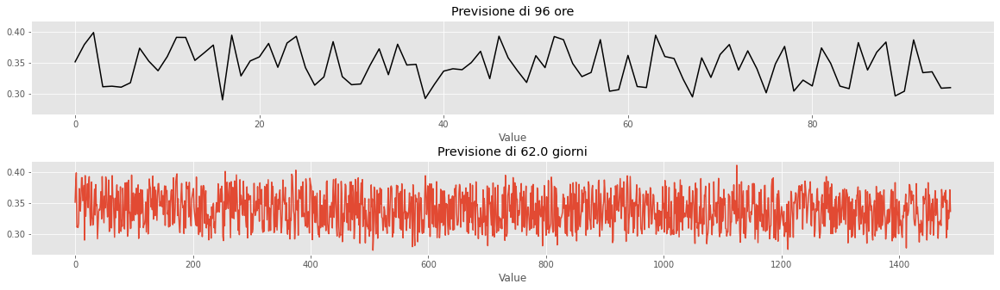

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### **** 2 mesi e 2 settimane prima -> 2 mesi dopo (128 + dropout 0.2)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '2_mesi_2_sett_1'

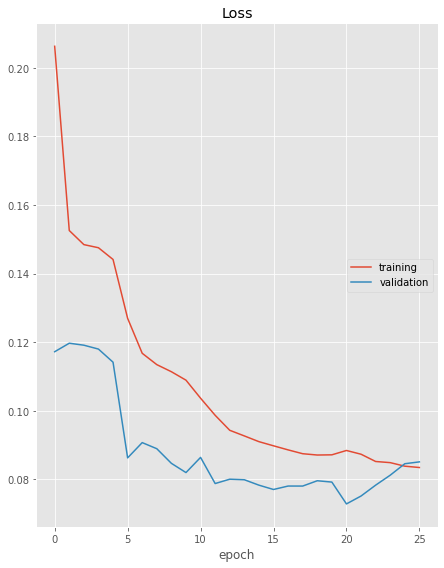

Loss
	training         	 (min:    0.083, max:    0.206, cur:    0.083)
	validation       	 (min:    0.073, max:    0.120, cur:    0.085)


 ***** EVALUATION WITHOUT SCALING ***** 


11/11 [==============================] - 1s 69ms/step - loss: 0.0729


 ***** EVALUATION WITH SCALING ***** 


11/11 [==============================] - 0s 33ms/step - loss: 3951273.7500


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
n_in, n_out = 24*(30+30+15), 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(128, input_shape=(n_in, n_features)))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))

model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5)

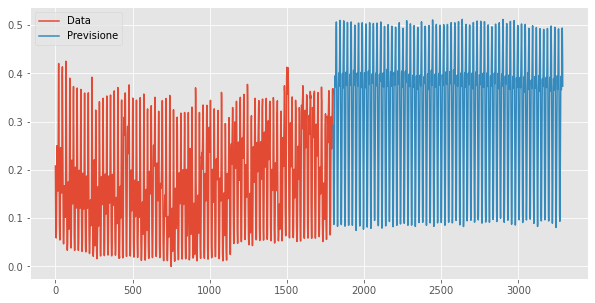

In [ ]:
forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

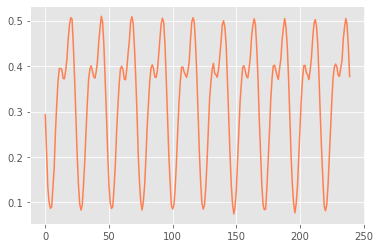

In [ ]:
plt.plot(forecasted[0][0:(24*10)], color = 'coral')

In [ ]:
table_result_LSTM = table_result_LSTM.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_LSTM.to_csv('drive/MyDrive/TimeSeries/table_result_LSTM.csv', index=False)
table_result_LSTM

,Model_CODE,MAE_TRAIN,MAE_TRAIN_ORIGINAL,MAE_VAL,MAE_VAL_ORIGINAL
0,32_dropout_02,0.146076,4474130.0,0.112961,3918752.25
1,32,0.082289,4474129.5,0.075181,3918752.00
2,64_dropout_02,0.081683,4474129.5,0.074138,3918751.50
3,100_dropout_02,0.080273,4474129.5,0.078601,3918752.00
4,128_dropout_02,0.078364,4474129.0,0.081457,3918751.50
5,128,0.144036,4474129.5,0.122763,3918752.00
6,128_dropout_02_lrbasso,0.348903,4474130.0,0.277452,3918752.25
7,128_dropout_02_lralto,0.078192,4474129.5,0.084853,3918752.00
8,512_dropout_02,0.099414,4474129.5,0.075203,3918752.00
9,512,0.096364,4474129.5,0.077260,3918752.00


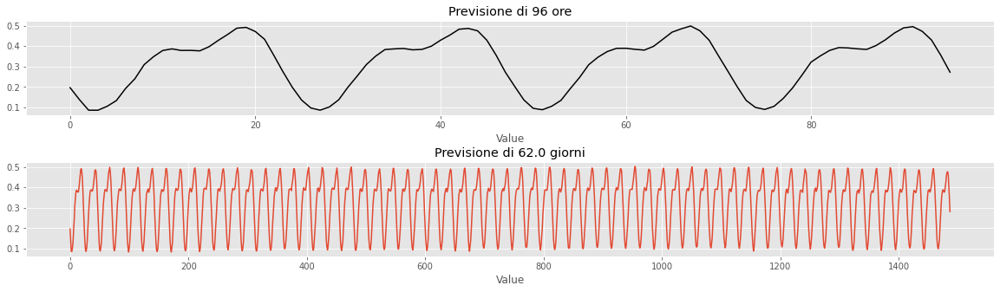

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### **** 2 mesi e 2 settimane prima -> 2 mesi dopo (128, senza dropout)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '2_mesi_2_sett_2'

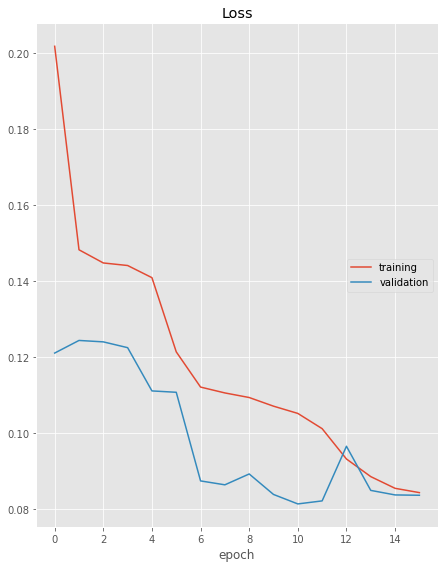

Loss
	training         	 (min:    0.084, max:    0.202, cur:    0.084)
	validation       	 (min:    0.081, max:    0.124, cur:    0.084)


 ***** EVALUATION WITHOUT SCALING ***** 


11/11 [==============================] - 0s 31ms/step - loss: 0.0814


 ***** EVALUATION WITH SCALING ***** 


11/11 [==============================] - 0s 30ms/step - loss: 3951274.5000


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
n_in, n_out = 24*(30+30+15), 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(128, input_shape=(n_in, n_features)))
model.add(Dense(trainY.shape[1]))

model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5)

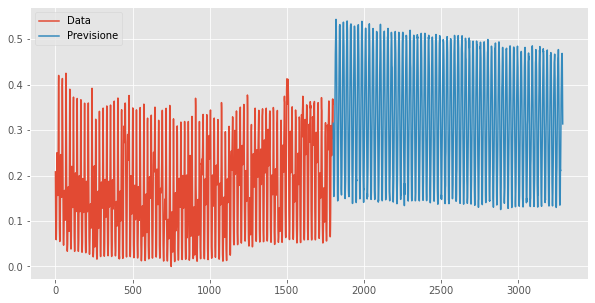

In [ ]:
forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

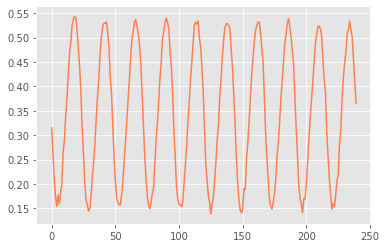

In [ ]:
plt.plot(forecasted[0][0:(24*10)], color = 'coral')

In [ ]:
table_result_LSTM = table_result_LSTM.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_LSTM.to_csv('drive/MyDrive/TimeSeries/table_result_LSTM.csv', index=False)
table_result_LSTM

,Model_CODE,MAE_TRAIN,MAE_TRAIN_ORIGINAL,MAE_VAL,MAE_VAL_ORIGINAL
0,32_dropout_02,0.146076,4474130.0,0.112961,3918752.25
1,32,0.082289,4474129.5,0.075181,3918752.00
2,64_dropout_02,0.081683,4474129.5,0.074138,3918751.50
3,100_dropout_02,0.080273,4474129.5,0.078601,3918752.00
4,128_dropout_02,0.078364,4474129.0,0.081457,3918751.50
5,128,0.144036,4474129.5,0.122763,3918752.00
6,128_dropout_02_lrbasso,0.348903,4474130.0,0.277452,3918752.25
7,128_dropout_02_lralto,0.078192,4474129.5,0.084853,3918752.00
8,512_dropout_02,0.099414,4474129.5,0.075203,3918752.00
9,512,0.096364,4474129.5,0.077260,3918752.00


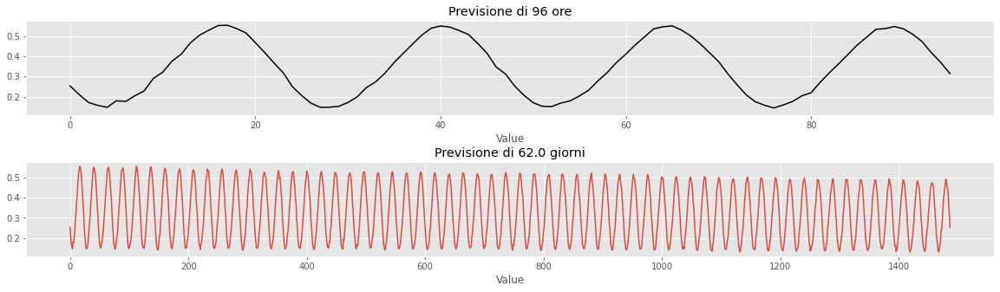

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### *****1 mese -> 2 mesi dopo (512 + dropout 0.2)***



In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '1_mese_1'

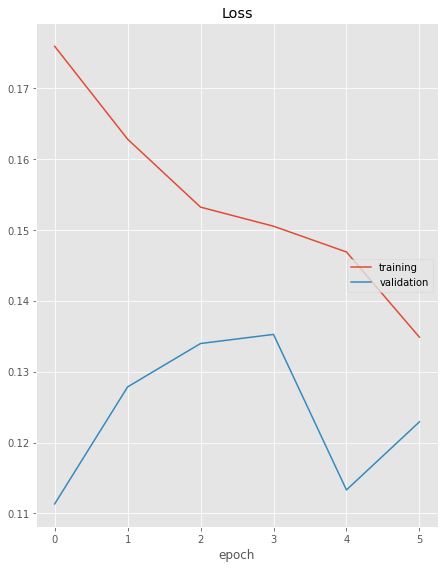

Loss
	training         	 (min:    0.135, max:    0.176, cur:    0.135)
	validation       	 (min:    0.111, max:    0.135, cur:    0.123)


 ***** EVALUATION WITHOUT SCALING ***** 


45/45 [==============================] - 2s 40ms/step - loss: 0.1113


 ***** EVALUATION WITH SCALING ***** 


45/45 [==============================] - 1s 33ms/step - loss: 3722806.5000


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
n_in, n_out = 24*(30), 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(512, input_shape=(n_in, n_features)))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))

model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5)

In [ ]:
# forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

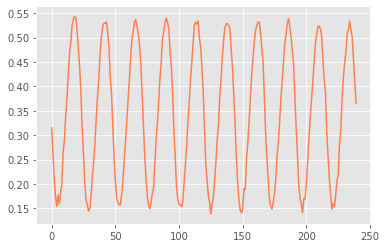

In [ ]:
plt.plot(forecasted[0][0:(24*10)], color = 'coral')

In [ ]:
table_result_LSTM = table_result_LSTM.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_LSTM.to_csv('drive/MyDrive/TimeSeries/table_result_LSTM.csv', index=False)
table_result_LSTM

,Model_CODE,MAE_TRAIN,MAE_TRAIN_ORIGINAL,MAE_VAL,MAE_VAL_ORIGINAL
0,32_dropout_02,0.146076,4474130.0,0.112961,3918752.25
1,32,0.082289,4474129.5,0.075181,3918752.00
2,64_dropout_02,0.081683,4474129.5,0.074138,3918751.50
3,100_dropout_02,0.080273,4474129.5,0.078601,3918752.00
4,128_dropout_02,0.078364,4474129.0,0.081457,3918751.50
5,128,0.144036,4474129.5,0.122763,3918752.00
6,128_dropout_02_lrbasso,0.348903,4474130.0,0.277452,3918752.25
7,128_dropout_02_lralto,0.078192,4474129.5,0.084853,3918752.00
8,512_dropout_02,0.099414,4474129.5,0.075203,3918752.00
9,512,0.096364,4474129.5,0.077260,3918752.00


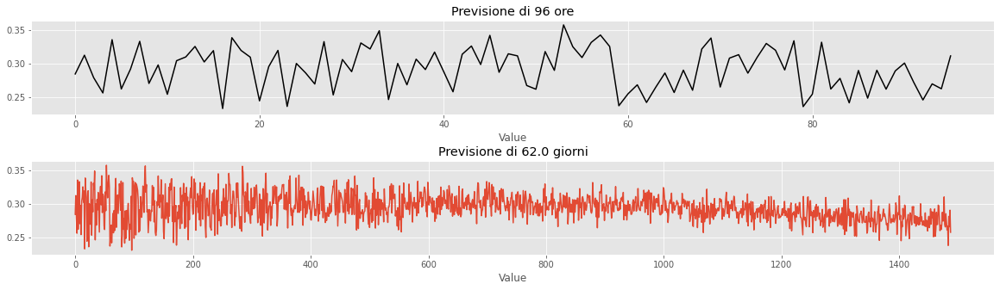

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### ***--2 settimane -> 2 mesi dopo (1000 + dropout 0.2)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '2_sett_1'

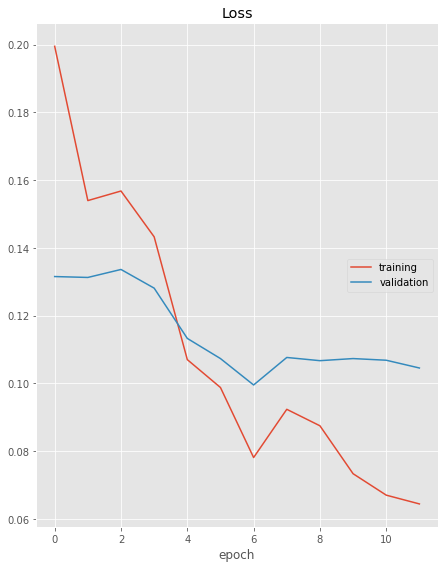

Loss
	training         	 (min:    0.064, max:    0.199, cur:    0.064)
	validation       	 (min:    0.100, max:    0.134, cur:    0.105)


 ***** EVALUATION WITHOUT SCALING ***** 


56/56 [==============================] - 2s 43ms/step - loss: 0.0995


 ***** EVALUATION WITH SCALING ***** 


56/56 [==============================] - 2s 41ms/step - loss: 3604482.2500


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
n_in, n_out = 24*(15), 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(1000, input_shape=(n_in, n_features)))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))

model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5, BATCH_SIZE = 32)

In [ ]:
# forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

In [ ]:
# plt.plot(forecasted[0][0:(24*10)], color = 'coral')

In [ ]:
table_result_LSTM = table_result_LSTM.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_LSTM.to_csv('drive/MyDrive/TimeSeries/table_result_LSTM.csv', index=False)
table_result_LSTM

,Model_CODE,MAE_TRAIN,MAE_TRAIN_ORIGINAL,MAE_VAL,MAE_VAL_ORIGINAL
0,32_dropout_02,0.146076,4474130.0,0.112961,3918752.25
1,32,0.082289,4474129.5,0.075181,3918752.00
2,64_dropout_02,0.081683,4474129.5,0.074138,3918751.50
3,100_dropout_02,0.080273,4474129.5,0.078601,3918752.00
4,128_dropout_02,0.078364,4474129.0,0.081457,3918751.50
5,128,0.144036,4474129.5,0.122763,3918752.00
6,128_dropout_02_lrbasso,0.348903,4474130.0,0.277452,3918752.25
7,128_dropout_02_lralto,0.078192,4474129.5,0.084853,3918752.00
8,512_dropout_02,0.099414,4474129.5,0.075203,3918752.00
9,512,0.096364,4474129.5,0.077260,3918752.00


In [ ]:
table_result_LSTM.to_csv('drive/MyDrive/TimeSeries/table_result_LSTM.csv')

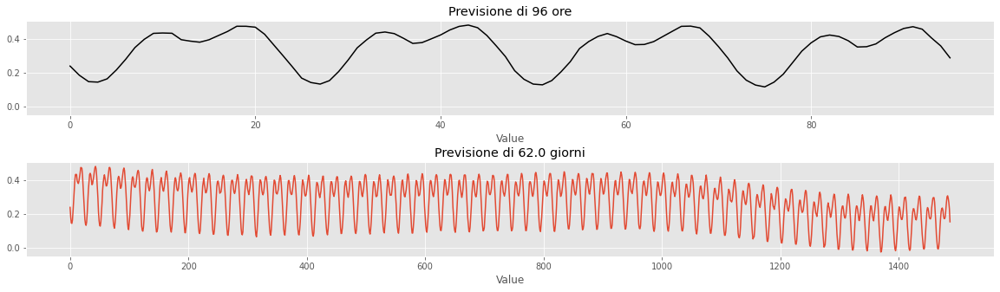

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### ***--2 settimane -> 2 mesi dopo (1000, senza dropout)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '2_sett_2'

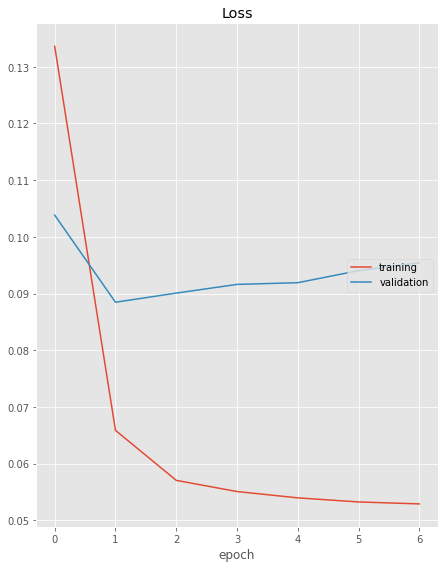

Loss
	training         	 (min:    0.053, max:    0.134, cur:    0.053)
	validation       	 (min:    0.088, max:    0.104, cur:    0.095)


 ***** EVALUATION WITHOUT SCALING ***** 


56/56 [==============================] - 2s 44ms/step - loss: 0.0885


 ***** EVALUATION WITH SCALING ***** 


56/56 [==============================] - 2s 41ms/step - loss: 3604482.2500


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
n_in, n_out = 24*(15), 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(1000, input_shape=(n_in, n_features)))
model.add(Dense(trainY.shape[1]))

model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5, BATCH_SIZE = 32)

In [ ]:
# forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

In [ ]:
# plt.plot(forecasted[0][0:(24*10)], color = 'coral')

In [ ]:
table_result_LSTM = table_result_LSTM.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_LSTM.to_csv('drive/MyDrive/TimeSeries/table_result_LSTM.csv', index=False)
table_result_LSTM

,Model_CODE,MAE_TRAIN,MAE_TRAIN_ORIGINAL,MAE_VAL,MAE_VAL_ORIGINAL
0,32_dropout_02,0.146076,4474130.0,0.112961,3918752.25
1,32,0.082289,4474129.5,0.075181,3918752.00
2,64_dropout_02,0.081683,4474129.5,0.074138,3918751.50
3,100_dropout_02,0.080273,4474129.5,0.078601,3918752.00
4,128_dropout_02,0.078364,4474129.0,0.081457,3918751.50
5,128,0.144036,4474129.5,0.122763,3918752.00
6,128_dropout_02_lrbasso,0.348903,4474130.0,0.277452,3918752.25
7,128_dropout_02_lralto,0.078192,4474129.5,0.084853,3918752.00
8,512_dropout_02,0.099414,4474129.5,0.075203,3918752.00
9,512,0.096364,4474129.5,0.077260,3918752.00


In [ ]:
table_result_LSTM.to_csv('drive/MyDrive/TimeSeries/table_result_LSTM.csv')

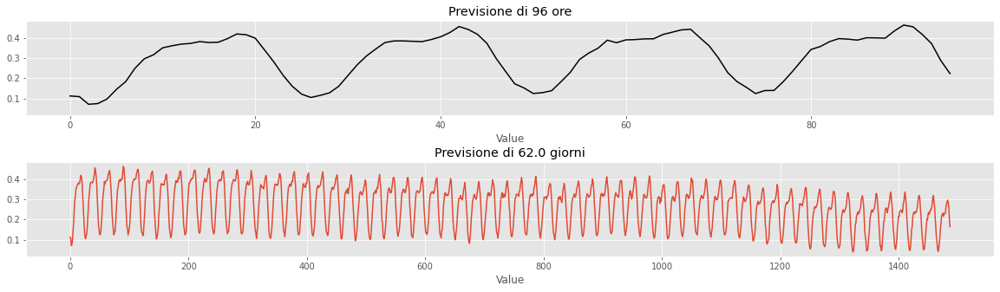

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### ***--2 settimane -> 2 mesi dopo (2000, senza dropout)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '2_sett_3'

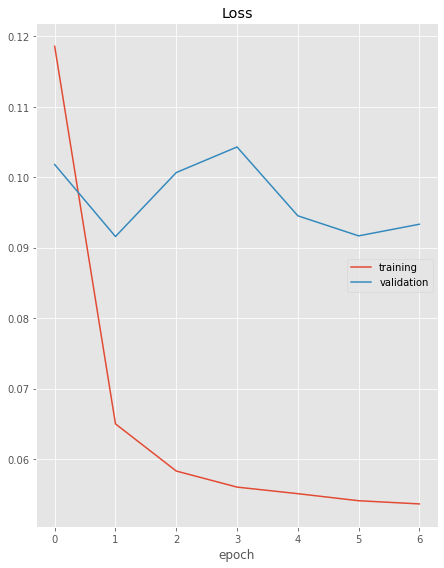

Loss
	training         	 (min:    0.054, max:    0.119, cur:    0.054)
	validation       	 (min:    0.092, max:    0.104, cur:    0.093)


 ***** EVALUATION WITHOUT SCALING ***** 


56/56 [==============================] - 10s 171ms/step - loss: 0.0916


 ***** EVALUATION WITH SCALING ***** 


56/56 [==============================] - 8s 145ms/step - loss: 3604482.2500


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
n_in, n_out = 24*(15), 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(2000, input_shape=(n_in, n_features)))
model.add(Dense(trainY.shape[1]))

model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5, BATCH_SIZE = 32)

In [ ]:
# forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

In [ ]:
# plt.plot(forecasted[0][0:(24*10)], color = 'coral')

In [ ]:
table_result_LSTM = table_result_LSTM.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_LSTM.to_csv('drive/MyDrive/TimeSeries/table_result_LSTM.csv', index=False)
table_result_LSTM

,Model_CODE,MAE_TRAIN,MAE_TRAIN_ORIGINAL,MAE_VAL,MAE_VAL_ORIGINAL
0,32_dropout_02,0.146076,4474130.0,0.112961,3918752.25
1,32,0.082289,4474129.5,0.075181,3918752.00
2,64_dropout_02,0.081683,4474129.5,0.074138,3918751.50
3,100_dropout_02,0.080273,4474129.5,0.078601,3918752.00
4,128_dropout_02,0.078364,4474129.0,0.081457,3918751.50
5,128,0.144036,4474129.5,0.122763,3918752.00
6,128_dropout_02_lrbasso,0.348903,4474130.0,0.277452,3918752.25
7,128_dropout_02_lralto,0.078192,4474129.5,0.084853,3918752.00
8,512_dropout_02,0.099414,4474129.5,0.075203,3918752.00
9,512,0.096364,4474129.5,0.077260,3918752.00


In [ ]:
table_result_LSTM.to_csv('drive/MyDrive/TimeSeries/table_result_LSTM.csv')

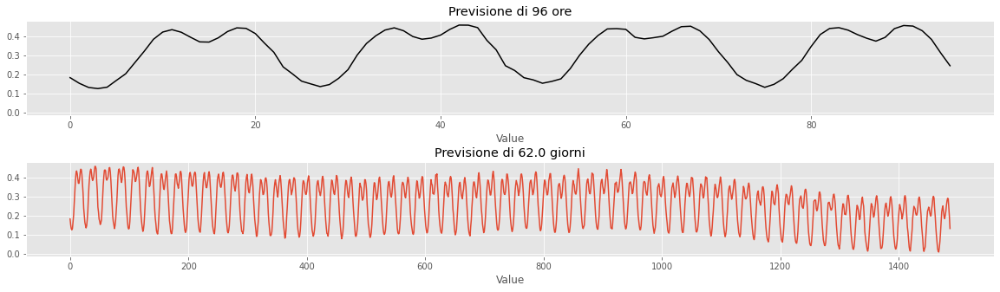

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### ***--2 settimane -> 2 mesi dopo (2000 + dropout 0.2)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '2_sett_4'

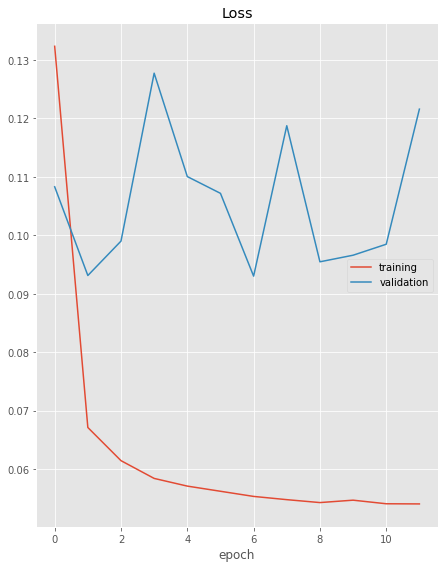

Loss
	training         	 (min:    0.054, max:    0.132, cur:    0.054)
	validation       	 (min:    0.093, max:    0.128, cur:    0.122)


 ***** EVALUATION WITHOUT SCALING ***** 


56/56 [==============================] - 9s 170ms/step - loss: 0.0930


 ***** EVALUATION WITH SCALING ***** 


56/56 [==============================] - 8s 140ms/step - loss: 3604482.5000


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
n_in, n_out = 24*(15), 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(2000, input_shape=(n_in, n_features)))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))

model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5, BATCH_SIZE = 32)

In [ ]:
# forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

In [ ]:
# plt.plot(forecasted[0][0:(24*10)], color = 'coral')

In [ ]:
table_result_LSTM = table_result_LSTM.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_LSTM.to_csv('drive/MyDrive/TimeSeries/table_result_LSTM.csv', index=False)
table_result_LSTM

,Model_CODE,MAE_TRAIN,MAE_TRAIN_ORIGINAL,MAE_VAL,MAE_VAL_ORIGINAL
0,32_dropout_02,0.146076,4474130.0,0.112961,3918752.25
1,32,0.082289,4474129.5,0.075181,3918752.00
2,64_dropout_02,0.081683,4474129.5,0.074138,3918751.50
3,100_dropout_02,0.080273,4474129.5,0.078601,3918752.00
4,128_dropout_02,0.078364,4474129.0,0.081457,3918751.50
5,128,0.144036,4474129.5,0.122763,3918752.00
6,128_dropout_02_lrbasso,0.348903,4474130.0,0.277452,3918752.25
7,128_dropout_02_lralto,0.078192,4474129.5,0.084853,3918752.00
8,512_dropout_02,0.099414,4474129.5,0.075203,3918752.00
9,512,0.096364,4474129.5,0.077260,3918752.00


In [ ]:
table_result_LSTM.to_csv('drive/MyDrive/TimeSeries/table_result_LSTM.csv')

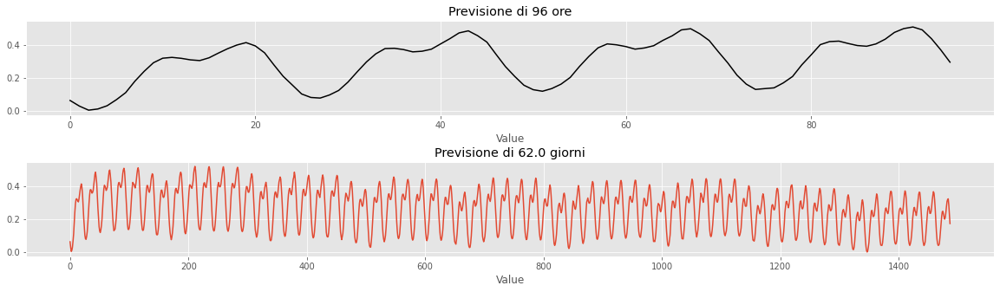

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

### ***MODELS -- GRU***

In [ ]:
table_result_GRU = pd.DataFrame(columns=['Model_CODE', 'MAE_VAL', 'MAE_VAL_ORIGINAL'])

#### ***--- 2 mesi prima -> 2 mesi dopo (32 units + dropout 0.2)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '32_dropout_02'

In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
# window in and out for the supervised forecast.
n_in, n_out = 24*62, 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )




 ***** DATA PREPARATION ***** 


trainX shape: (10920, 1488)
trainY shape: (10920, 1488)
valX shape: (650, 1488)
valY shape: (650, 1488)


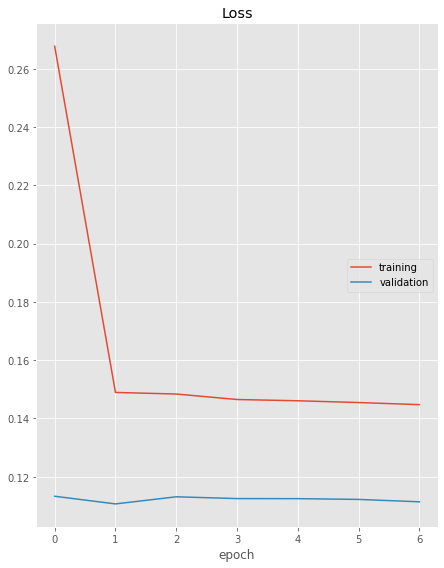

Loss
	training         	 (min:    0.145, max:    0.268, cur:    0.145)
	validation       	 (min:    0.111, max:    0.113, cur:    0.111)


 ***** EVALUATION WITHOUT SCALING ***** 


21/21 [==============================] - 2s 94ms/step - loss: 0.1107


 ***** EVALUATION WITH SCALING ***** 


21/21 [==============================] - 2s 79ms/step - loss: 3918751.5000


In [ ]:
print("\n\n ***** MODELING ***** \n\n")
# define the LSTM architecture.
model = Sequential()
if len(tf.config.list_physical_devices('GPU'))==0:
  model.add(GRU(32, input_shape=(n_in, n_features)))
else:
  model.add(CuDNNGRU(32, input_shape=(n_in, n_features)))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5)

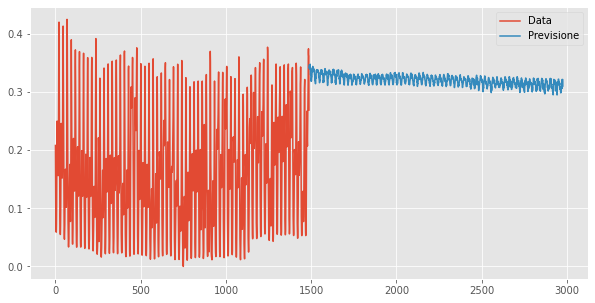

In [ ]:
forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

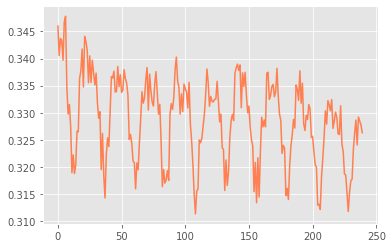

In [ ]:
plt.plot(forecasted[0][0:(24*10)], color = 'coral')

In [ ]:
table_result_GRU = table_result_GRU.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_GRU.to_csv('drive/MyDrive/TimeSeries/table_result_GRU.csv', index=False)
table_result_GRU

,Model_CODE,MAE_VAL,MAE_VAL_ORIGINAL,MAE_TRAIN,MAE_TRAIN_ORIGINAL
0,32_dropout_02,0.110673,3918751.5,0.143212,4474129.5


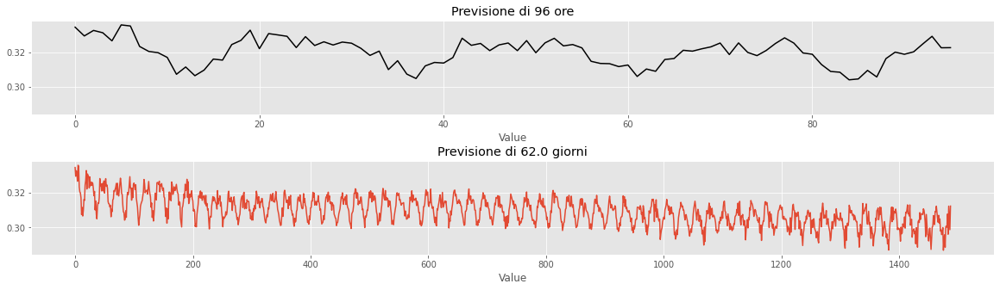

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

In [ ]:
# come viene calcolato l'errore? Come la media dei mae delle finestre. 
my_mae = []

for i in tqdm(range(valX.shape[0])):
  yhat = model.predict(np.expand_dims(valX[i], axis = 0))[0]
  my_mae.append(mae(yhat, valY[i]))

np.mean(my_mae), model.evaluate(valX, valY, verbose=0)

100%|██████████| 650/650 [01:12<00:00,  8.98it/s]


(0.11067277229381003, 0.11067277193069458)

#### ***--- 2 mesi prima -> 2 mesi dopo (32 units, no dropout)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '32'

In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
# window in and out for the supervised forecast.
n_in, n_out = 24*62, 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )




 ***** DATA PREPARATION ***** 


trainX shape: (10920, 1488)
trainY shape: (10920, 1488)
valX shape: (650, 1488)
valY shape: (650, 1488)


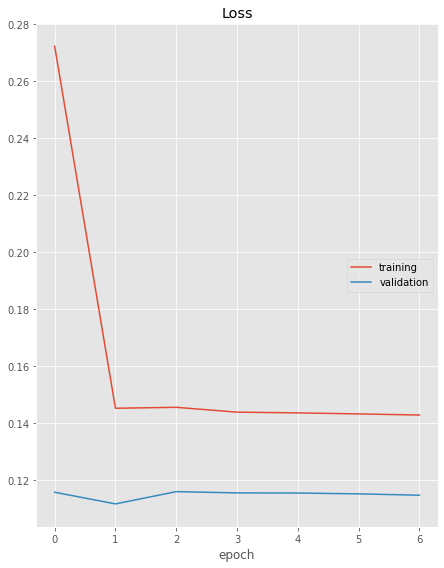

Loss
	training         	 (min:    0.143, max:    0.272, cur:    0.143)
	validation       	 (min:    0.112, max:    0.116, cur:    0.115)


 ***** EVALUATION WITHOUT SCALING ***** 


21/21 [==============================] - 2s 79ms/step - loss: 0.1117


 ***** EVALUATION WITH SCALING ***** 


21/21 [==============================] - 2s 79ms/step - loss: 3918751.5000


In [ ]:
print("\n\n ***** MODELING ***** \n\n")
# define the LSTM architecture.
model = Sequential()
if len(tf.config.list_physical_devices('GPU'))==0:
  model.add(GRU(32, input_shape=(n_in, n_features)))
else:
  model.add(CuDNNGRU(32, input_shape=(n_in, n_features)))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5)

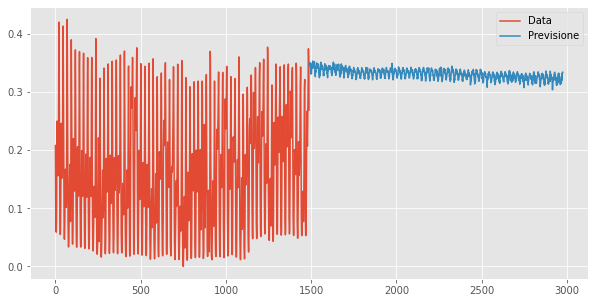

In [ ]:
forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

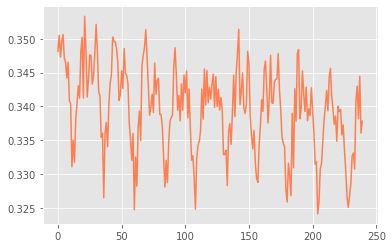

In [ ]:
plt.plot(forecasted[0][0:(24*10)], color = 'coral')

In [ ]:
table_result_GRU = table_result_GRU.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_GRU.to_csv('drive/MyDrive/TimeSeries/table_result_GRU.csv', index=False)
table_result_GRU

,Model_CODE,MAE_VAL,MAE_VAL_ORIGINAL,MAE_TRAIN,MAE_TRAIN_ORIGINAL
0,32_dropout_02,0.110673,3918751.5,0.143212,4474129.5
1,32,0.111654,3918751.5,0.142433,4474129.5


In [ ]:
table_result_GRU.to_csv('drive/MyDrive/TimeSeries/table_result_GRU.csv', index=False)

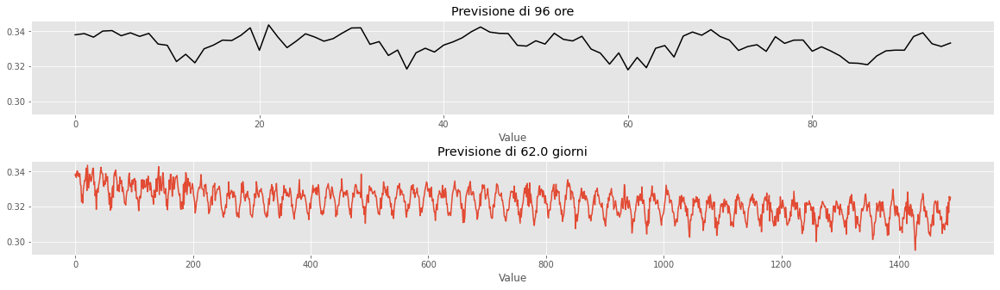

In [ ]:
plot_test_predictions(model, val, n_in, n_out)
# il pattern giornaliero non viene catturato completamente ma solo il suo andamento.

#### ***--- 2 mesi prima -> 2 mesi dopo (64 units + dropout 0.2)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '64_dropout_02'

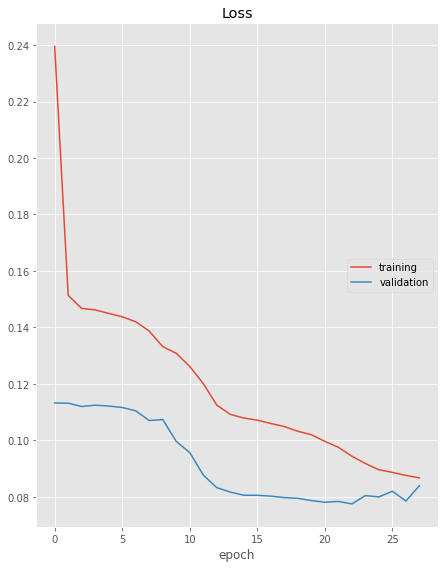

Loss
	training         	 (min:    0.087, max:    0.240, cur:    0.087)
	validation       	 (min:    0.077, max:    0.113, cur:    0.084)


 ***** EVALUATION WITHOUT SCALING ***** 


21/21 [==============================] - 2s 97ms/step - loss: 0.0775


 ***** EVALUATION WITH SCALING ***** 


21/21 [==============================] - 2s 86ms/step - loss: 3918751.5000


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
# window in and out for the supervised forecast.
n_in, n_out = 24*62, 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
del model 
# define the LSTM architecture.
model = Sequential()
if len(tf.config.list_physical_devices('GPU'))==0:
  model.add(GRU(64, input_shape=(n_in, n_features)))
else:
  model.add(CuDNNGRU(64, input_shape=(n_in, n_features)))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5)

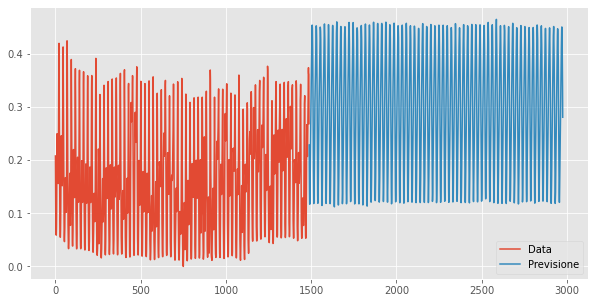

In [ ]:
forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

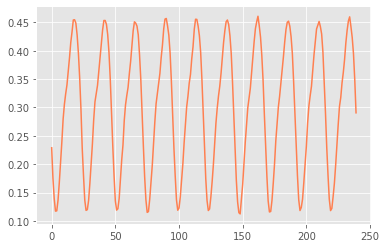

In [ ]:
plt.plot(forecasted[0][0:(24*10)], color = 'coral')

In [ ]:
table_result_GRU = table_result_GRU.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_GRU.to_csv('drive/MyDrive/TimeSeries/table_result_GRU.csv', index=False)
table_result_GRU

,Model_CODE,MAE_VAL,MAE_VAL_ORIGINAL,MAE_TRAIN,MAE_TRAIN_ORIGINAL
0,32_dropout_02,0.110673,3918751.5,0.143212,4474129.5
1,32,0.111654,3918751.5,0.142433,4474129.5
2,64_dropout_02,0.077487,3918751.5,0.081131,4474129.0


In [ ]:
table_result_GRU.to_csv('drive/MyDrive/TimeSeries/table_result_GRU.csv', index=False)

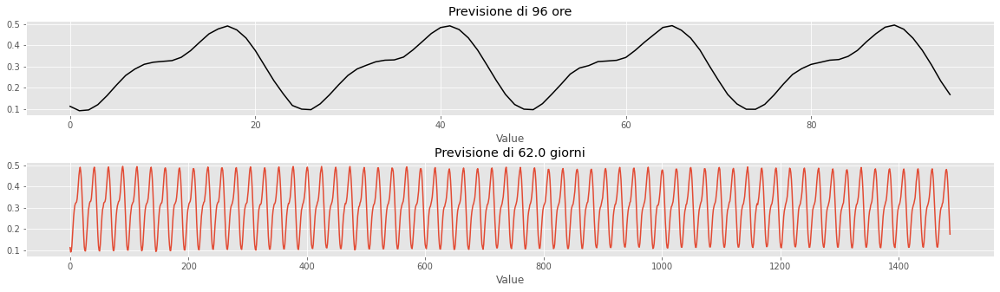

In [ ]:
plot_test_predictions(model, val, n_in, n_out) 

#### ***--- 2 mesi prima -> 2 mesi dopo (100 units + dropout 0.2)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '100_dropout_02'

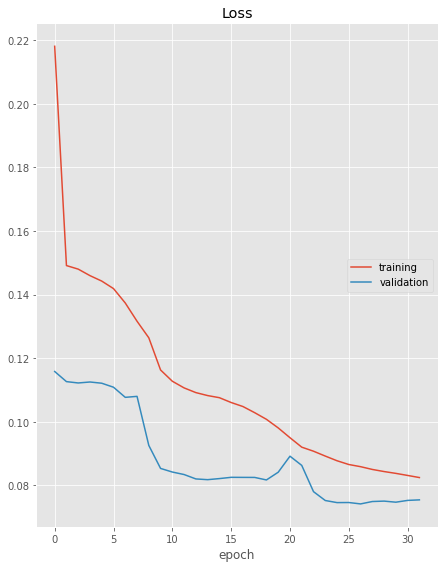

Loss
	training         	 (min:    0.082, max:    0.218, cur:    0.082)
	validation       	 (min:    0.074, max:    0.116, cur:    0.075)


 ***** EVALUATION WITHOUT SCALING ***** 


21/21 [==============================] - 2s 90ms/step - loss: 0.0741


 ***** EVALUATION WITH SCALING ***** 


21/21 [==============================] - 2s 101ms/step - loss: 3918751.5000


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
# window in and out for the supervised forecast.
n_in, n_out = 24*62, 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# del model 
# define the LSTM architecture.
model = Sequential()
if len(tf.config.list_physical_devices('GPU')) == 0:
  model.add(GRU(100, input_shape=(n_in, n_features)))
else:
  model.add(CuDNNGRU(100, input_shape=(n_in, n_features)))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5)

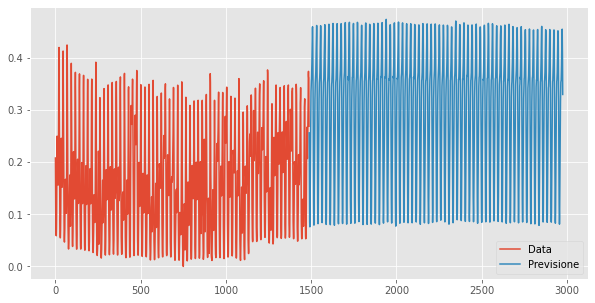

In [ ]:
forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

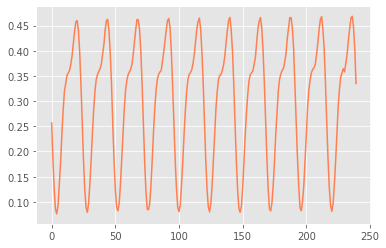

In [ ]:
plt.plot(forecasted[0][0:(24*10)], color = 'coral')

In [ ]:
table_result_GRU = table_result_GRU.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_GRU.to_csv('drive/MyDrive/TimeSeries/table_result_GRU.csv', index=False)

In [ ]:
table_result_GRU

,Model_CODE,MAE_VAL,MAE_VAL_ORIGINAL,MAE_TRAIN,MAE_TRAIN_ORIGINAL
0,32_dropout_02,0.110673,3918751.5,0.143212,4474129.5
1,32,0.111654,3918751.5,0.142433,4474129.5
2,64_dropout_02,0.077487,3918751.5,0.081131,4474129.0
4,100_dropout_02,0.074149,3918751.5,0.074602,4474129.0


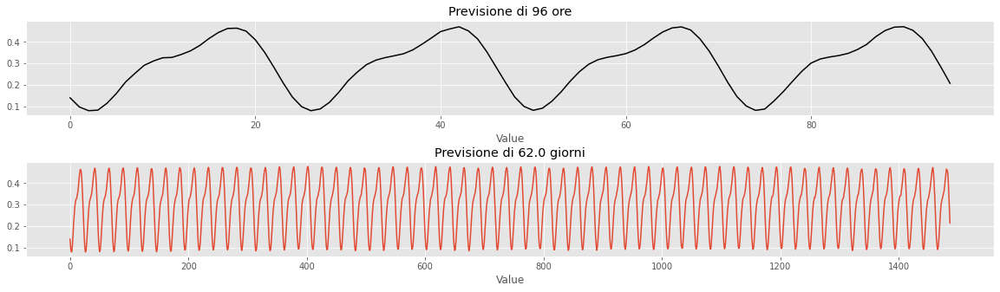

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

# l'andamento giornaliero viene catturato maggiormente rispetto al caso precedente: una rete
# troppo piccola probabilmente non funziona bene sui nostri dati. 

#### ***--- 2 mesi prima -> 2 mesi dopo (128 units + dropout 0.2)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '128_dropout_02'

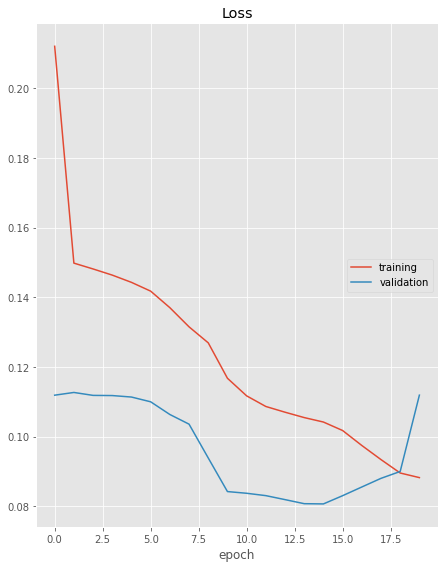

Loss
	training         	 (min:    0.088, max:    0.212, cur:    0.088)
	validation       	 (min:    0.081, max:    0.113, cur:    0.112)


 ***** EVALUATION WITHOUT SCALING ***** 


21/21 [==============================] - 2s 89ms/step - loss: 0.0807


 ***** EVALUATION WITH SCALING ***** 


21/21 [==============================] - 2s 98ms/step - loss: 3918751.5000


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
# window in and out for the supervised forecast.
n_in, n_out = 24*62, 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
del model 
# define the LSTM architecture.
model = Sequential()
if len(tf.config.list_physical_devices('GPU')) == 0:
  model.add(GRU(128, input_shape=(n_in, n_features)))
else:
  model.add(CuDNNGRU(128, input_shape=(n_in, n_features)))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5)

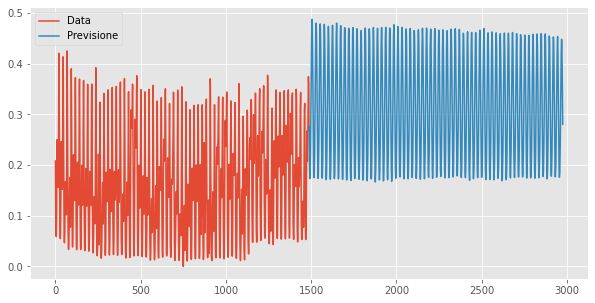

In [ ]:
forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

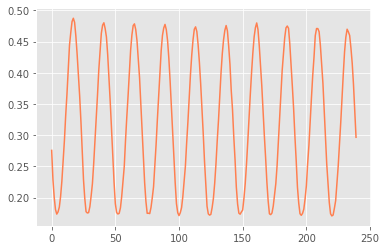

In [ ]:
plt.plot(forecasted[0][0:(24*10)], color = 'coral')

In [ ]:
table_result_GRU = table_result_GRU.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_GRU.to_csv('drive/MyDrive/TimeSeries/table_result_GRU.csv', index=False)
table_result_GRU

,Model_CODE,MAE_VAL,MAE_VAL_ORIGINAL,MAE_TRAIN,MAE_TRAIN_ORIGINAL
0,32_dropout_02,0.110673,3918751.5,0.143212,4474129.5
1,32,0.111654,3918751.5,0.142433,4474129.5
2,64_dropout_02,0.077487,3918751.5,0.081131,4474129.0
3,100_dropout_02,0.074149,3918751.5,0.074602,4474129.0
4,128_dropout_02,0.080684,3918751.5,0.092399,4474129.0


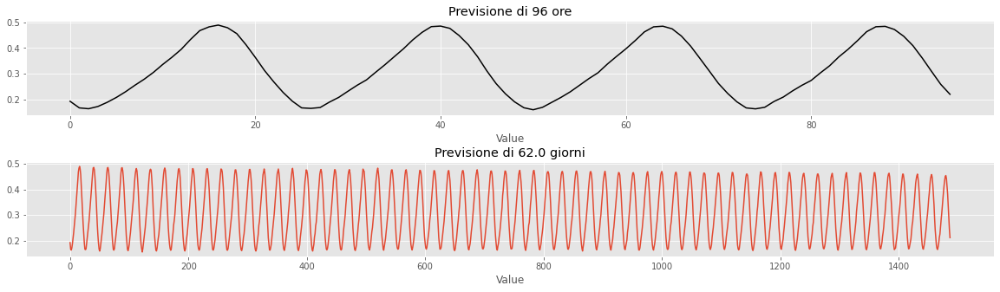

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### ***--- 2 mesi prima -> 2 mesi dopo (128 units, no dropout)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '128'

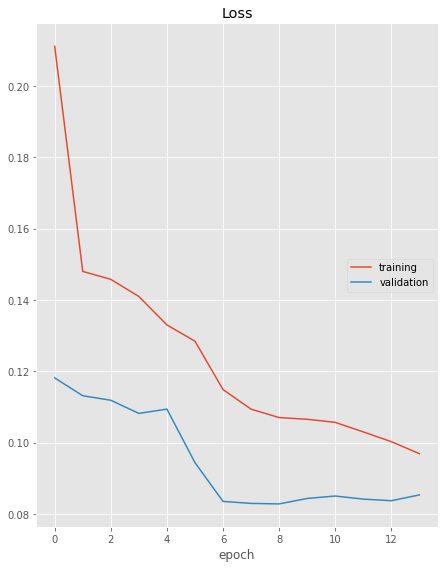

Loss
	training         	 (min:    0.097, max:    0.211, cur:    0.097)
	validation       	 (min:    0.083, max:    0.118, cur:    0.085)


 ***** EVALUATION WITHOUT SCALING ***** 


21/21 [==============================] - 2s 96ms/step - loss: 0.0828


 ***** EVALUATION WITH SCALING ***** 


21/21 [==============================] - 2s 96ms/step - loss: 3918751.5000


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
# window in and out for the supervised forecast.
n_in, n_out = 24*62, 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
del model 
# define the LSTM architecture.
model = Sequential()
if len(tf.config.list_physical_devices('GPU')) == 0:
  model.add(GRU(128, input_shape=(n_in, n_features)))
else:
  model.add(CuDNNGRU(128, input_shape=(n_in, n_features)))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5)

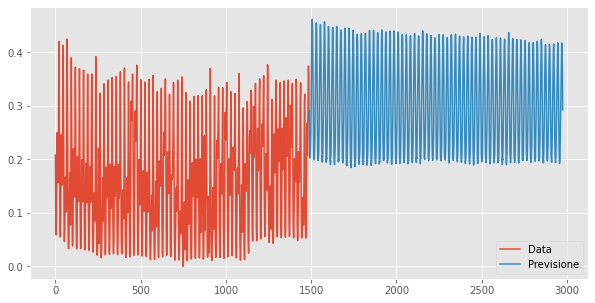

In [ ]:
forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

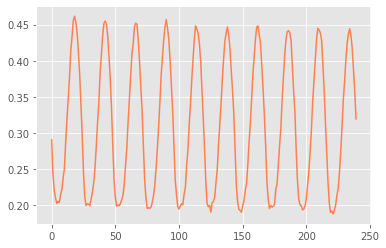

In [ ]:
plt.plot(forecasted[0][0:(24*10)], color = 'coral')

In [ ]:
table_result_GRU = table_result_GRU.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_GRU.to_csv('drive/MyDrive/TimeSeries/table_result_GRU.csv', index=False)
table_result_GRU

,Model_CODE,MAE_VAL,MAE_VAL_ORIGINAL,MAE_TRAIN,MAE_TRAIN_ORIGINAL
0,32_dropout_02,0.110673,3918751.5,0.143212,4474129.5
1,32,0.111654,3918751.5,0.142433,4474129.5
2,64_dropout_02,0.077487,3918751.5,0.081131,4474129.0
3,100_dropout_02,0.074149,3918751.5,0.074602,4474129.0
4,128_dropout_02,0.080684,3918751.5,0.092399,4474129.0
5,128,0.082782,3918751.5,0.099508,4474129.0


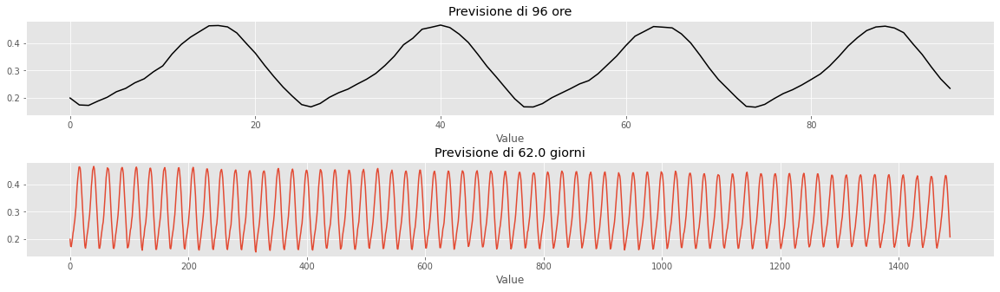

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### ***--- 2 mesi prima -> 2 mesi dopo (128 unità + dropout 0.2, lr basso)***

In [ ]:
# constants.
LR = 1e-6
CLIPVALUE = 0.5
MODEL_CODE = '128_dropout_02_lrbasso'

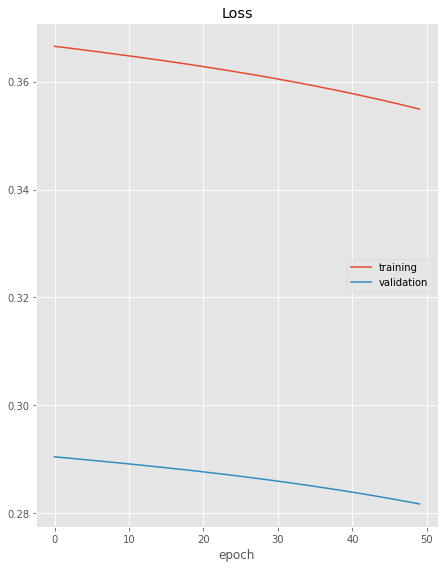

Loss
	training         	 (min:    0.355, max:    0.367, cur:    0.355)
	validation       	 (min:    0.282, max:    0.290, cur:    0.282)


 ***** EVALUATION WITHOUT SCALING ***** 


21/21 [==============================] - 2s 95ms/step - loss: 0.2817


 ***** EVALUATION WITH SCALING ***** 


21/21 [==============================] - 2s 94ms/step - loss: 3918752.2500


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
# window in and out for the supervised forecast.
n_in, n_out = 24*62, 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
del model 
# define the LSTM architecture.
model = Sequential()
if len(tf.config.list_physical_devices('GPU')) == 0:
  model.add(GRU(128, input_shape=(n_in, n_features)))
else:
  model.add(CuDNNGRU(128, input_shape=(n_in, n_features)))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 50, PATIENCE = 5)

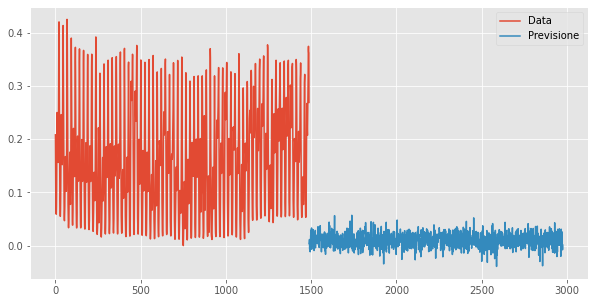

In [ ]:
forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

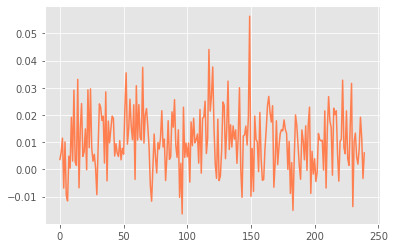

In [ ]:
plt.plot(forecasted[0][0:(24*10)], color = 'coral')

In [ ]:
table_result_GRU = table_result_GRU.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_GRU.to_csv('drive/MyDrive/TimeSeries/table_result_GRU.csv', index=False)
table_result_GRU

,Model_CODE,MAE_VAL,MAE_VAL_ORIGINAL
0,32_dropout_02,0.071667,3918751.50
1,32,0.071038,3918751.50
2,64_dropout_02,0.072754,3918751.50
3,100_dropout_02,0.081503,3918751.50
4,128_dropout_02,0.074159,3918751.50
5,128,0.083500,3918751.50
6,128_dropout_02_lrbasso,0.280138,3918752.25


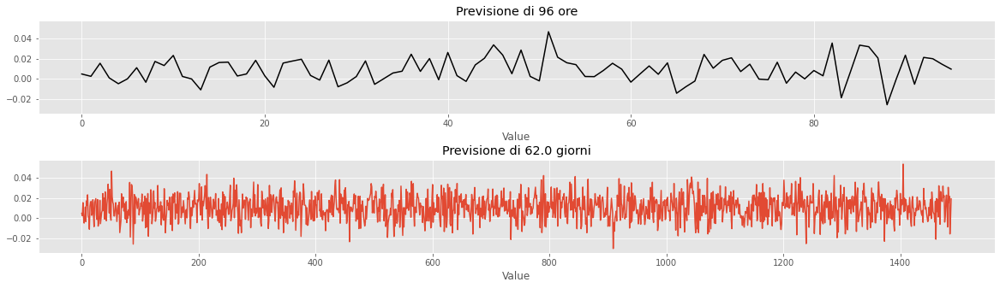

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### ***--- 2 mesi prima -> 2 mesi dopo (128 unità + dropout 0.2, lr alto)***

In [ ]:
# constants.
# LR = 1e-1 produce nan nelle ultime epoche.
LR = 1e-2
CLIPVALUE = 0.5
MODEL_CODE = '128_dropout_02_lralto'

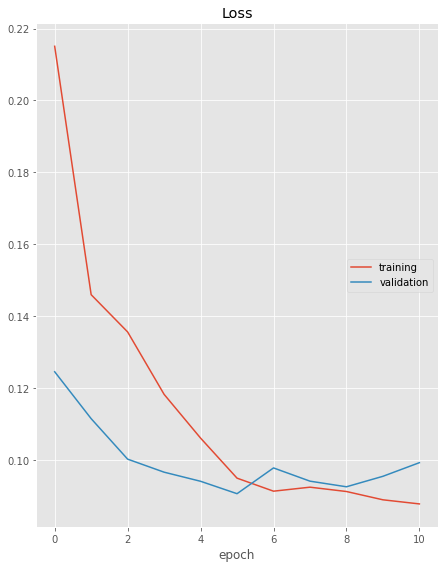

Loss
	training         	 (min:    0.088, max:    0.215, cur:    0.088)
	validation       	 (min:    0.091, max:    0.125, cur:    0.099)


 ***** EVALUATION WITHOUT SCALING ***** 


21/21 [==============================] - 2s 97ms/step - loss: 0.0906


 ***** EVALUATION WITH SCALING ***** 


21/21 [==============================] - 2s 95ms/step - loss: 3918752.0000


In [ ]:
# print("\n\n ***** DATA PREPARATION ***** \n\n")
# window in and out for the supervised forecast.
n_in, n_out = 24*62, 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# del model 
# define the LSTM architecture.
model = Sequential()
if len(tf.config.list_physical_devices('GPU')) == 0:
  model.add(GRU(128, input_shape=(n_in, n_features)))
else:
  model.add(CuDNNGRU(128, input_shape=(n_in, n_features)))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5)

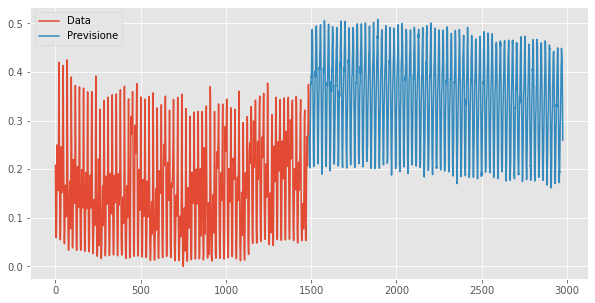

In [ ]:
forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

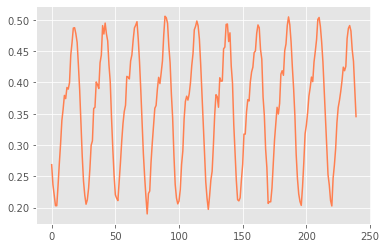

In [ ]:
plt.plot(forecasted[0][0:(24*10)], color = 'coral')

In [ ]:
table_result_GRU = table_result_GRU.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_GRU.to_csv('drive/MyDrive/TimeSeries/table_result_GRU.csv', index=False)
table_result_GRU

,Model_CODE,MAE_VAL,MAE_VAL_ORIGINAL,MAE_TRAIN,MAE_TRAIN_ORIGINAL
0,32_dropout_02,0.110673,3918751.5,0.143212,4474129.5
1,32,0.111654,3918751.5,0.142433,4474129.5
2,64_dropout_02,0.077487,3918751.5,0.081131,4474129.0
3,100_dropout_02,0.074149,3918751.5,0.074602,4474129.0
4,128_dropout_02,0.080684,3918751.5,0.092399,4474129.0
5,128,0.082782,3918751.5,0.099508,4474129.0
6,128_dropout_02_lralto,0.090588,3918752.0,0.083803,4474129.5


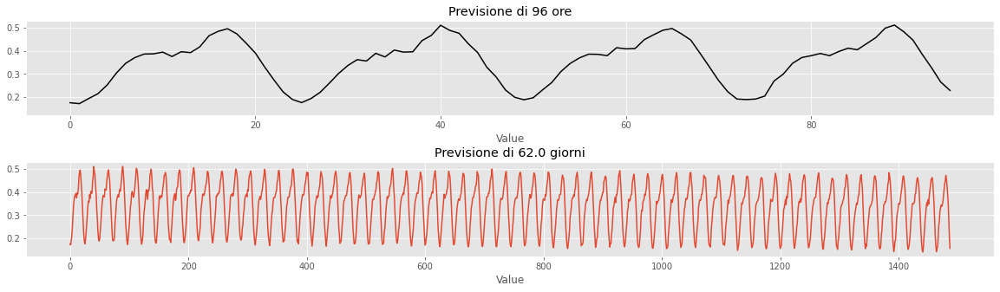

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### ***--- 2 mesi prima -> 2 mesi dopo (512 units + dropout 0.2)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '512_dropout_02'

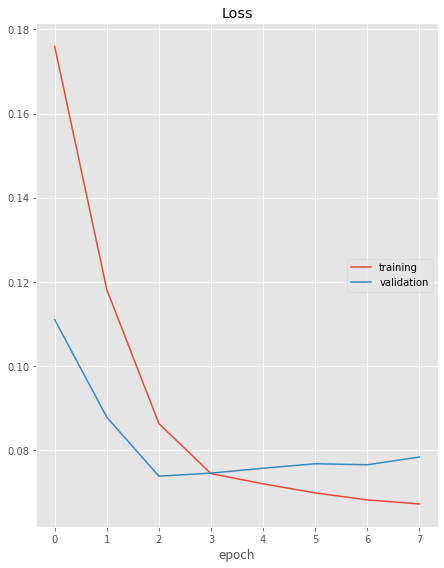

Loss
	training         	 (min:    0.067, max:    0.176, cur:    0.067)
	validation       	 (min:    0.074, max:    0.111, cur:    0.078)


 ***** EVALUATION WITHOUT SCALING ***** 


21/21 [==============================] - 4s 163ms/step - loss: 0.0738


 ***** EVALUATION WITH SCALING ***** 


21/21 [==============================] - 3s 158ms/step - loss: 3918751.5000


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
# window in and out for the supervised forecast.
n_in, n_out = 24*62, 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# del model 
# define the LSTM architecture.
model = Sequential()
if len(tf.config.list_physical_devices('GPU')) == 0:
  model.add(GRU(512, input_shape=(n_in, n_features)))
else:
  model.add(CuDNNGRU(512, input_shape=(n_in, n_features)))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5, BATCH_SIZE = 64)

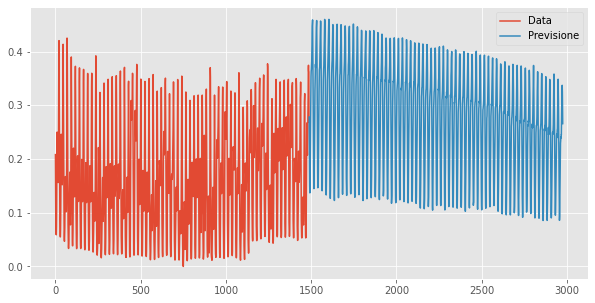

In [ ]:
forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

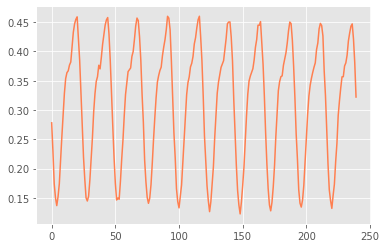

In [ ]:
plt.plot(forecasted[0][0:(24*10)], color = 'coral')

In [ ]:
table_result_GRU = table_result_GRU.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_GRU.to_csv('drive/MyDrive/TimeSeries/table_result_GRU.csv', index=False)
table_result_GRU

,Model_CODE,MAE_VAL,MAE_VAL_ORIGINAL,MAE_TRAIN,MAE_TRAIN_ORIGINAL
0,32_dropout_02,0.110673,3918751.5,0.143212,4474129.5
1,32,0.111654,3918751.5,0.142433,4474129.5
2,64_dropout_02,0.077487,3918751.5,0.081131,4474129.0
3,100_dropout_02,0.074149,3918751.5,0.074602,4474129.0
4,128_dropout_02,0.080684,3918751.5,0.092399,4474129.0
5,128,0.082782,3918751.5,0.099508,4474129.0
6,128_dropout_02_lralto,0.090588,3918752.0,0.083803,4474129.5
7,512_dropout_02,0.073788,3918751.5,0.096445,4474129.0


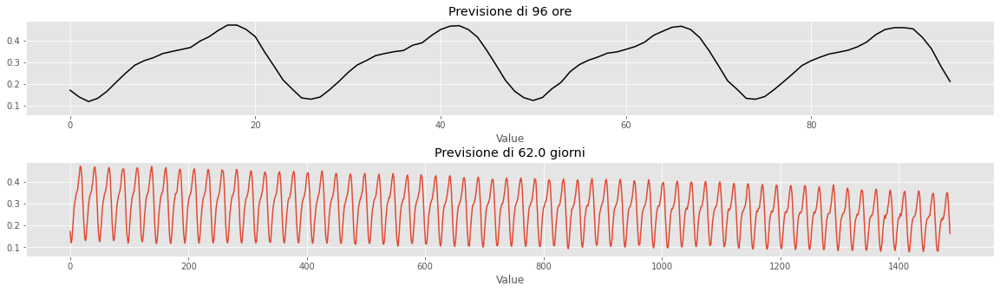

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### ***--- 2 mesi prima -> 2 mesi dopo (512 units, no dropout)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '512'

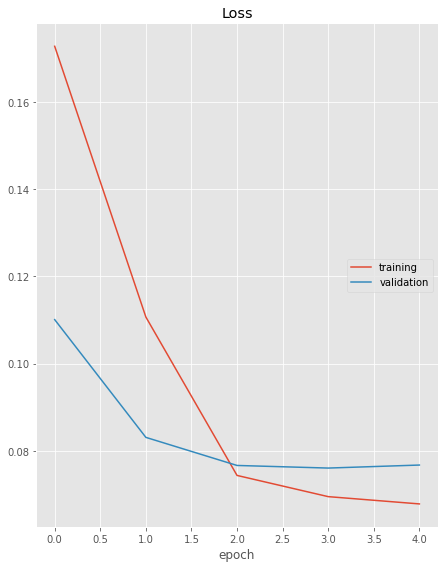

Loss
	training         	 (min:    0.068, max:    0.173, cur:    0.068)
	validation       	 (min:    0.076, max:    0.110, cur:    0.077)


 ***** EVALUATION WITHOUT SCALING ***** 


21/21 [==============================] - 3s 162ms/step - loss: 0.0767


 ***** EVALUATION WITH SCALING ***** 


21/21 [==============================] - 4s 164ms/step - loss: 3918751.5000


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
# window in and out for the supervised forecast.
n_in, n_out = 24*62, 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# define the LSTM architecture.
model = Sequential()
if len(tf.config.list_physical_devices('GPU')) == 0:
  model.add(GRU(512, input_shape=(n_in, n_features)))
else:
  model.add(CuDNNGRU(512, input_shape=(n_in, n_features)))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 5, PATIENCE = 10, BATCH_SIZE = 64)

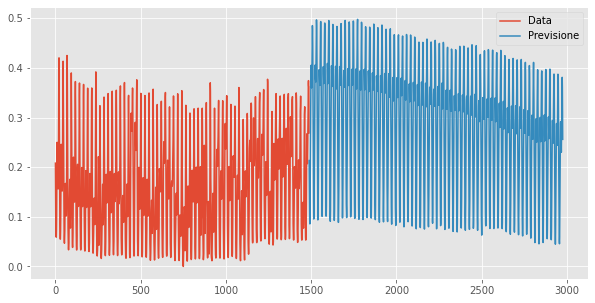

In [ ]:
forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

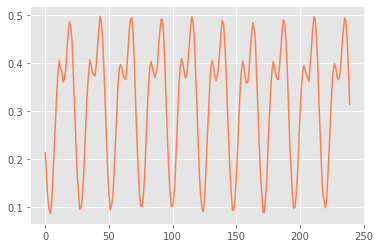

In [ ]:
plt.plot(forecasted[0][0:(24*10)], color = 'coral')

In [ ]:
table_result_GRU = table_result_GRU.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_GRU.to_csv('drive/MyDrive/TimeSeries/table_result_GRU.csv', index=False)
table_result_GRU

,Model_CODE,MAE_VAL,MAE_VAL_ORIGINAL,MAE_TRAIN,MAE_TRAIN_ORIGINAL
0,32_dropout_02,0.110673,3918751.5,0.143212,4474129.5
1,32,0.111654,3918751.5,0.142433,4474129.5
2,64_dropout_02,0.077487,3918751.5,0.081131,4474129.0
3,100_dropout_02,0.074149,3918751.5,0.074602,4474129.0
4,128_dropout_02,0.080684,3918751.5,0.092399,4474129.0
5,128,0.082782,3918751.5,0.099508,4474129.0
6,128_dropout_02_lralto,0.090588,3918752.0,0.083803,4474129.5
7,512_dropout_02,0.073788,3918751.5,0.096445,4474129.0
8,512,0.076746,3918751.5,0.091824,4474129.5


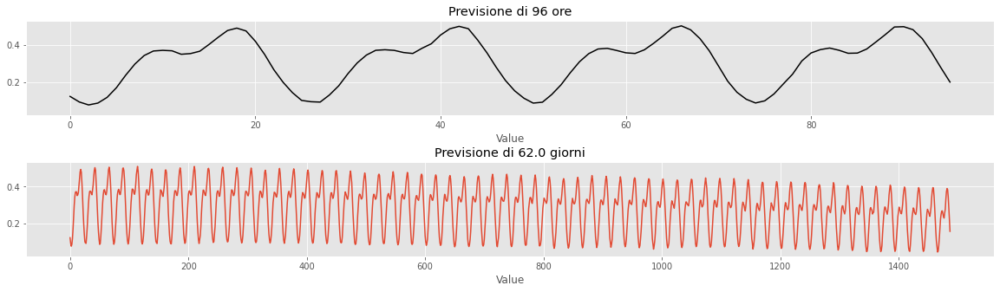

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### ***--- 2 mesi prima -> 2 mesi dopo (1000 units + dropout 0.2)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '1000_dropout_02'

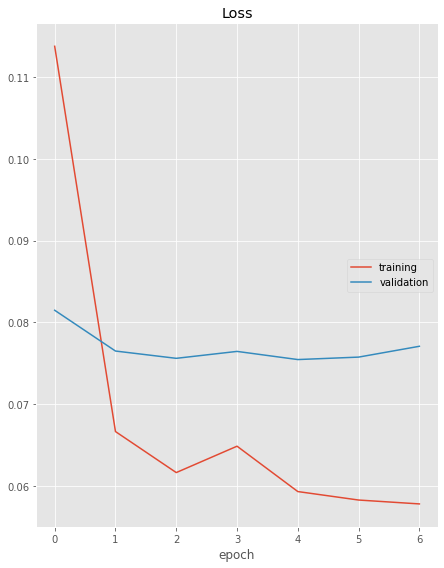

Loss
	training         	 (min:    0.058, max:    0.114, cur:      nan)
	validation       	 (min:    0.075, max:    0.081, cur:      nan)


 ***** EVALUATION WITHOUT SCALING ***** 


21/21 [==============================] - 10s 470ms/step - loss: 0.0755


 ***** EVALUATION WITH SCALING ***** 


21/21 [==============================] - 10s 456ms/step - loss: 3918751.5000


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
# window in and out for the supervised forecast.
n_in, n_out = 24*62, 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# del model 
# define the LSTM architecture.
model = Sequential()
if len(tf.config.list_physical_devices('GPU')) == 0:
  model.add(GRU(1000, input_shape=(n_in, n_features)))
else:
  model.add(CuDNNGRU(1000, input_shape=(n_in, n_features)))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5, BATCH_SIZE = 32)

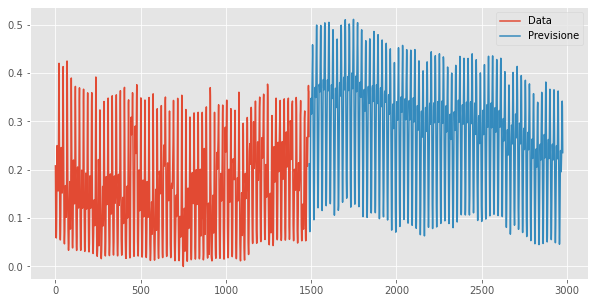

In [ ]:
forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

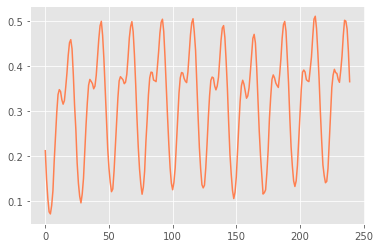

In [ ]:
plt.plot(forecasted[0][0:(24*10)], color = 'coral')

In [ ]:
table_result_GRU = table_result_GRU.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_GRU.to_csv('drive/MyDrive/TimeSeries/table_result_GRU.csv', index=False)
table_result_GRU

,Model_CODE,MAE_VAL,MAE_VAL_ORIGINAL,MAE_TRAIN,MAE_TRAIN_ORIGINAL
0,32_dropout_02,0.110673,3918751.5,0.143212,4474129.5
1,32,0.111654,3918751.5,0.142433,4474129.5
2,64_dropout_02,0.077487,3918751.5,0.081131,4474129.0
3,100_dropout_02,0.074149,3918751.5,0.074602,4474129.0
4,128_dropout_02,0.080684,3918751.5,0.092399,4474129.0
5,128,0.082782,3918751.5,0.099508,4474129.0
6,128_dropout_02_lralto,0.090588,3918752.0,0.083803,4474129.5
7,512_dropout_02,0.073788,3918751.5,0.096445,4474129.0
8,512,0.076746,3918751.5,0.091824,4474129.5
9,1000_dropout_02,0.075454,3918751.5,0.100871,4474129.0


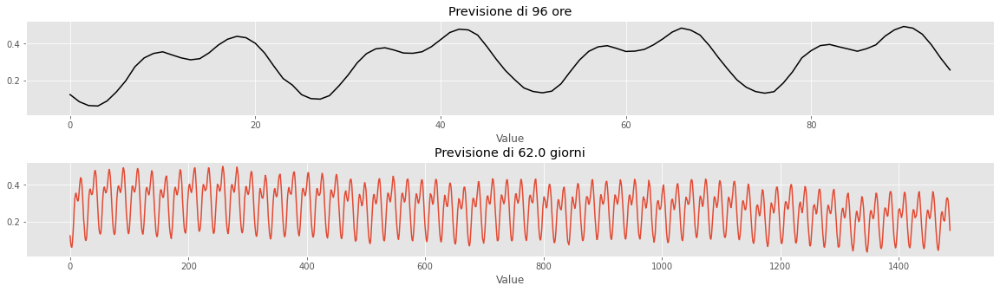

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### ***--- 2 mesi prima -> 2 mesi dopo (1000 units, no dropout)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '1000'

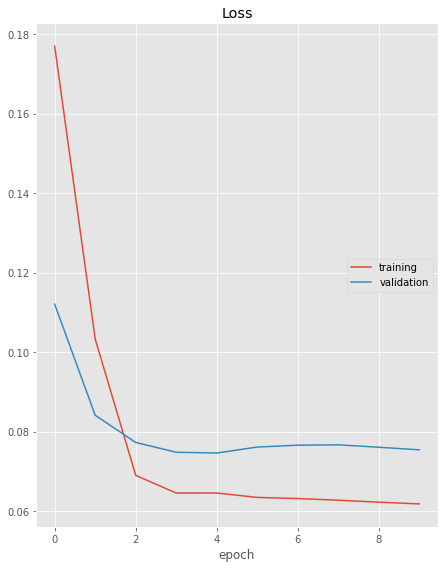

Loss
	training         	 (min:    0.062, max:    0.177, cur:    0.062)
	validation       	 (min:    0.075, max:    0.112, cur:    0.075)


 ***** EVALUATION WITHOUT SCALING ***** 


21/21 [==============================] - 10s 477ms/step - loss: 0.0746


 ***** EVALUATION WITH SCALING ***** 


21/21 [==============================] - 10s 459ms/step - loss: 3918752.0000


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
# window in and out for the supervised forecast.
n_in, n_out = 24*62, 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# define the LSTM architecture.
model = Sequential()
if len(tf.config.list_physical_devices('GPU')) == 0:
  model.add(GRU(1000, input_shape=(n_in, n_features)))
else:
  model.add(CuDNNGRU(1000, input_shape=(n_in, n_features)))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5, BATCH_SIZE = 64)

In [ ]:
forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

In [ ]:
plt.plot(forecasted[0][0:(24*10)], color = 'coral')

In [ ]:
table_result_GRU = table_result_GRU.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_GRU.to_csv('drive/MyDrive/TimeSeries/table_result_GRU.csv', index=False)
table_result_GRU

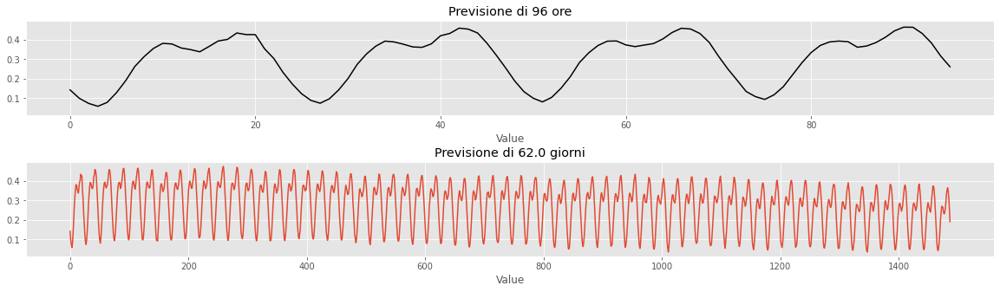

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### ***--- 2 mesi prima -> 2 mesi dopo (32 - 16 units + dropout 0.2)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '32_drop_16_drop'

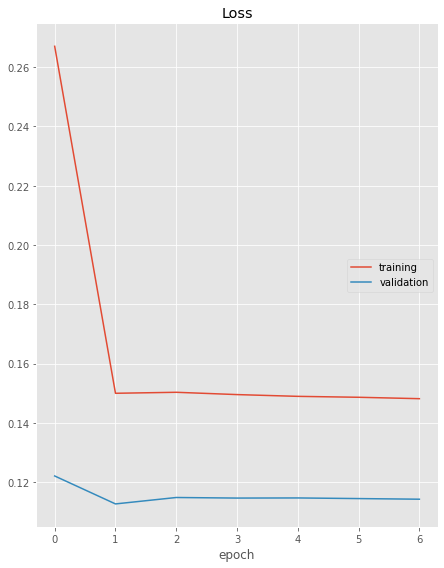

Loss
	training         	 (min:    0.148, max:    0.267, cur:    0.148)
	validation       	 (min:    0.113, max:    0.122, cur:    0.114)


 ***** EVALUATION WITHOUT SCALING ***** 


21/21 [==============================] - 4s 181ms/step - loss: 0.1126


 ***** EVALUATION WITH SCALING ***** 


21/21 [==============================] - 3s 153ms/step - loss: 3918752.0000


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
# window in and out for the supervised forecast.
n_in, n_out = 24*62, 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# del model 
# define the LSTM architecture.
model = Sequential()
if len(tf.config.list_physical_devices('GPU')) == 0:
  model.add(GRU(32, input_shape=(n_in, n_features)))
else:
  model.add(CuDNNGRU(32, input_shape=(n_in, n_features), return_sequences=True))
model.add(Dropout(0.2))
if len(tf.config.list_physical_devices('GPU')) == 0:
  model.add(GRU(16, input_shape=(n_in, n_features)))
else:
  model.add(CuDNNGRU(16, input_shape=(n_in, n_features)))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5)

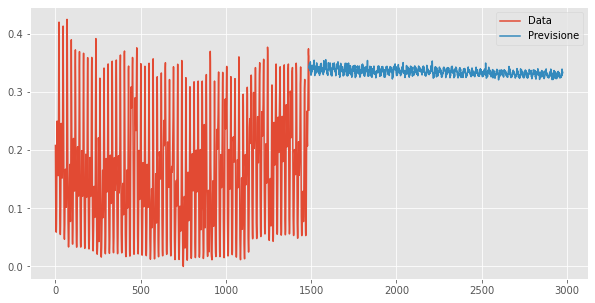

In [ ]:
forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

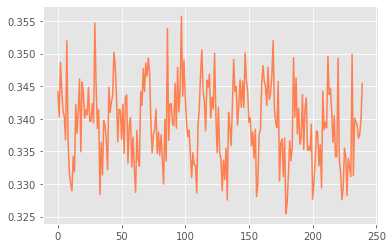

In [ ]:
plt.plot(forecasted[0][0:(24*10)], color = 'coral')

In [ ]:
table_result_GRU = table_result_GRU.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_GRU.to_csv('drive/MyDrive/TimeSeries/table_result_GRU.csv', index=False)
table_result_GRU

,Model_CODE,MAE_VAL,MAE_VAL_ORIGINAL,MAE_TRAIN,MAE_TRAIN_ORIGINAL
0,32_dropout_02,0.110673,3918751.5,0.143212,4474129.5
1,32,0.111654,3918751.5,0.142433,4474129.5
2,64_dropout_02,0.077487,3918751.5,0.081131,4474129.0
3,100_dropout_02,0.074149,3918751.5,0.074602,4474129.0
4,128_dropout_02,0.080684,3918751.5,0.092399,4474129.0
5,128,0.082782,3918751.5,0.099508,4474129.0
6,128_dropout_02_lralto,0.090588,3918752.0,0.083803,4474129.5
7,512_dropout_02,0.073788,3918751.5,0.096445,4474129.0
8,512,0.076746,3918751.5,0.091824,4474129.5
9,1000_dropout_02,0.075454,3918751.5,0.100871,4474129.0


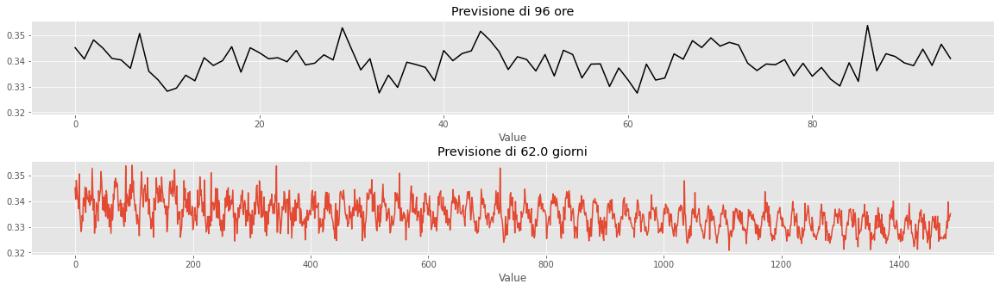

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### ***--- 2 mesi prima -> 2 mesi dopo (32 - 16 units + senza dropout)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '32_16'

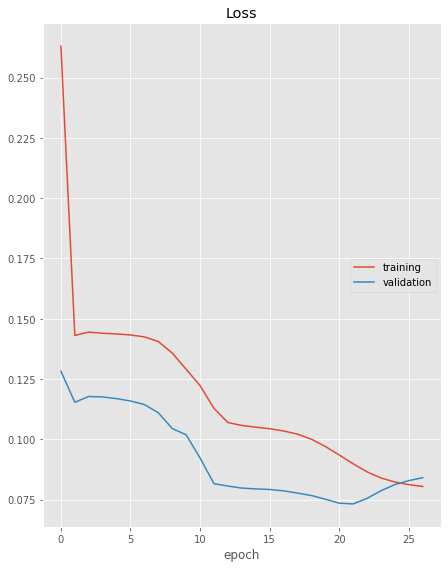

Loss
	training         	 (min:    0.080, max:    0.263, cur:    0.080)
	validation       	 (min:    0.073, max:    0.128, cur:    0.084)


 ***** EVALUATION WITHOUT SCALING ***** 


21/21 [==============================] - 3s 152ms/step - loss: 0.0732


 ***** EVALUATION WITH SCALING ***** 


21/21 [==============================] - 3s 153ms/step - loss: 3918752.0000


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
# window in and out for the supervised forecast.
n_in, n_out = 24*62, 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# del model 
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNGRU(32, input_shape=(n_in, n_features), return_sequences=True))
model.add(CuDNNGRU(16, input_shape=(n_in, n_features)))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5)

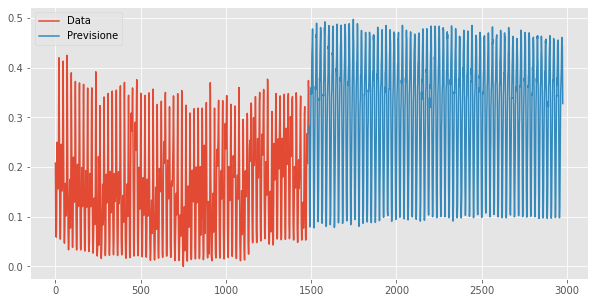

In [ ]:
forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

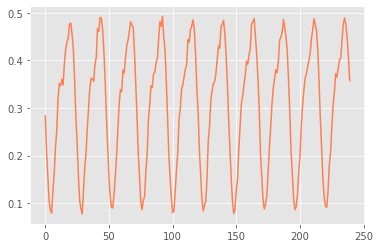

In [ ]:
plt.plot(forecasted[0][0:(24*10)], color = 'coral')

In [ ]:
table_result_GRU = table_result_GRU.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_GRU.to_csv('drive/MyDrive/TimeSeries/table_result_GRU.csv', index=False)
table_result_GRU

,Model_CODE,MAE_VAL,MAE_VAL_ORIGINAL,MAE_TRAIN,MAE_TRAIN_ORIGINAL
0,32_dropout_02,0.110673,3918751.5,0.143212,4474129.5
1,32,0.111654,3918751.5,0.142433,4474129.5
2,64_dropout_02,0.077487,3918751.5,0.081131,4474129.0
3,100_dropout_02,0.074149,3918751.5,0.074602,4474129.0
4,128_dropout_02,0.080684,3918751.5,0.092399,4474129.0
5,128,0.082782,3918751.5,0.099508,4474129.0
6,128_dropout_02_lralto,0.090588,3918752.0,0.083803,4474129.5
7,512_dropout_02,0.073788,3918751.5,0.096445,4474129.0
8,512,0.076746,3918751.5,0.091824,4474129.5
9,1000_dropout_02,0.075454,3918751.5,0.100871,4474129.0


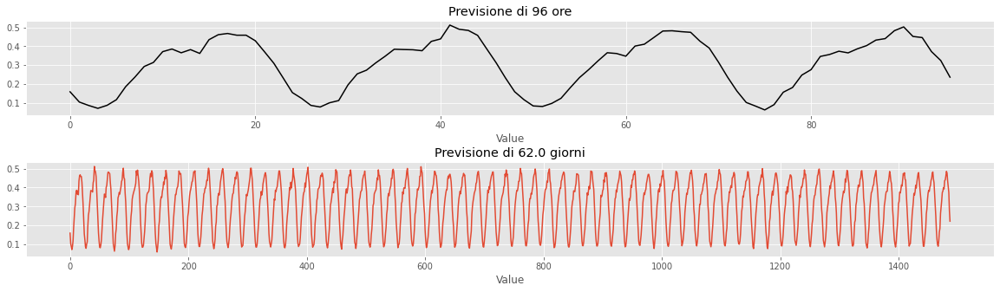

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### ***--- 2 mesi prima -> 2 mesi dopo (100 - 50 units + dropout 0.2)***

In [ ]:
# constants.
# 0.01 è troppo alto: l'errore di validation sale e basta fin dall'inizio. 
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '100_dropout_50_dropout'

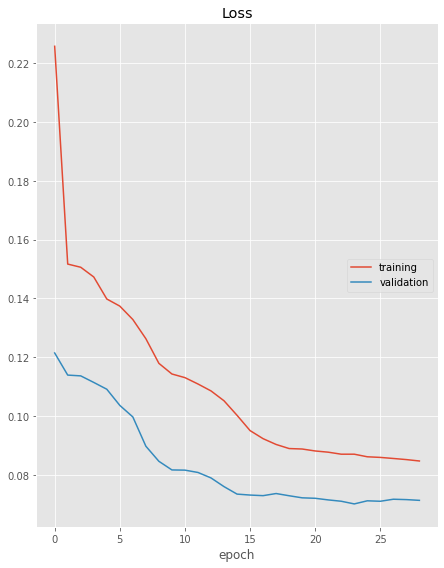

Loss
	training         	 (min:    0.085, max:    0.226, cur:    0.085)
	validation       	 (min:    0.070, max:    0.121, cur:    0.071)


 ***** EVALUATION WITHOUT SCALING ***** 


21/21 [==============================] - 4s 174ms/step - loss: 0.0702


 ***** EVALUATION WITH SCALING ***** 


21/21 [==============================] - 4s 181ms/step - loss: 3918752.0000


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
# window in and out for the supervised forecast.
n_in, n_out = 24*62, 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n") 
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNGRU(100, input_shape=(n_in, n_features), return_sequences=True))
model.add(Dropout(0.2))
model.add(CuDNNGRU(50))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5)

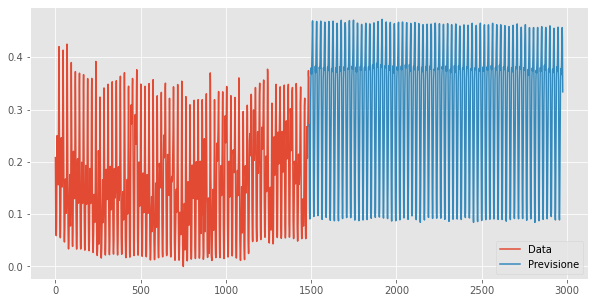

In [ ]:
forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

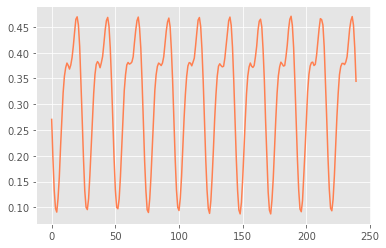

In [ ]:
plt.plot(forecasted[0][0:(24*10)], color = 'coral')

In [ ]:
table_result_GRU = table_result_GRU.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_GRU.to_csv('drive/MyDrive/TimeSeries/table_result_GRU.csv', index=False)
table_result_GRU

,Model_CODE,MAE_VAL,MAE_VAL_ORIGINAL,MAE_TRAIN,MAE_TRAIN_ORIGINAL
0,32_dropout_02,0.110673,3918751.5,0.143212,4474129.5
1,32,0.111654,3918751.5,0.142433,4474129.5
2,64_dropout_02,0.077487,3918751.5,0.081131,4474129.0
3,100_dropout_02,0.074149,3918751.5,0.074602,4474129.0
4,128_dropout_02,0.080684,3918751.5,0.092399,4474129.0
5,128,0.082782,3918751.5,0.099508,4474129.0
6,128_dropout_02_lralto,0.090588,3918752.0,0.083803,4474129.5
7,512_dropout_02,0.073788,3918751.5,0.096445,4474129.0
8,512,0.076746,3918751.5,0.091824,4474129.5
9,1000_dropout_02,0.075454,3918751.5,0.100871,4474129.0


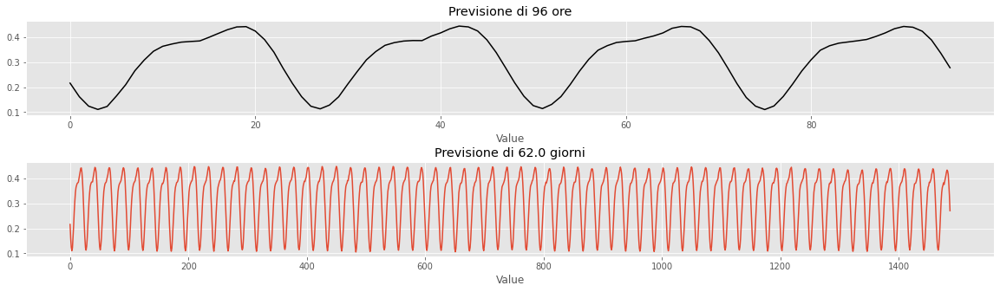

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### ***--- 2 mesi prima -> 2 mesi dopo (200 - 100 units + dropout 0.2)***

In [ ]:
# constants.
# 0.01 è troppo alto: l'errore di validation sale e basta fin dall'inizio. 
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '200_drop_100_drop'

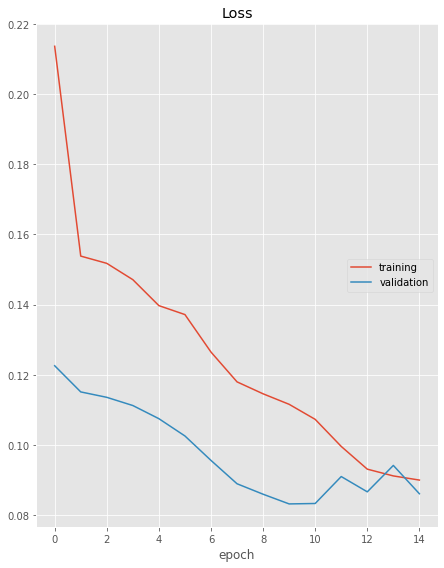

Loss
	training         	 (min:    0.090, max:    0.214, cur:    0.090)
	validation       	 (min:    0.083, max:    0.123, cur:    0.086)


 ***** EVALUATION WITHOUT SCALING ***** 


21/21 [==============================] - 5s 227ms/step - loss: 0.0832


 ***** EVALUATION WITH SCALING ***** 


21/21 [==============================] - 3s 155ms/step - loss: 3918751.5000


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
# window in and out for the supervised forecast.
n_in, n_out = 24*62, 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n") 
del model 
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNGRU(200, input_shape=(n_in, n_features), return_sequences=True))
model.add(Dropout(0.2))
model.add(CuDNNGRU(100))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5)

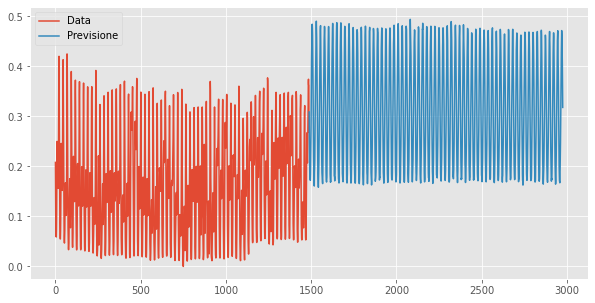

In [ ]:
forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

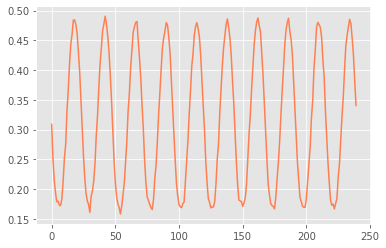

In [ ]:
plt.plot(forecasted[0][0:(24*10)], color = 'coral')

In [ ]:
table_result_GRU = table_result_GRU.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_GRU.to_csv('drive/MyDrive/TimeSeries/table_result_GRU.csv', index=False)
table_result_GRU

,Model_CODE,MAE_VAL,MAE_VAL_ORIGINAL,MAE_TRAIN,MAE_TRAIN_ORIGINAL
0,32_dropout_02,0.110673,3918751.5,0.143212,4474129.5
1,32,0.111654,3918751.5,0.142433,4474129.5
2,64_dropout_02,0.077487,3918751.5,0.081131,4474129.0
3,100_dropout_02,0.074149,3918751.5,0.074602,4474129.0
4,128_dropout_02,0.080684,3918751.5,0.092399,4474129.0
5,128,0.082782,3918751.5,0.099508,4474129.0
6,128_dropout_02_lralto,0.090588,3918752.0,0.083803,4474129.5
7,512_dropout_02,0.073788,3918751.5,0.096445,4474129.0
8,512,0.076746,3918751.5,0.091824,4474129.5
9,1000_dropout_02,0.075454,3918751.5,0.100871,4474129.0


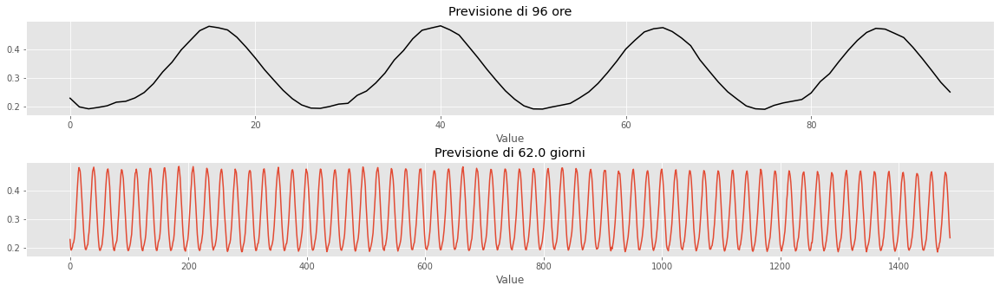

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### **** 2 mesi e 2 settimane prima -> 2 mesi dopo (128 + dropout 0.2)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '2_mesi_2_sett_1'

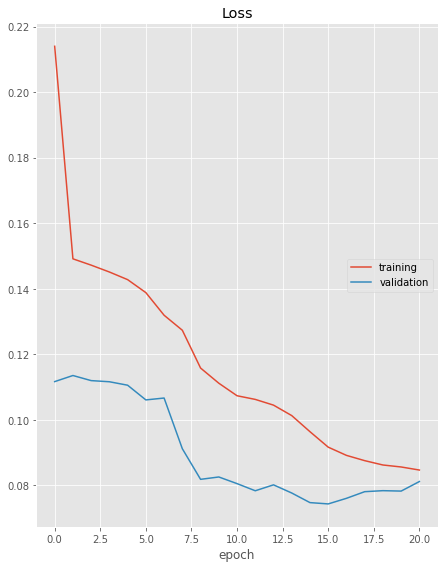

Loss
	training         	 (min:    0.085, max:    0.214, cur:    0.085)
	validation       	 (min:    0.074, max:    0.114, cur:    0.081)


 ***** EVALUATION WITHOUT SCALING ***** 


11/11 [==============================] - 2s 170ms/step - loss: 0.0743


 ***** EVALUATION WITH SCALING ***** 


11/11 [==============================] - 1s 118ms/step - loss: 3951273.7500


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
n_in, n_out = 24*(30+30+15), 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNGRU(128, input_shape=(n_in, n_features)))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))

model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5)

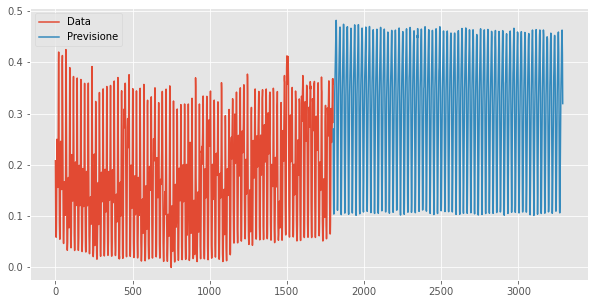

In [ ]:
forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

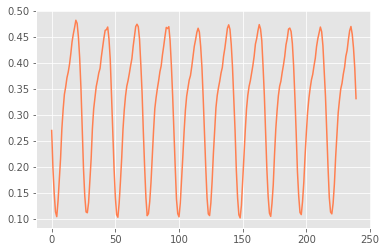

In [ ]:
plt.plot(forecasted[0][0:(24*10)], color = 'coral')

In [ ]:
table_result_GRU = table_result_GRU.append({'Model_CODE':MODEL_CODE, 'MAE_VAL':result[0], 'MAE_VAL_ORIGINAL':result[1]}, ignore_index=True)
table_result_GRU

In [ ]:
table_result_GRU = table_result_GRU.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_GRU.to_csv('drive/MyDrive/TimeSeries/table_result_GRU.csv', index=False)
table_result_GRU

,Model_CODE,MAE_VAL,MAE_VAL_ORIGINAL,MAE_TRAIN,MAE_TRAIN_ORIGINAL
0,32_dropout_02,0.110673,3918751.50,0.143212,4474129.5
1,32,0.111654,3918751.50,0.142433,4474129.5
2,64_dropout_02,0.077487,3918751.50,0.081131,4474129.0
3,100_dropout_02,0.074149,3918751.50,0.074602,4474129.0
4,128_dropout_02,0.080684,3918751.50,0.092399,4474129.0
5,128,0.082782,3918751.50,0.099508,4474129.0
6,128_dropout_02_lralto,0.090588,3918752.00,0.083803,4474129.5
7,512_dropout_02,0.073788,3918751.50,0.096445,4474129.0
8,512,0.076746,3918751.50,0.091824,4474129.5
9,1000_dropout_02,0.075454,3918751.50,0.100871,4474129.0


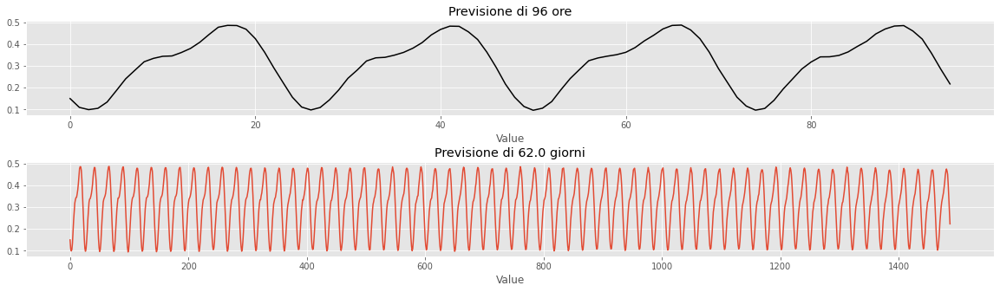

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### **** 2 mesi e 2 settimane prima -> 2 mesi dopo (128, senza dropout)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '2_mesi_2_sett_2'

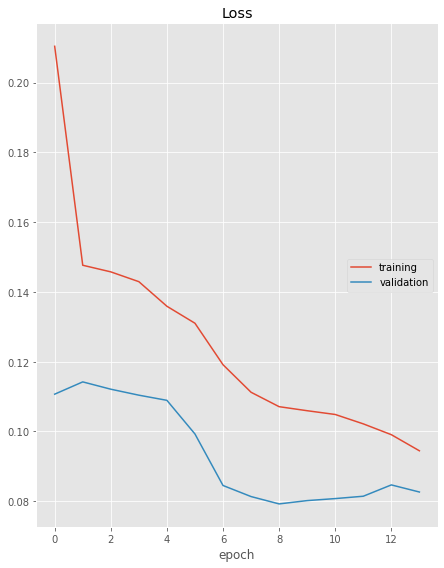

Loss
	training         	 (min:    0.094, max:    0.210, cur:    0.094)
	validation       	 (min:    0.079, max:    0.114, cur:    0.083)


 ***** EVALUATION WITHOUT SCALING ***** 


11/11 [==============================] - 1s 117ms/step - loss: 0.0792


 ***** EVALUATION WITH SCALING ***** 


11/11 [==============================] - 1s 116ms/step - loss: 3951273.7500


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
n_in, n_out = 24*(30+30+15), 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNGRU(128, input_shape=(n_in, n_features)))
model.add(Dense(trainY.shape[1]))

model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5)

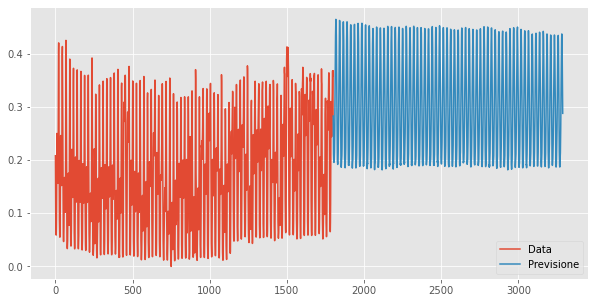

In [ ]:
forecasted = plot_one_window(model, valX, n_in, n_out, return_f = True)

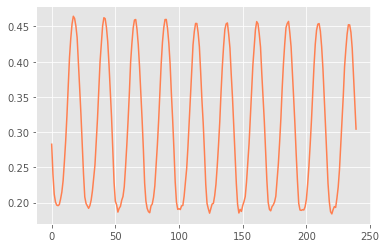

In [ ]:
plt.plot(forecasted[0][0:(24*10)], color = 'coral')

In [ ]:
table_result_GRU = table_result_GRU.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_GRU.to_csv('drive/MyDrive/TimeSeries/table_result_GRU.csv', index=False)
table_result_GRU

,Model_CODE,MAE_VAL,MAE_VAL_ORIGINAL,MAE_TRAIN,MAE_TRAIN_ORIGINAL
0,32_dropout_02,0.110673,3918751.50,0.143212,4474129.5
1,32,0.111654,3918751.50,0.142433,4474129.5
2,64_dropout_02,0.077487,3918751.50,0.081131,4474129.0
3,100_dropout_02,0.074149,3918751.50,0.074602,4474129.0
4,128_dropout_02,0.080684,3918751.50,0.092399,4474129.0
5,128,0.082782,3918751.50,0.099508,4474129.0
6,128_dropout_02_lralto,0.090588,3918752.00,0.083803,4474129.5
7,512_dropout_02,0.073788,3918751.50,0.096445,4474129.0
8,512,0.076746,3918751.50,0.091824,4474129.5
9,1000_dropout_02,0.075454,3918751.50,0.100871,4474129.0


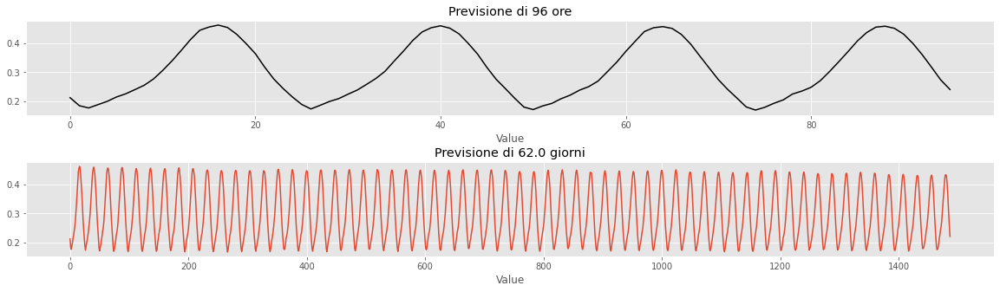

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### *****1 mese -> 2 mesi dopo (512 + dropout 0.2)***



In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '1_mese_1'

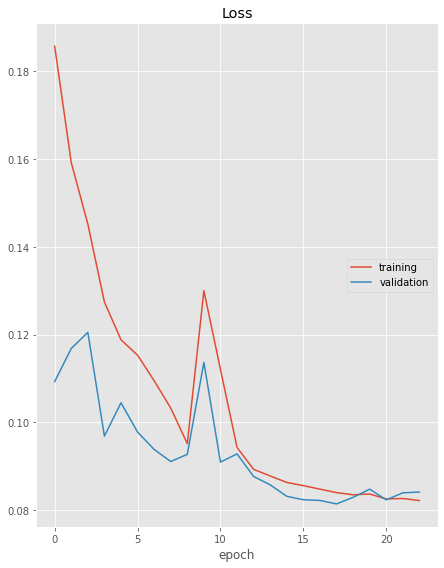

Loss
	training         	 (min:    0.082, max:    0.186, cur:    0.082)
	validation       	 (min:    0.081, max:    0.121, cur:    0.084)


 ***** EVALUATION WITHOUT SCALING ***** 


45/45 [==============================] - 4s 90ms/step - loss: 0.0814


 ***** EVALUATION WITH SCALING ***** 


45/45 [==============================] - 4s 81ms/step - loss: 3722806.2500


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
n_in, n_out = 24*(30), 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNGRU(512, input_shape=(n_in, n_features)))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))

model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5)

In [ ]:
table_result_GRU = table_result_GRU.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_GRU.to_csv('drive/MyDrive/TimeSeries/table_result_GRU.csv', index=False)
table_result_GRU

,Model_CODE,MAE_VAL,MAE_VAL_ORIGINAL,MAE_TRAIN,MAE_TRAIN_ORIGINAL
0,32_dropout_02,0.110673,3918751.50,0.143212,4474129.5
1,32,0.111654,3918751.50,0.142433,4474129.5
2,64_dropout_02,0.077487,3918751.50,0.081131,4474129.0
3,100_dropout_02,0.074149,3918751.50,0.074602,4474129.0
4,128_dropout_02,0.080684,3918751.50,0.092399,4474129.0
5,128,0.082782,3918751.50,0.099508,4474129.0
6,128_dropout_02_lralto,0.090588,3918752.00,0.083803,4474129.5
7,512_dropout_02,0.073788,3918751.50,0.096445,4474129.0
8,512,0.076746,3918751.50,0.091824,4474129.5
9,1000_dropout_02,0.075454,3918751.50,0.100871,4474129.0


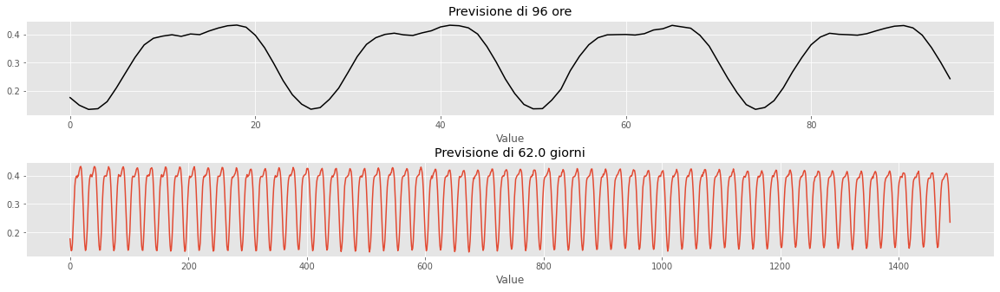

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### *****1 mese -> 2 mesi dopo (1000)***



In [ ]:
# constants.
"""
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '1_mese_1'

print("\n\n ***** DATA PREPARATION ***** \n\n")
n_in, n_out = 24*(30), 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(1000, input_shape=(n_in, n_features)))
model.add(Dense(trainY.shape[1]))

model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 10)
"""

#### ***--2 settimane -> 2 mesi dopo (1000 + dropout 0.2)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '2_sett_1'

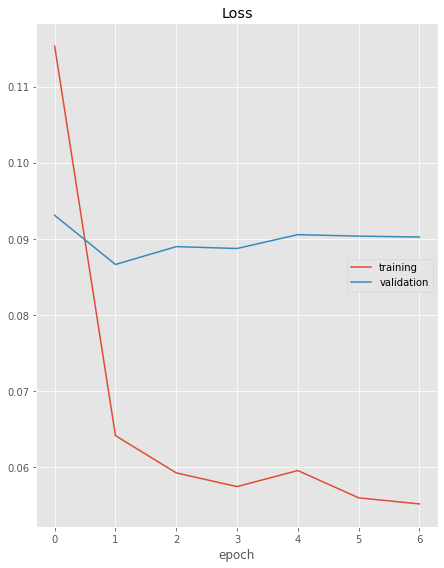

Loss
	training         	 (min:    0.055, max:    0.115, cur:    0.055)
	validation       	 (min:    0.087, max:    0.093, cur:    0.090)


 ***** EVALUATION WITHOUT SCALING ***** 


56/56 [==============================] - 6s 115ms/step - loss: 0.0866


 ***** EVALUATION WITH SCALING ***** 


56/56 [==============================] - 6s 114ms/step - loss: 3604482.5000


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
n_in, n_out = 24*(15), 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNGRU(1000, input_shape=(n_in, n_features)))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))

model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5, BATCH_SIZE = 32)

In [ ]:
table_result_GRU = table_result_GRU.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_GRU.to_csv('drive/MyDrive/TimeSeries/table_result_GRU.csv', index=False)
table_result_GRU

,Model_CODE,MAE_VAL,MAE_VAL_ORIGINAL,MAE_TRAIN,MAE_TRAIN_ORIGINAL
0,32_dropout_02,0.110673,3918751.50,0.143212,4474129.5
1,32,0.111654,3918751.50,0.142433,4474129.5
2,64_dropout_02,0.077487,3918751.50,0.081131,4474129.0
3,100_dropout_02,0.074149,3918751.50,0.074602,4474129.0
4,128_dropout_02,0.080684,3918751.50,0.092399,4474129.0
5,128,0.082782,3918751.50,0.099508,4474129.0
6,128_dropout_02_lralto,0.090588,3918752.00,0.083803,4474129.5
7,512_dropout_02,0.073788,3918751.50,0.096445,4474129.0
8,512,0.076746,3918751.50,0.091824,4474129.5
9,1000_dropout_02,0.075454,3918751.50,0.100871,4474129.0


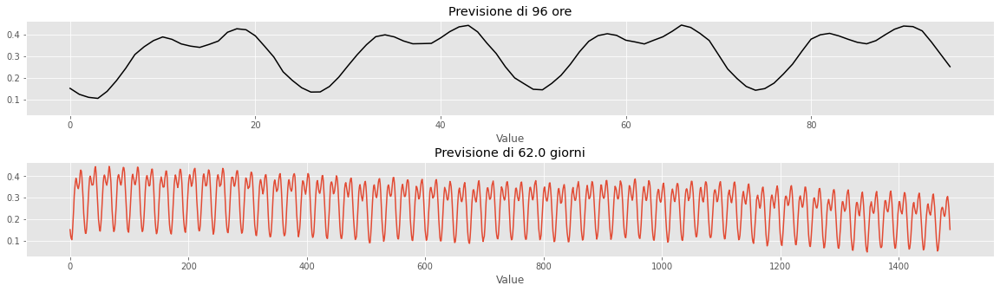

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### ***--2 settimane -> 2 mesi dopo (1000, senza dropout)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '2_sett_2'

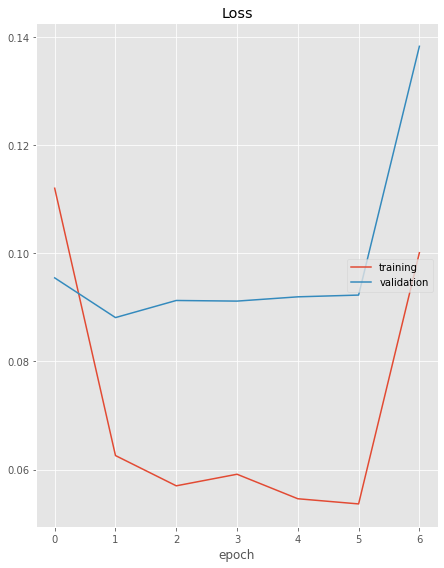

Loss
	training         	 (min:    0.054, max:    0.112, cur:    0.100)
	validation       	 (min:    0.088, max:    0.138, cur:    0.138)


 ***** EVALUATION WITHOUT SCALING ***** 


56/56 [==============================] - 7s 117ms/step - loss: 0.0881


 ***** EVALUATION WITH SCALING ***** 


56/56 [==============================] - 6s 112ms/step - loss: 3604482.5000


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
n_in, n_out = 24*(15), 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNGRU(1000, input_shape=(n_in, n_features)))
model.add(Dense(trainY.shape[1]))

model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5, BATCH_SIZE = 32)

In [ ]:
table_result_GRU = table_result_GRU.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_GRU.to_csv('drive/MyDrive/TimeSeries/table_result_GRU.csv', index=False)
table_result_GRU

,Model_CODE,MAE_VAL,MAE_VAL_ORIGINAL,MAE_TRAIN,MAE_TRAIN_ORIGINAL
0,32_dropout_02,0.110673,3918751.50,0.143212,4474129.5
1,32,0.111654,3918751.50,0.142433,4474129.5
2,64_dropout_02,0.077487,3918751.50,0.081131,4474129.0
3,100_dropout_02,0.074149,3918751.50,0.074602,4474129.0
4,128_dropout_02,0.080684,3918751.50,0.092399,4474129.0
5,128,0.082782,3918751.50,0.099508,4474129.0
6,128_dropout_02_lralto,0.090588,3918752.00,0.083803,4474129.5
7,512_dropout_02,0.073788,3918751.50,0.096445,4474129.0
8,512,0.076746,3918751.50,0.091824,4474129.5
9,1000_dropout_02,0.075454,3918751.50,0.100871,4474129.0


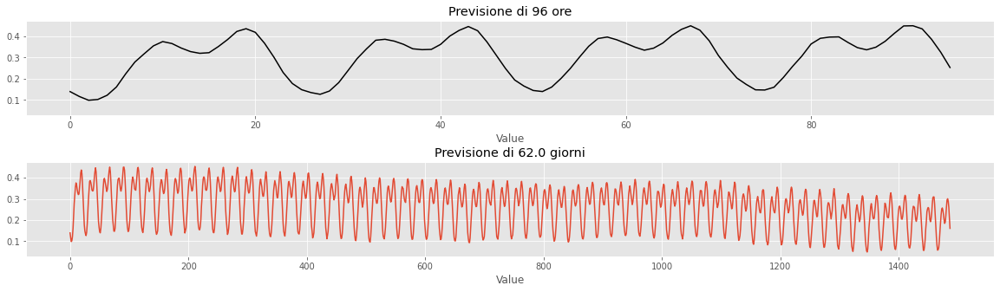

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### ***--2 settimane -> 2 mesi dopo (2000, senza dropout)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '2_sett_3'

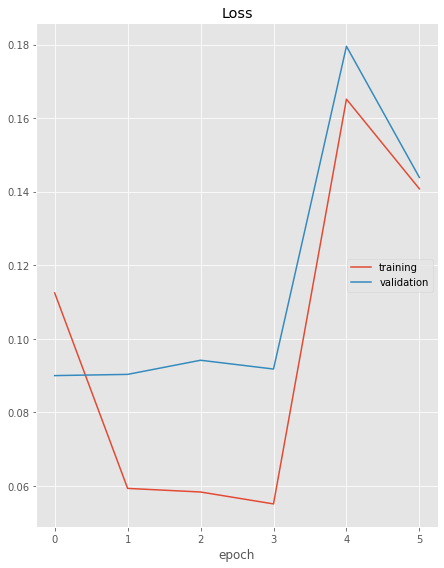

Loss
	training         	 (min:    0.055, max:    0.165, cur:    0.141)
	validation       	 (min:    0.090, max:    0.180, cur:    0.144)


 ***** EVALUATION WITHOUT SCALING ***** 


56/56 [==============================] - 22s 395ms/step - loss: 0.0900


 ***** EVALUATION WITH SCALING ***** 


56/56 [==============================] - 21s 374ms/step - loss: 3604482.2500


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
n_in, n_out = 24*(15), 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNGRU(2000, input_shape=(n_in, n_features)))
model.add(Dense(trainY.shape[1]))

model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5, BATCH_SIZE = 32)

In [ ]:
table_result_GRU = table_result_GRU.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_GRU.to_csv('drive/MyDrive/TimeSeries/table_result_GRU.csv', index=False)
table_result_GRU

,Model_CODE,MAE_VAL,MAE_VAL_ORIGINAL,MAE_TRAIN,MAE_TRAIN_ORIGINAL
0,32_dropout_02,0.110673,3918751.50,0.143212,4474129.5
1,32,0.111654,3918751.50,0.142433,4474129.5
2,64_dropout_02,0.077487,3918751.50,0.081131,4474129.0
3,100_dropout_02,0.074149,3918751.50,0.074602,4474129.0
4,128_dropout_02,0.080684,3918751.50,0.092399,4474129.0
5,128,0.082782,3918751.50,0.099508,4474129.0
6,128_dropout_02_lralto,0.090588,3918752.00,0.083803,4474129.5
7,512_dropout_02,0.073788,3918751.50,0.096445,4474129.0
8,512,0.076746,3918751.50,0.091824,4474129.5
9,1000_dropout_02,0.075454,3918751.50,0.100871,4474129.0


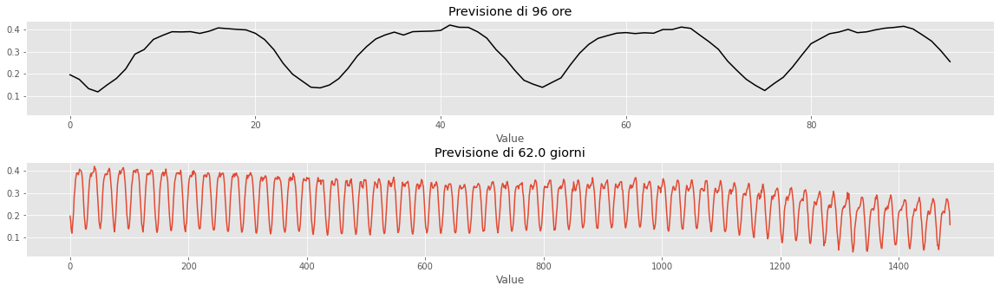

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

#### ***--2 settimane -> 2 mesi dopo (2000 + dropout 0.2)***

In [ ]:
# constants.
LR = 0.001
CLIPVALUE = 0.5
MODEL_CODE = '2_sett_4'

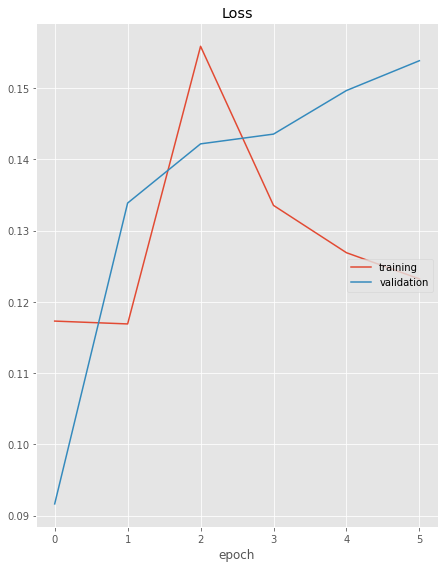

Loss
	training         	 (min:    0.117, max:    0.156, cur:    0.123)
	validation       	 (min:    0.092, max:    0.154, cur:    0.154)


 ***** EVALUATION WITHOUT SCALING ***** 


56/56 [==============================] - 22s 396ms/step - loss: 0.0916


 ***** EVALUATION WITH SCALING ***** 


56/56 [==============================] - 21s 373ms/step - loss: 3604482.2500


In [ ]:
print("\n\n ***** DATA PREPARATION ***** \n\n")
n_in, n_out = 24*(15), 24*62
trainX, trainY, valX, valY = prepare_data(train.StandardValue.values, 
                                          val.StandardValue.values, 
                                          n_in, 
                                          n_out
                                          )

print("\n\n ***** MODELING ***** \n\n")
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNGRU(2000, input_shape=(n_in, n_features)))
model.add(Dropout(0.2))
model.add(Dense(trainY.shape[1]))

model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')
# fit and plot errors. 
result = fit_and_plot_model(model, 
                            trainX, trainY, 
                            valX, valY, 
                            MODEL_CODE, EPOCHS = 100, PATIENCE = 5, BATCH_SIZE = 32)

In [ ]:
table_result_GRU = table_result_GRU.append({'Model_CODE': MODEL_CODE, 'MAE_TRAIN': result[0], 'MAE_VAL': result[1], 'MAE_TRAIN_ORIGINAL':result[2], 'MAE_VAL_ORIGINAL':result[3]}, ignore_index=True)
table_result_GRU.to_csv('drive/MyDrive/TimeSeries/table_result_GRU.csv', index=False)
table_result_GRU

,Model_CODE,MAE_VAL,MAE_VAL_ORIGINAL,MAE_TRAIN,MAE_TRAIN_ORIGINAL
0,32_dropout_02,0.110673,3918751.50,0.143212,4474129.5
1,32,0.111654,3918751.50,0.142433,4474129.5
2,64_dropout_02,0.077487,3918751.50,0.081131,4474129.0
3,100_dropout_02,0.074149,3918751.50,0.074602,4474129.0
4,128_dropout_02,0.080684,3918751.50,0.092399,4474129.0
5,128,0.082782,3918751.50,0.099508,4474129.0
6,128_dropout_02_lralto,0.090588,3918752.00,0.083803,4474129.5
7,512_dropout_02,0.073788,3918751.50,0.096445,4474129.0
8,512,0.076746,3918751.50,0.091824,4474129.5
9,1000_dropout_02,0.075454,3918751.50,0.100871,4474129.0


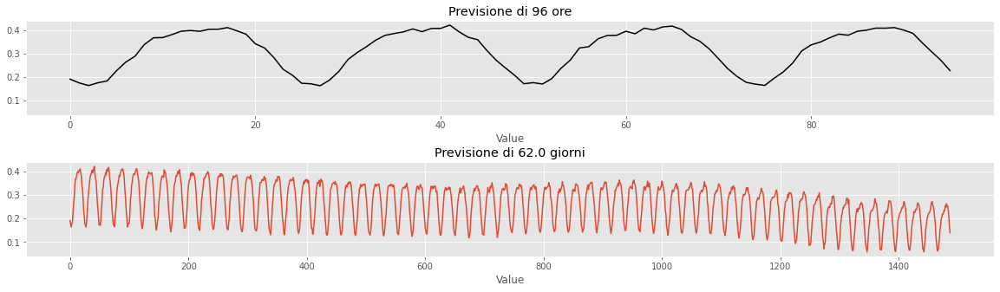

In [ ]:
plot_test_predictions(model, val, n_in, n_out)

# ***MIGLIOR MODELLO***

In [ ]:
LSTM_final = pd.read_csv('drive/MyDrive/TimeSeries/table_result_LSTM.csv')
LSTM_final = LSTM_final.iloc[:,1:]
LSTM_final['type'] = np.repeat('LSTM', LSTM_final.shape[0])
LSTM_final

,Model_CODE,MAE_TRAIN,MAE_TRAIN_ORIGINAL,MAE_VAL,MAE_VAL_ORIGINAL,type
0,32_dropout_02,0.146076,4474130.0,0.112961,3918752.25,LSTM
1,32,0.082289,4474129.5,0.075181,3918752.00,LSTM
2,64_dropout_02,0.081683,4474129.5,0.074138,3918751.50,LSTM
3,100_dropout_02,0.080273,4474129.5,0.078601,3918752.00,LSTM
4,128_dropout_02,0.078364,4474129.0,0.081457,3918751.50,LSTM
5,128,0.144036,4474129.5,0.122763,3918752.00,LSTM
6,128_dropout_02_lrbasso,0.348903,4474130.0,0.277452,3918752.25,LSTM
7,128_dropout_02_lralto,0.078192,4474129.5,0.084853,3918752.00,LSTM
8,512_dropout_02,0.099414,4474129.5,0.075203,3918752.00,LSTM
9,512,0.096364,4474129.5,0.077260,3918752.00,LSTM


In [ ]:
GRU_final = pd.read_csv('drive/MyDrive/TimeSeries/table_result_GRU.csv')
GRU_final['type'] = np.repeat('GRU', GRU_final.shape[0])
GRU_final

,Model_CODE,MAE_VAL,MAE_VAL_ORIGINAL,MAE_TRAIN,MAE_TRAIN_ORIGINAL,type
0,32_dropout_02,0.110673,3918751.50,0.143212,4474129.5,GRU
1,32,0.111654,3918751.50,0.142433,4474129.5,GRU
2,64_dropout_02,0.077487,3918751.50,0.081131,4474129.0,GRU
3,100_dropout_02,0.074149,3918751.50,0.074602,4474129.0,GRU
4,128_dropout_02,0.080684,3918751.50,0.092399,4474129.0,GRU
5,128,0.082782,3918751.50,0.099508,4474129.0,GRU
6,128_dropout_02_lralto,0.090588,3918752.00,0.083803,4474129.5,GRU
7,512_dropout_02,0.073788,3918751.50,0.096445,4474129.0,GRU
8,512,0.076746,3918751.50,0.091824,4474129.5,GRU
9,1000_dropout_02,0.075454,3918751.50,0.100871,4474129.0,GRU


In [ ]:
final_result = pd.concat([GRU_final, LSTM_final], axis = 0)
final_result_sort = final_result.sort_values(by = ['MAE_VAL'])
final_result_sort

,Model_CODE,MAE_VAL,MAE_VAL_ORIGINAL,MAE_TRAIN,MAE_TRAIN_ORIGINAL,type
13,100_dropout_50_dropout,0.070160,3918752.00,0.073911,4474129.5,GRU
16,2_mesi_2_sett_1,0.072857,3951273.75,0.076262,4456705.0,LSTM
12,32_16,0.073238,3918752.00,0.082764,4474130.0,GRU
7,512_dropout_02,0.073788,3918751.50,0.096445,4474129.0,GRU
2,64_dropout_02,0.074138,3918751.50,0.081683,4474129.5,LSTM
3,100_dropout_02,0.074149,3918751.50,0.074602,4474129.0,GRU
15,2_mesi_2_sett_1,0.074323,3951273.75,0.075006,4456704.5,GRU
10,1000,0.074601,3918752.00,0.099865,4474129.5,GRU
1,32,0.075181,3918752.00,0.082289,4474129.5,LSTM
8,512_dropout_02,0.075203,3918752.00,0.099414,4474129.5,LSTM


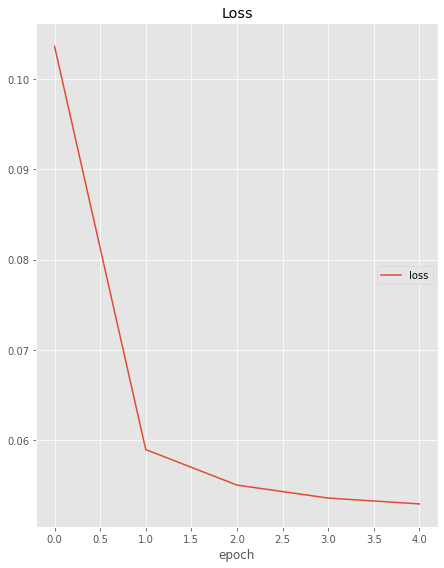

Loss
	loss             	 (min:    0.053, max:    0.104, cur:    0.053)


In [ ]:


#------------- FINAL MODEL: PREDICTION 2 MONTHS AHEAD

print("\n\n ***** DATA PREPARATION ***** \n\n")
n_in, n_out = 24*(15), 24*61

# supervised approch.
dataX, dataY = split_sequence(data.StandardValue.values, n_in, n_out)
dataX = dataX.reshape((dataX.shape[0], dataX.shape[1], n_features))

print("\n\n ***** MODELING ***** \n\n")
# define the LSTM architecture.
model = Sequential()
model.add(CuDNNLSTM(2000, input_shape=(n_in, n_features)))
model.add(Dropout(0.2))
model.add(Dense(dataY.shape[1]))

LR = 0.001
CLIPVALUE = 0.5
model.compile(optimizer = Adam(learning_rate=LR, clipvalue=CLIPVALUE), loss = 'mae')

# fit model.
EPOCHS = 5
BATCH_SIZE = 32
LOGDIR = "drive/MyDrive/TimeSeries/logs/scalars/" + datetime.now().strftime("%Y%m%d-%H%M%S")

# definisco le callbacks.
callback = [
              PlotLossesKeras(),
              TensorBoard(log_dir=LOGDIR)
             ]
# addestro e valido il modelli. 
history = model.fit(dataX, dataY, 
                    epochs = EPOCHS,
                    batch_size = BATCH_SIZE, 
                    verbose = 1,
                    shuffle = False, # è una serie storica! L'ordine è fondamentale. 
                    callbacks=[callback]
                    )

  
X_test = np.expand_dims(data.StandardValue.values[-n_in:].reshape(-1,1), axis = 0)
yhat = model.predict(X_test)
yhat = np.squeeze(yhat)
yhat = np.squeeze(scaler.inverse_transform(yhat.reshape(1, -1)))

Text(0, 0.5, 'Prediction')

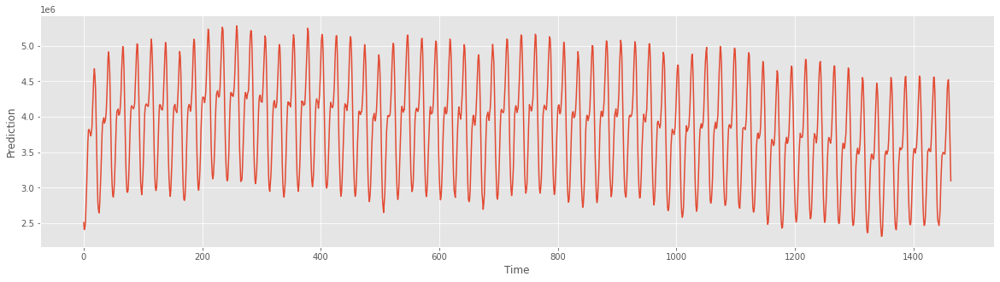

In [ ]:
plt.figure(figsize=(20,5))
plt.plot(yhat)
plt.xlabel('Time')
plt.ylabel('Prediction')

In [ ]:
yhat = pd.DataFrame(yhat)
yhat.columns = ['ML']

In [ ]:
yhat.to_csv('drive/MyDrive/TimeSeries/neural_network_prediction.csv')

In [ ]:
%tensorboard --logdir drive/MyDrive/TimeSeries/logs

Output hidden; open in https://colab.research.google.com to view.

In [2]:
yhat = pd.read_csv('drive/MyDrive/TimeSeries/neural_network_prediction.csv')

NameError: ignored